# Failure Localization In Optical Networks
In this problem we want to localize the soft failures in an Optical network. Then network is based on 4 nodes that are contecting in order (3 links int total). At each node there is a monitor that reports the OSNR samples. Our goal is to utilize this OSNR values, extract features and try to use a Machine learning to classify the fault location.

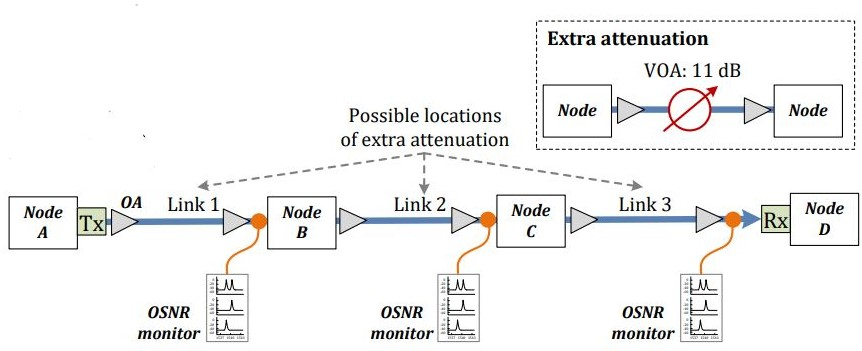

## 1. Data Preprocessing and Visualization
Our dataset consists of 9 files that each of them presents the monitoring data that was collected during each scenario.


In [69]:
# Importing required libraries
import time
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import kurtosis, skew
from sklearn.preprocessing import StandardScaler
from numba import jit
from sklearn.model_selection import StratifiedKFold, GridSearchCV
import xgboost as xgb
from sklearn.metrics import mean_squared_error, precision_score, recall_score, f1_score, confusion_matrix
from sklearn.preprocessing import LabelEncoder
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score
from sklearn.model_selection import train_test_split

### 1.1 Reading the Dataset and Standardizing
In this section we try to read the dataset from different files and aggeragate them into one single pandas dataframe. During the reading we also try to standardize values for each link so we remove the bias, therefore making a more robust model that can do the prediction on different links, with different characteristics.

In [2]:
# Nodes: A -> B -> C -> D
links = ["1", "2", "3"]
nodes = ["B", "C", "D"]
scaler = StandardScaler()

# We only need two columns from the monitors
columns_to_read = [" DATE  ", "OSNR[dB] "]

# We are aggregating all of the datas into one dataset for both std and normal data
aggr_df = pd.DataFrame()
std_aggr_df = pd.DataFrame()

for link in links:
  for node in nodes:
    file_name = f"Fault_at_link_{link}_Monitor_at_node_{node}.dat"
    # First 5 rows are not data
    df = pd.read_csv(file_name, skiprows=5, usecols=columns_to_read)

    # Column names had whitespace
    df.rename(columns={" DATE  ": "time", "OSNR[dB] ": "OSNR"}, inplace=True)

    # Fixing the correct format for the time
    df['time'] = pd.to_datetime(df['time'], format='%Y/%m/%d %H:%M:%S %f')

    # Adding the localization data
    df["link"] = link
    df["node"] = node

    print(f"Total {df.shape[0]} rows has been extracted for Node: {node}, failure at link: {link}")

    # Setting OSNR as numerical
    df['OSNR'] = pd.to_numeric(df['OSNR'], errors='coerce')

    # Here in one of the datasets (1_C) there are 3 wrong values, two of them that
    # have -169 OSNR and another one with empty OSNR, these are happening due to
    # wrong sampling (since there is a row for exact same time with correct value)
    # so we just remove them by filtering the OSNR > 0 (negative OSNR not possible)
    df = df[df["OSNR"] > 0]

    # Standardizing each data before aggregation
    stn_df = df.copy()

    osnr_values = stn_df['OSNR'].values.reshape(-1, 1)
    standardized_osnr = scaler.fit_transform(osnr_values)

    stn_df['OSNR'] = standardized_osnr

    # Appending to the main Dataframes
    aggr_df = pd.concat([aggr_df, df], ignore_index=True)
    std_aggr_df = pd.concat([std_aggr_df, stn_df], ignore_index=True)

Total 21600 rows has been extracted for Node: B, failure at link: 1
Total 21603 rows has been extracted for Node: C, failure at link: 1
Total 21600 rows has been extracted for Node: D, failure at link: 1
Total 21600 rows has been extracted for Node: B, failure at link: 2
Total 21600 rows has been extracted for Node: C, failure at link: 2
Total 21600 rows has been extracted for Node: D, failure at link: 2
Total 21600 rows has been extracted for Node: B, failure at link: 3
Total 21600 rows has been extracted for Node: C, failure at link: 3
Total 21600 rows has been extracted for Node: D, failure at link: 3


In [3]:
# This DF consists of absolute values of OSNR
aggr_df

,time,OSNR,link,node
0,2019-10-30 11:04:14.382,20.514,1,B
1,2019-10-30 11:04:15.419,20.629,1,B
2,2019-10-30 11:04:16.432,20.523,1,B
3,2019-10-30 11:04:17.417,20.524,1,B
4,2019-10-30 11:04:18.399,20.524,1,B
...,...,...,...,...
194395,2019-10-10 20:48:56.760,18.780,3,D
194396,2019-10-10 20:48:57.744,18.722,3,D
194397,2019-10-10 20:48:58.725,18.718,3,D
194398,2019-10-10 20:48:59.712,18.777,3,D


In [4]:
# This df consists of standarized values
std_aggr_df

,time,OSNR,link,node
0,2019-10-30 11:04:14.382,-0.877476,1,B
1,2019-10-30 11:04:15.419,2.267521,1,B
2,2019-10-30 11:04:16.432,-0.631345,1,B
3,2019-10-30 11:04:17.417,-0.603998,1,B
4,2019-10-30 11:04:18.399,-0.603998,1,B
...,...,...,...,...
194395,2019-10-10 20:48:56.760,-0.463436,3,D
194396,2019-10-10 20:48:57.744,-1.496826,3,D
194397,2019-10-10 20:48:58.725,-1.568094,3,D
194398,2019-10-10 20:48:59.712,-0.516887,3,D


### 1.2 Analyzing the Data
Before running into the let's explore the data.

In [5]:
# Compute summary statistics for OSNR values
osnr_summary = aggr_df['OSNR'].describe()

# Print the summary statistics
print(osnr_summary)

count    194400.00000
mean         20.27353
std           3.33124
min          16.11900
25%          17.76400
50%          18.97400
75%          22.60500
max          25.62300
Name: OSNR, dtype: float64


In [6]:
# Compute summary statistics for OSNR values
osnr_summary = std_aggr_df['OSNR'].describe()

# Print the summary statistics
print(osnr_summary)

count    1.944000e+05
mean     2.794860e-14
std      1.000003e+00
min     -3.854176e+00
25%     -7.033165e-01
50%     -5.704168e-02
75%      6.522918e-01
max      4.590696e+00
Name: OSNR, dtype: float64


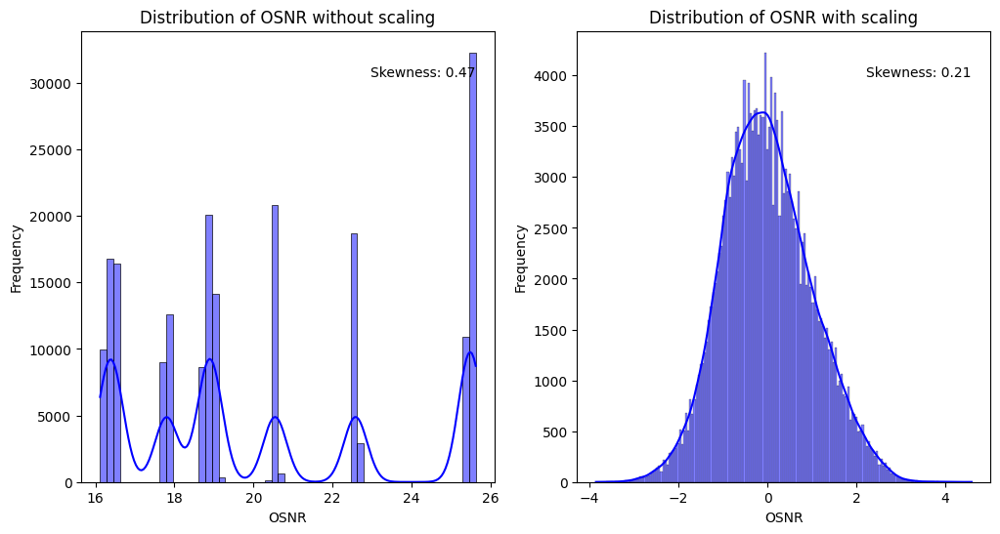

In [7]:
# Create a histogram
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(12, 6))

# Histogram for Absolute OSNR values
skewness_wo = aggr_df['OSNR'].skew()
sns.histplot(aggr_df['OSNR'], kde=True, color='blue', ax=axes[0])
axes[0].set_xlabel('OSNR')
axes[0].set_ylabel('Frequency')
axes[0].set_title('Distribution of OSNR without scaling')
axes[0].text(0.7, 0.9, f"Skewness: {skewness_wo:.2f}", transform=axes[0].transAxes)

# Histogram for Standardized OSNR Values
skewness_w = std_aggr_df['OSNR'].skew()
sns.histplot(std_aggr_df['OSNR'], kde=True, color='blue', ax=axes[1])
axes[1].set_xlabel('OSNR')
axes[1].set_ylabel('Frequency')
axes[1].set_title('Distribution of OSNR with scaling')
axes[1].text(0.7, 0.9, f"Skewness: {skewness_w:.2f}", transform=axes[1].transAxes)

plt.show()

As we observe in the OSNR distribution working with the absolute OSNR values is not right since each link has different characteristics, therefore it has different OSNR values.
However the scaled Dataset follows almost a normal distribution

The monitorings of samples are not being collected at exact 1 second from each other. Also Since only one monitoring device was available during the sampling, there is no reason to actually use the absolute time value for joining, instead we use the times just for an index.

Here we want to observe the effect of various techniques which are Normalization, Standardization or Differencing on part of our data. it is nice to actually see how the OSNR value actually behave for each case.

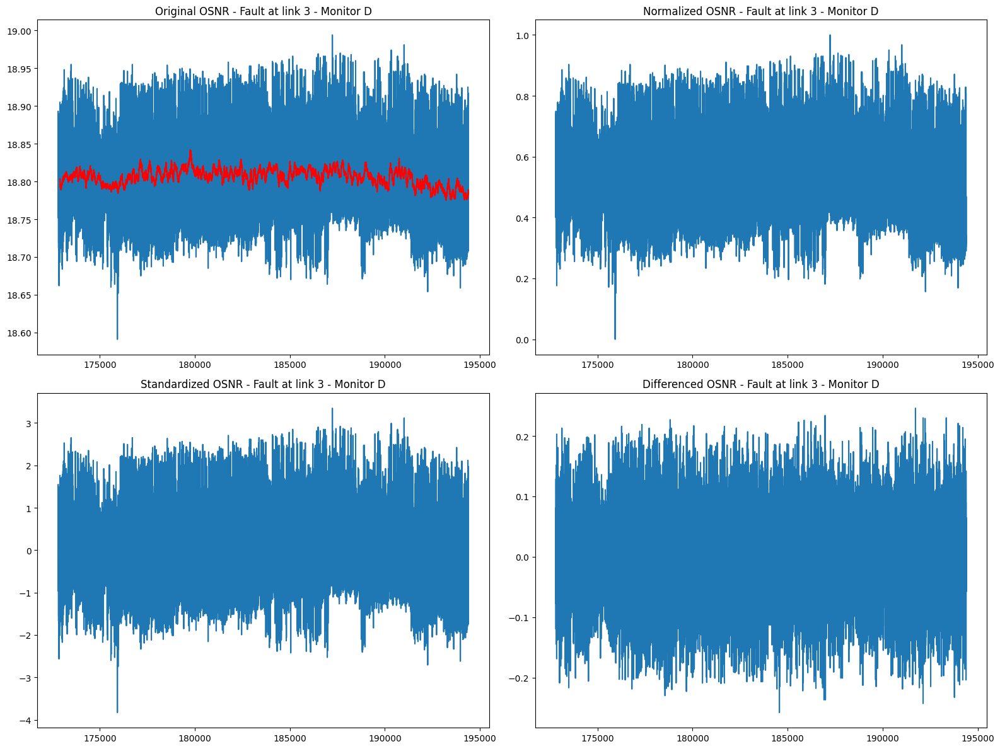

In [8]:
# Choosing the last fault at link 3 monitoring at node D example
df = aggr_df.tail(21600)

# Setting widnow size for slicing
window_size = 100
rolling_original_osnr = df['OSNR'].rolling(window_size).mean()

# Normalize OSNR
normalized_osnr = (df['OSNR'] - df['OSNR'].min()) / (df['OSNR'].max() - df['OSNR'].min())

# Standardize OSNR
standardized_osnr = (df['OSNR'] - df['OSNR'].mean()) / df['OSNR'].std()

# Calculate differences
differenced_osnr = df['OSNR'].diff()

# Create a figure with subplots
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(16, 12))

# Plot original OSNR values
axes[0, 0].plot(df['OSNR'])
axes[0, 0].plot(rolling_original_osnr, linestyle='-', color='red')
axes[0, 0].set_title('Original OSNR - Fault at link 3 - Monitor D')

# Plot normalized OSNR values
axes[0, 1].plot(normalized_osnr)
axes[0, 1].set_title('Normalized OSNR - Fault at link 3 - Monitor D')

# Plot standardized OSNR values
axes[1, 0].plot(standardized_osnr)
axes[1, 0].set_title('Standardized OSNR - Fault at link 3 - Monitor D')

# Plot differenced OSNR values
axes[1, 1].plot(differenced_osnr)
axes[1, 1].set_title('Differenced OSNR - Fault at link 3 - Monitor D')

plt.tight_layout()
plt.show()

As we see here the differencing is more robust against the outliers. as we see in these charts there is in outler that would be really affecting the dataset. both standardization and normalization are keeping the trend.

Let's have all of the options for testing them out later.

Now with our standard numbers let's build the the features extraction function.

### 1.3 Feature Extraction
We try to extract the statistical features from our OSNR values. We are grouping the OSNR values into different same size windows that are spaced from each other with a certain value.
The features we have chose to extract from each window are as follows:
+ Mean OSNR
+ Max OSNR
+ Min OSNR
+ Peak-to-Peak OSNR
+ Skewness
+ Kurtosis

In [9]:
@jit(nopython=True)  # Apply JIT compilation using Numba
def fast_kurtosis(arr):
    mean = np.mean(arr)
    var = np.var(arr)
    n = len(arr)
    m4 = np.sum((arr - mean) ** 4) / n
    kurt = (m4 / var**2) - 3
    return kurt

@jit(nopython=True)  # Apply JIT compilation using Numba
def fast_skewness(arr):
    mean = np.mean(arr)
    std = np.std(arr)
    n = len(arr)
    m3 = np.sum((arr - mean) ** 3) / n
    skew = m3 / (std**3)
    return skew

Using kurtosis and skewness was quite computationaly
expensive, so we used numba and our calculations dropped from 3 minutes to a few seconds.

In [10]:
def feature_extract(
    osnr_arr: np.array,
    window_size: int,
    spacing: int,
    node_name: str
    ) -> pd.DataFrame:
  """
  Calculate features from OSNR values using a sliding window approach.

  Args:
    osnr_values (array): np array of OSNR values.
    window_size (int): Size of the sliding window.
    spacing (int): Spacing between two consecutive windows.
    node_name (str): Name of the node which monitoring is being done.

  Returns:
    DataFrame: DataFrame containing the calculated features for each window.
  """
  # List of features
  features = [
    f'mean_{node_name}',
    f'std_{node_name}',
    f'max_osnr_{node_name}',
    f'min_osnr_{node_name}',
    f'peak_to_peak_{node_name}',
    f'kurtosis_{node_name}',
    f'skewness_{node_name}'
  ]
  result = []

  for i in range(0, len(osnr_arr) - window_size + 1, spacing):
      window = osnr_arr[i:i+window_size]

      # Mean OSNR value of each window
      window_mean = np.mean(window)
      # Standard deviation of OSNR in windows
      window_std = np.std(window)
      # Max OSNR value of each window
      window_max = np.max(window)
      # Min OSNR value of each window
      window_min = np.min(window)
      # Peak to Peak OSNR value
      window_peak_to_peak = window_max - window_min
      # Kurtosis of each window
      window_kurtosis = fast_kurtosis(window)
      # Skewness of each window
      window_skewness = fast_skewness(window)

      result.append([
        window_mean,
        window_std,
        window_max,
        window_min,
        window_peak_to_peak,
        window_kurtosis,
        window_skewness
      ])

  result_df = pd.DataFrame(result, columns=features)
  return result_df

In [11]:
# Overview and Test of our feature extraction function
window_size = 10
spacing = 1
feature_extract(std_aggr_df.head(21600)['OSNR'].values, window_size, spacing, 'B')

,mean_B,std_B,max_osnr_B,min_osnr_B,peak_to_peak_B,kurtosis_B,skewness_B
0,-0.147289,1.050458,2.267521,-0.877476,3.144996,0.586930,1.557780
1,-0.147289,1.050458,2.267521,-0.877476,3.144996,0.586930,1.557780
2,-0.461789,0.689012,1.583826,-0.877476,2.461302,4.799260,2.560758
3,-0.234802,0.928154,1.638522,-0.877476,2.515997,0.201236,1.458647
4,-0.207455,0.920874,1.638522,-0.877476,2.515997,0.128237,1.410731
...,...,...,...,...,...,...,...
21586,-0.281294,0.193687,-0.084389,-0.658693,0.574304,-0.928287,-0.692737
21587,-0.294967,0.213960,-0.084389,-0.658693,0.574304,-1.011560,-0.728388
21588,-0.270354,0.222444,-0.084389,-0.658693,0.574304,-0.894664,-0.896247
21589,-0.273089,0.220638,-0.084389,-0.658693,0.574304,-0.884469,-0.897345


In [12]:
def dataset_builder(
    inp_df: pd.DataFrame,
    links: list,
    nodes: list,
    window_size,
    spacing
    ) -> pd.DataFrame:
  """
  Builds the Final Dataset which contains data from each node

  Args:
    inp_df (pandas df): pd DataFrame of all data.
    links (list): List of links.
    nodes (list): List of nodes.
    window_size (int): Size of the sliding window.
    spacing (int): Spacing between two consecutive windows.

  Returns:
    DataFrame: DataFrame containing the features beside each other.
  """
  result_df = pd.DataFrame()
  # Going from each link since we append monitoring data from nodes
  for link in links:
    aggr_row = pd.DataFrame()
    for node in nodes:
      df = feature_extract(
            inp_df[(inp_df['link'] == link) &
                   (inp_df['node'] == node)
            ]['OSNR'].values,
            window_size,
            spacing,
            node
          )
      aggr_row = pd.concat([aggr_row, df], axis=1)

    # aggregating rows
    aggr_row['link'] = link
    result_df = pd.concat([result_df, aggr_row], ignore_index=True)

  return result_df

In [128]:
# Building the Dataset that contains features monitored for each Node
window_size = 10
spacing = 1
std_cpy = std_aggr_df.copy()
final_df = dataset_builder(std_cpy, links, nodes, window_size, spacing)

In [129]:
final_df

,mean_B,std_B,max_osnr_B,min_osnr_B,peak_to_peak_B,kurtosis_B,skewness_B,mean_C,std_C,max_osnr_C,...,kurtosis_C,skewness_C,mean_D,std_D,max_osnr_D,min_osnr_D,peak_to_peak_D,kurtosis_D,skewness_D,link
0,-0.147289,1.050458,2.267521,-0.877476,3.144996,0.586930,1.557780,0.854412,1.057799,1.823733,...,-1.050891,-0.801280,-0.115125,0.848617,0.803778,-2.398459,3.202237,2.466606,-1.731141,1
1,-0.147289,1.050458,2.267521,-0.877476,3.144996,0.586930,1.557780,0.871233,1.033000,1.823733,...,-1.019705,-0.801570,-0.289160,1.006045,0.803778,-2.398459,3.202237,-0.147097,-1.083813,1
2,-0.461789,0.689012,1.583826,-0.877476,2.461302,4.799260,2.560758,0.717740,1.121530,1.823733,...,-1.634799,-0.436351,-0.546731,1.057316,0.803778,-2.398459,3.202237,-1.140324,-0.622802,1
3,-0.234802,0.928154,1.638522,-0.877476,2.515997,0.201236,1.458647,0.827078,0.988612,1.823733,...,-1.640324,-0.424516,-0.493360,0.972573,0.803778,-1.911162,2.714940,-1.282336,-0.523694,1
4,-0.207455,0.920874,1.638522,-0.877476,2.515997,0.128237,1.410731,0.677790,0.951562,1.823733,...,-1.705454,-0.112416,-0.437669,1.021438,0.803778,-1.911162,2.714940,-1.335638,-0.484011,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
64768,0.408834,0.575042,1.485173,-0.500929,1.986102,-0.668763,0.403601,-0.993312,1.137849,1.795546,...,0.975005,1.219486,-0.285265,1.340336,1.977502,-1.746264,3.723766,-0.994396,0.693809,3
64769,0.335156,0.513233,1.485173,-0.500929,1.986102,0.361206,0.639428,-1.048702,1.148984,1.795546,...,1.068222,1.319039,-0.632698,1.144800,1.977502,-1.746264,3.723766,0.216261,1.161183,3
64770,0.280699,0.495066,1.485173,-0.500929,1.986102,1.194439,0.983741,-1.032085,1.142718,1.795546,...,1.078023,1.303302,-0.987258,0.768789,0.872844,-1.746264,2.619108,0.677588,1.221882,3
64771,0.191004,0.534150,1.485173,-0.500929,1.986102,0.951751,1.045495,-1.167789,1.145839,1.795546,...,1.724017,1.605713,-0.873228,0.745171,0.872844,-1.746264,2.619108,0.377997,0.976943,3


In [130]:
end_df = final_df.iloc[:, 14:]
end_df

,mean_D,std_D,max_osnr_D,min_osnr_D,peak_to_peak_D,kurtosis_D,skewness_D,link
0,-0.115125,0.848617,0.803778,-2.398459,3.202237,2.466606,-1.731141,1
1,-0.289160,1.006045,0.803778,-2.398459,3.202237,-0.147097,-1.083813,1
2,-0.546731,1.057316,0.803778,-2.398459,3.202237,-1.140324,-0.622802,1
3,-0.493360,0.972573,0.803778,-1.911162,2.714940,-1.282336,-0.523694,1
4,-0.437669,1.021438,0.803778,-1.911162,2.714940,-1.335638,-0.484011,1
...,...,...,...,...,...,...,...,...
64768,-0.285265,1.340336,1.977502,-1.746264,3.723766,-0.994396,0.693809,3
64769,-0.632698,1.144800,1.977502,-1.746264,3.723766,0.216261,1.161183,3
64770,-0.987258,0.768789,0.872844,-1.746264,2.619108,0.677588,1.221882,3
64771,-0.873228,0.745171,0.872844,-1.746264,2.619108,0.377997,0.976943,3


### 1.4 Feature Analysis
Here we want to explore the features a little bit.

In [16]:
# Visualize data distributions
def scatter_features(df):
    unique_target_values = df['link'].unique()
    num_features = len(df.columns) - 1  # Exclude the target variable

    fig, axs = plt.subplots(num_features, 1, figsize=(12, 4*num_features))

    # Iterate over each feature
    for i, feature in enumerate(df.columns[:-1]):
          # Iterate over each unique target value
          for j, value in enumerate(unique_target_values):
              subset = df[df['link'] == value]
              axs[i].scatter(subset[feature], [value] * len(subset), label=f'link={value}')

          axs[i].set_xlabel(feature)
          axs[i].set_ylabel('link')
          axs[i].set_title(f'Feature = {feature}')
          axs[i].legend()

    plt.tight_layout()
    plt.show()

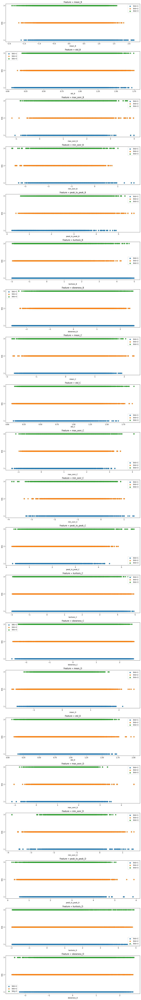

In [17]:
scatter_features(final_df)

In [18]:
def hist_features(df):
    unique_links = df['link'].unique()  # Get unique link values

    # Iterate over each feature
    for feature in df.columns[:-1]:  # Exclude the last column

        fig, axs = plt.subplots(1, len(unique_links), figsize=(12, 4))
        fig.suptitle(feature)  # Set feature name as the figure title

        for i, link_value in enumerate(unique_links):
            # Filter data for the current link value
            filtered_data = df[df['link'] == link_value]

            # Histogram for the current link value
            axs[i].hist(filtered_data[feature])
            axs[i].set_xlabel(feature)
            axs[i].set_ylabel('Frequency')
            axs[i].set_title(f'Link = {link_value}')

    plt.show()  # Show the histograms for all features

<ipython-input-18-6b57c5cd35cd>:7: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axs = plt.subplots(1, len(unique_links), figsize=(12, 4))


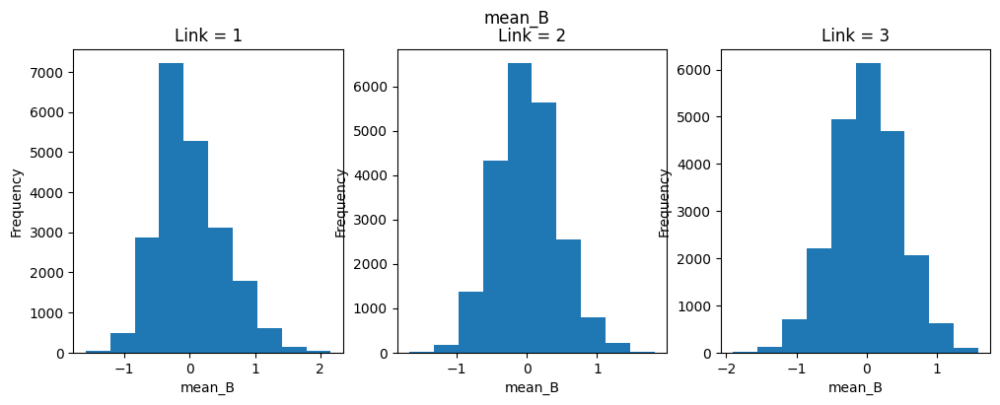

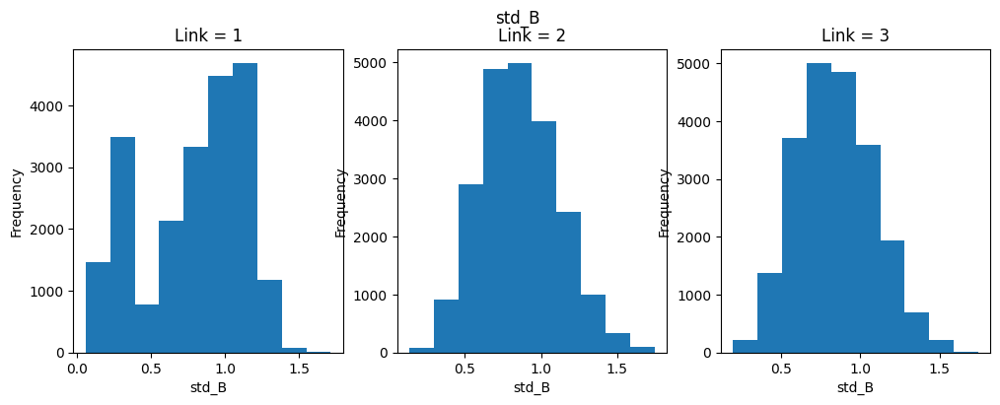

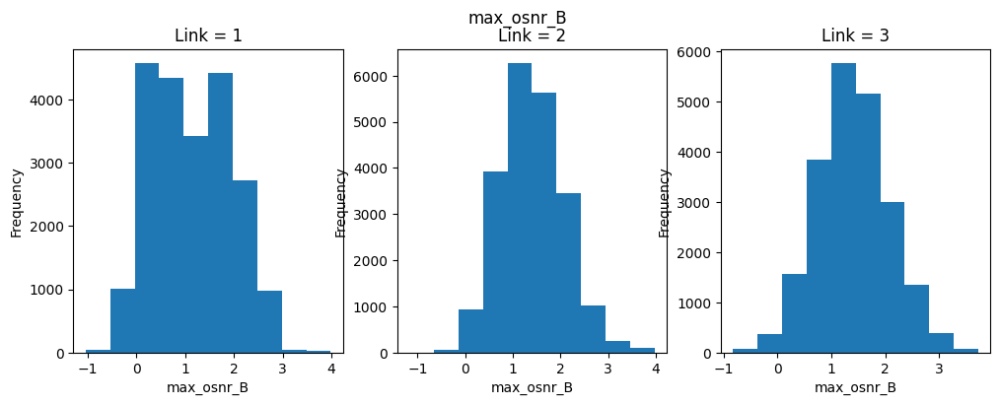

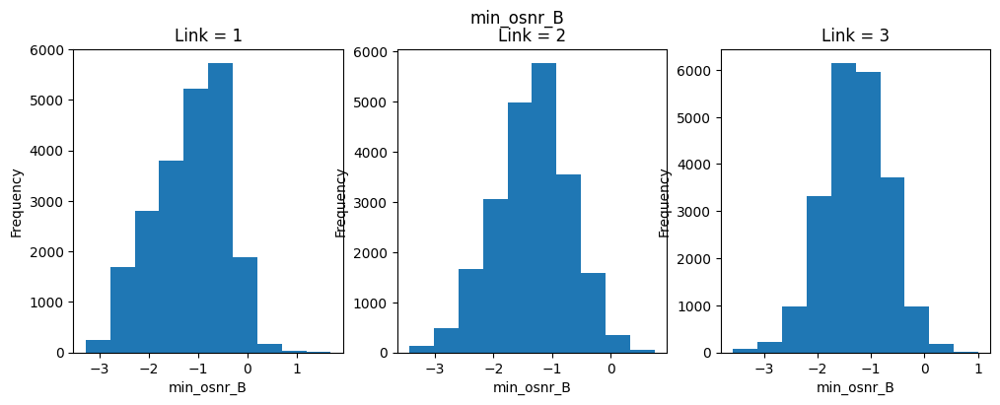

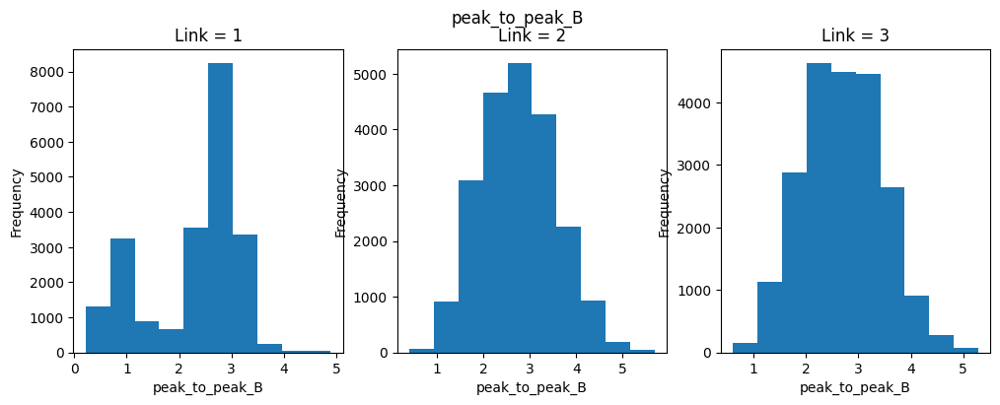

...

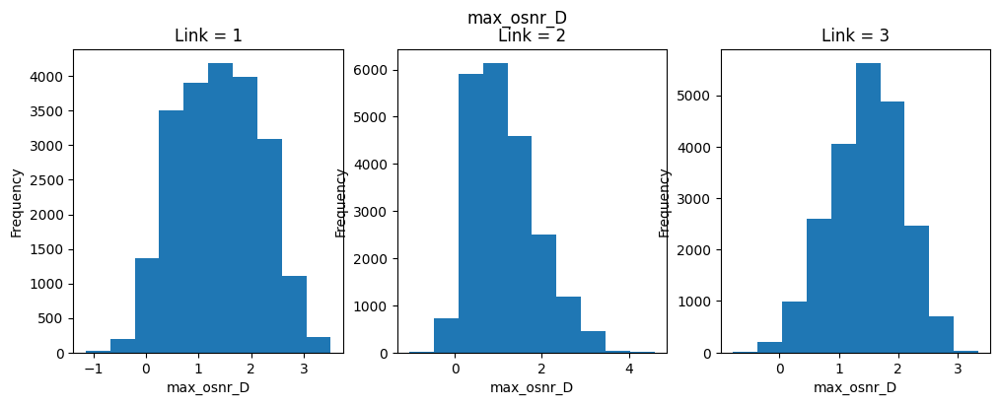

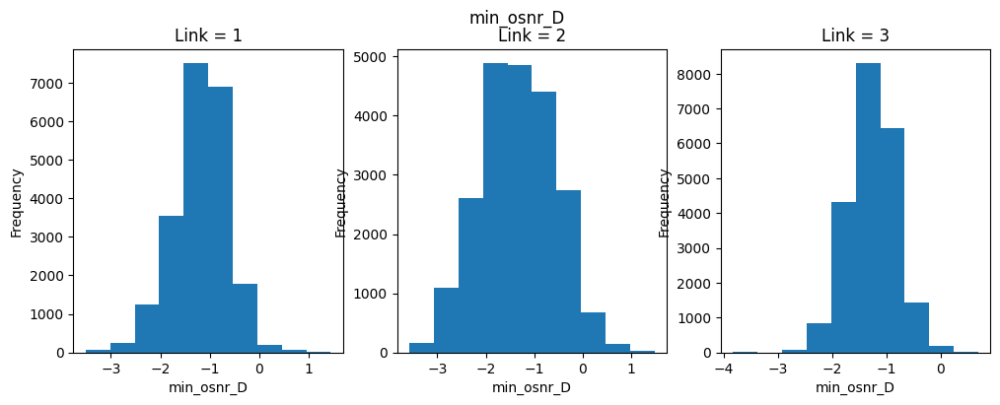

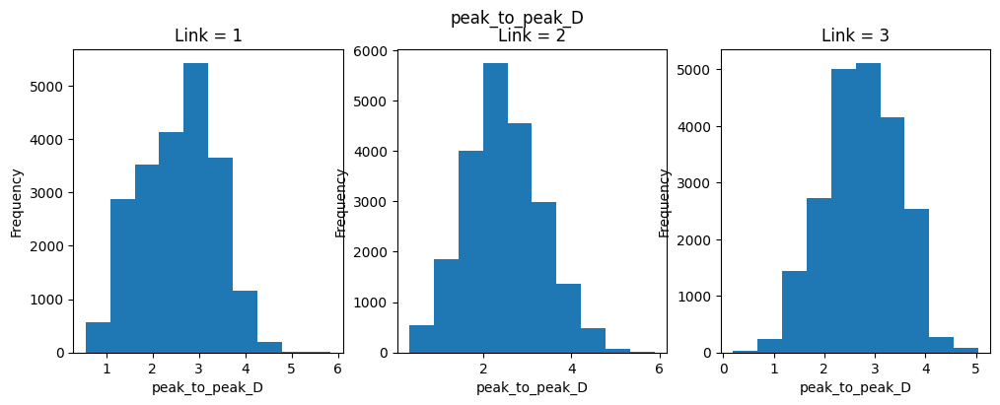

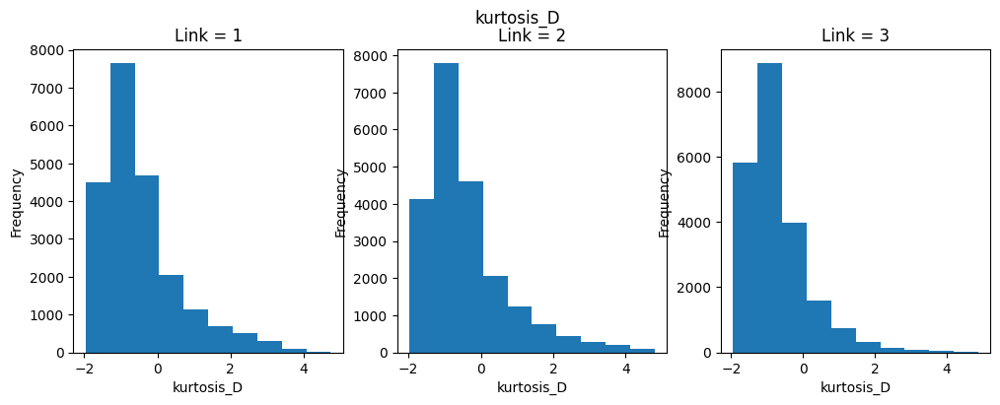

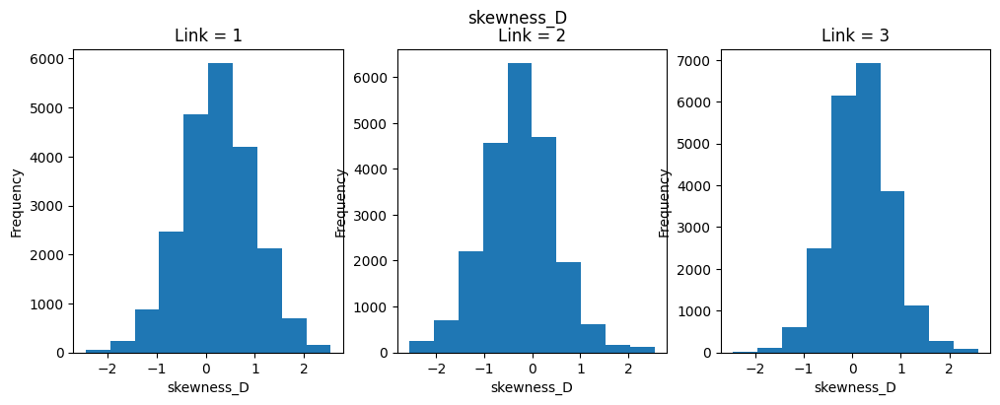

In [19]:
hist_features(final_df)

<ipython-input-20-fdfaf8fe561a>:3: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  correlation_matrix = final_df.corr()


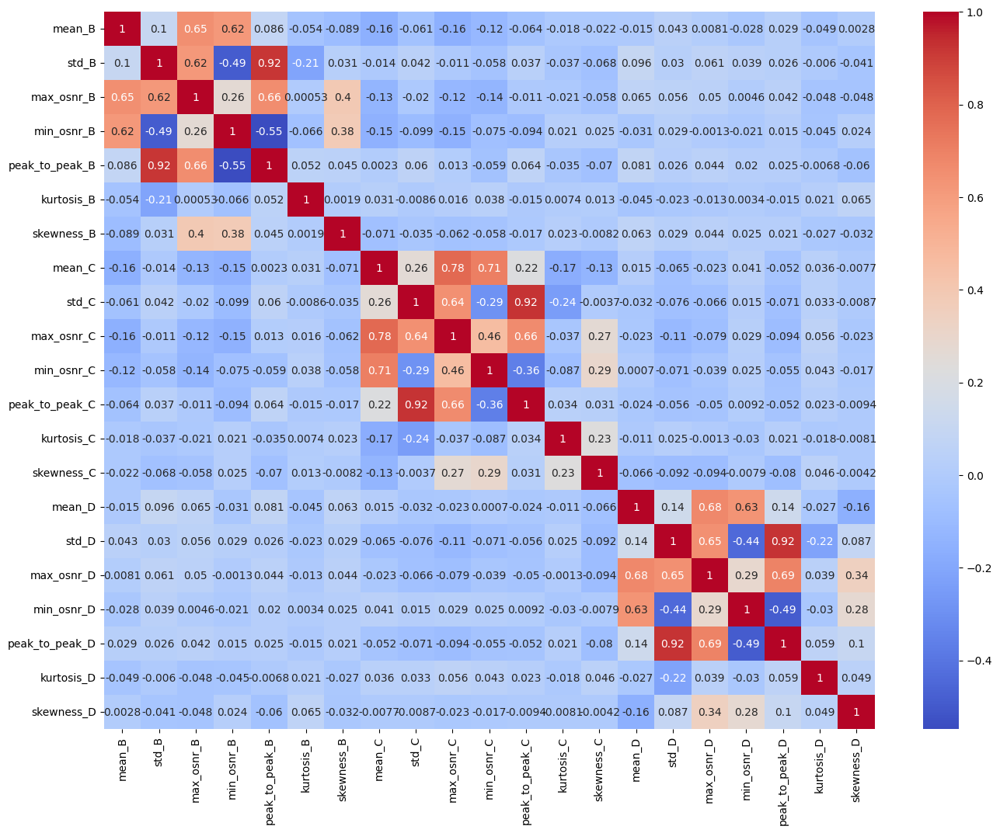

In [20]:
numeric_columns = final_df.select_dtypes(include=np.number)

correlation_matrix = final_df.corr()
plt.figure(figsize=(16, 12))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm')
plt.show()

<ipython-input-21-a1849a95af66>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  correlation_matrix = final_df[final_df['link'] == '1'].corr()


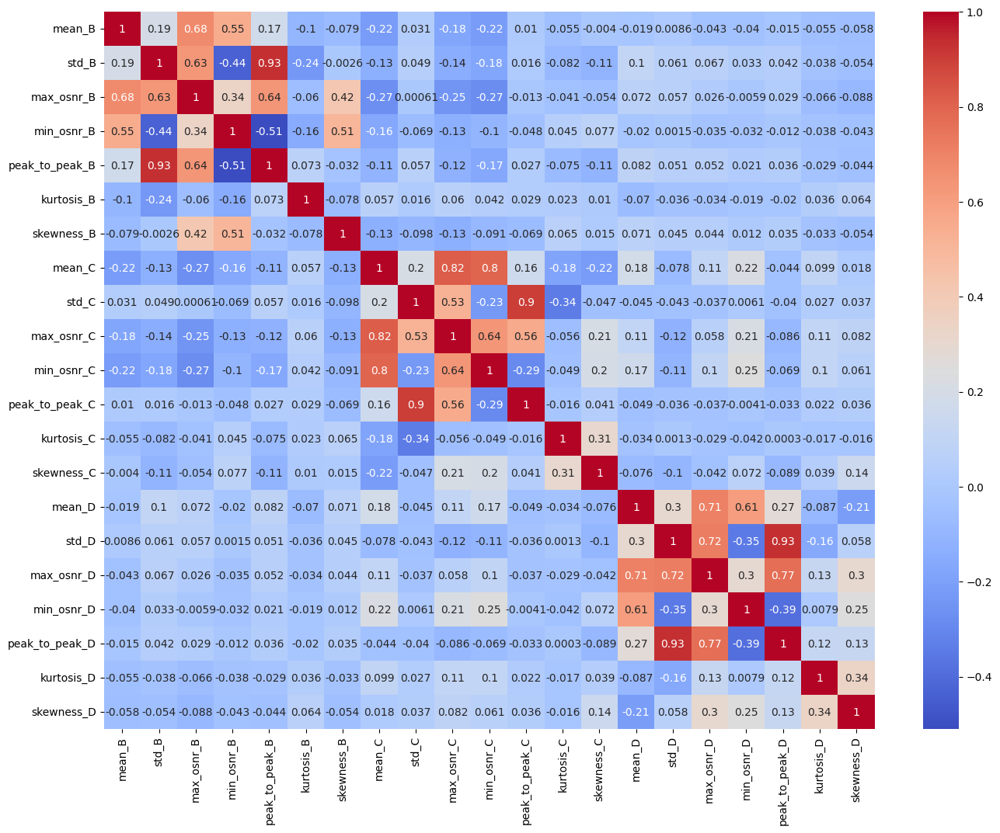

In [21]:
correlation_matrix = final_df[final_df['link'] == '1'].corr()
plt.figure(figsize=(16, 12))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm')
plt.show()

<ipython-input-22-c0e6517b9eac>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  correlation_matrix = final_df[final_df['link'] == '2'].corr()


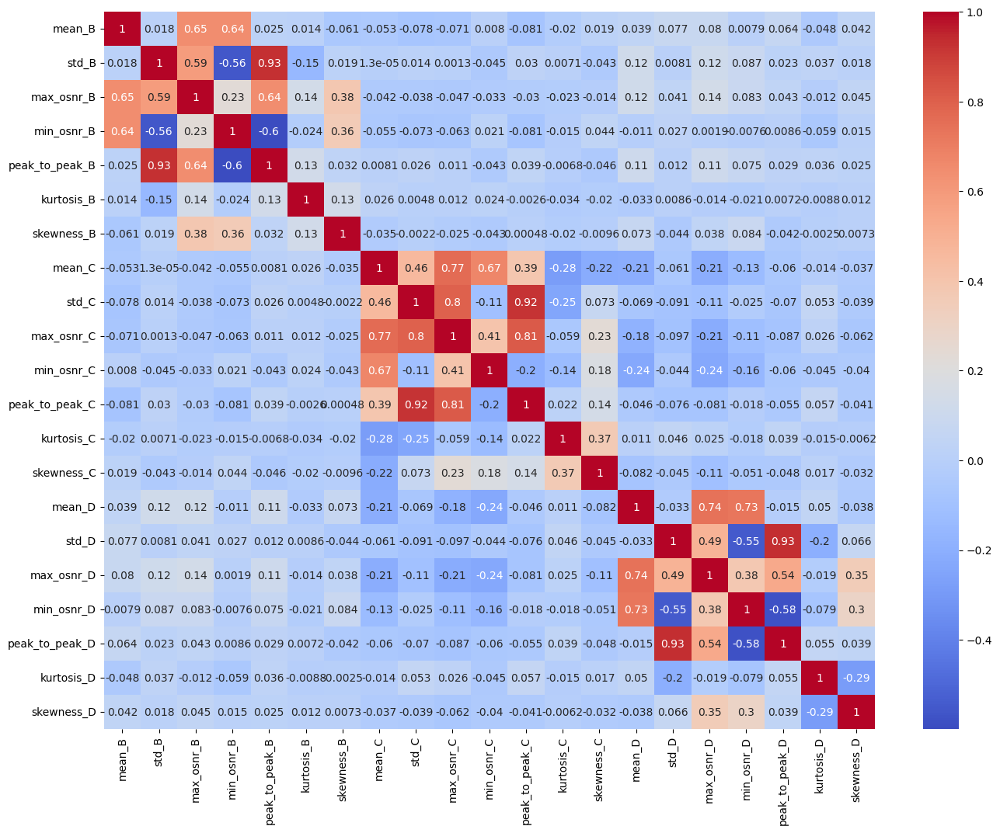

In [22]:
correlation_matrix = final_df[final_df['link'] == '2'].corr()
plt.figure(figsize=(16, 12))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm')
plt.show()

<ipython-input-23-fb91802531ef>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  correlation_matrix = final_df[final_df['link'] == '3'].corr()


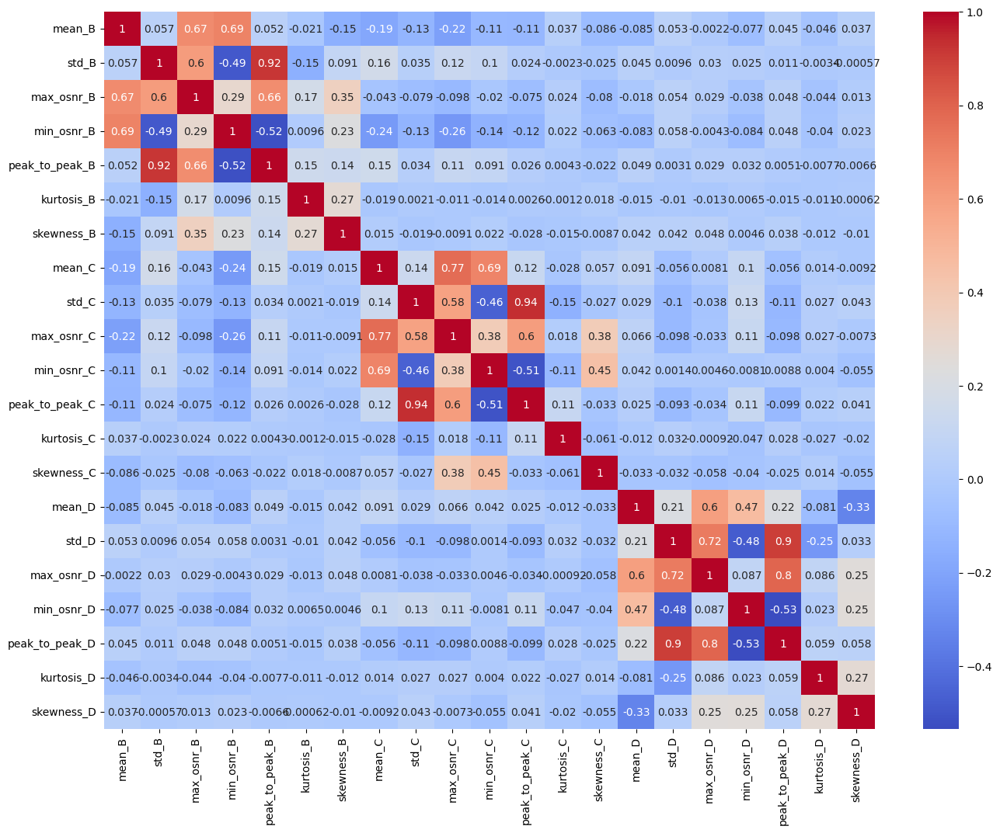

In [23]:
correlation_matrix = final_df[final_df['link'] == '3'].corr()
plt.figure(figsize=(16, 12))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm')
plt.show()

<ipython-input-24-212ebd56d6eb>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  correlation_matrix = end_df.corr()


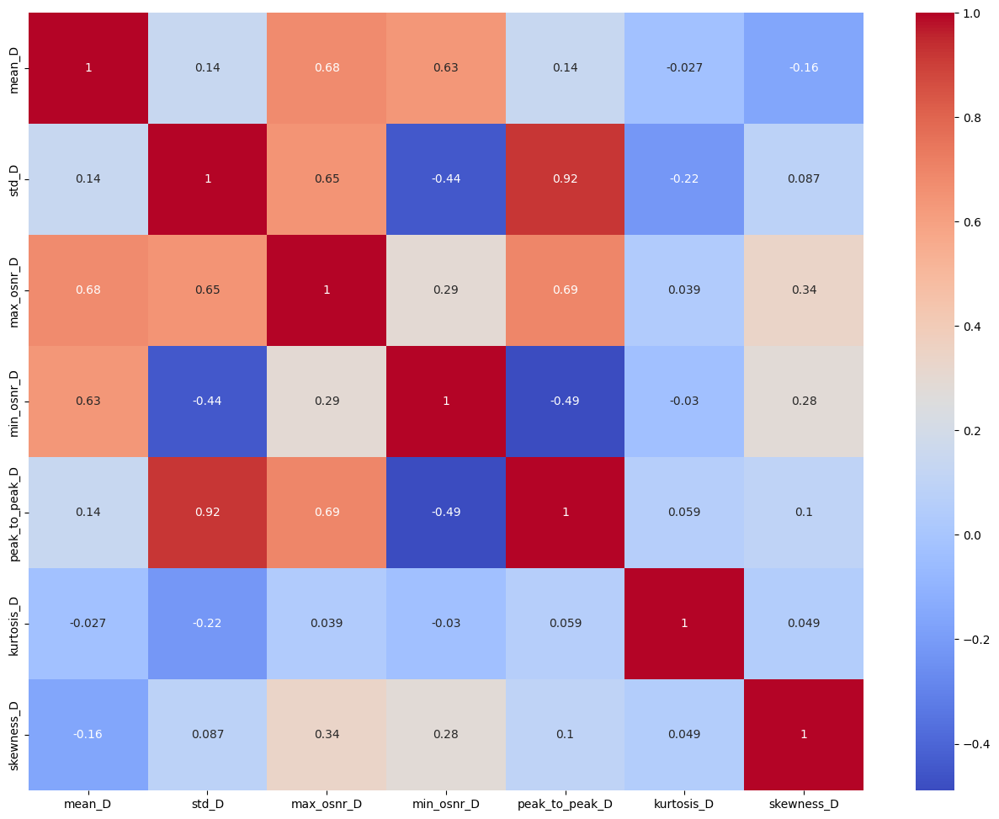

In [24]:
correlation_matrix = end_df.corr()
plt.figure(figsize=(16, 12))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm')
plt.show()

As we can derive from previous correlation heatmap we see that there are correlations that mainly caused because of our small window sizes. We later on explore and compare this correlation when we chose bigger windows with bigger spacings.

## 2. Model Training

In [29]:
def scatter_plot_train_test(
    X_train: pd.DataFrame,
    X_test: pd.DataFrame,
    y_train: pd.DataFrame,
    y_test: pd.DataFrame
  ) -> None:
  """
  This function plots the scatter for train and test data
  It helps us visualize the distribution of the train and test
  specially during the in_time split later on
  """
  plt.scatter(X_train.index, y_train, color='blue', label='Train')
  plt.scatter(X_test.index, y_test, color='red', label='Test')
  plt.xlabel('Data Index')
  plt.ylabel('Y')
  plt.legend()
  plt.title('Train vs Test Data Scatter Plot')

  plt.show()

### 2.1 Random Train and Test Sets
In the frist scenario we split the the train and test sets into completly randomly

#### 2.1.1 XGBoost
Using XGBoost model to do the classification.

In [121]:
def xgb_classifier_w_kfold(
    n_splits: int,
    df: pd.DataFrame,
    is_scaled: bool,
    fast_params: bool,
    test_size: float
  ):
  """
  Classification with XGBoost, We used hyper parameter training along side The
  Scaling

  Args:
    n_splits (int): Number of splits in outer cross validation.
    df (pandas df): pd DataFrame of all data.
    is_scaled (bool): Does the model scale the data or not.
    fast_params (bool): Indicates if we should use small or big params.
    test_size (float): Test size can be 0.3, 0.2, ...
  """
  # Checking if we scale the data or not
  if is_scaled:
        scaler = StandardScaler()
        X_scaled = scaler.fit_transform(df.drop('link', axis=1))
        df_scaled = pd.DataFrame(X_scaled, columns=df.columns[:-1])
        df_scaled['link'] = df['link']
        df = df_scaled

  # Parameteres for tuning
  if not fast_params:
    param_grid = {
      'n_estimators': [100, 200, 300],  # Number of trees or boosting rounds
      'max_depth': [3, 4, 5, 6],  # Maximum depth of each tree
      'learning_rate': [0.1, 0.01, 0.001],  # Learning rate (step size) for each boosting round
      'subsample': [0.8, 0.9, 1.0],  # Subsample ratio of training instances
      'colsample_bytree': [0.8, 0.9, 1.0],  # Subsample ratio of columns when constructing each tree
      'reg_alpha': [0, 0.1, 0.5],  # L1 regularization term on weights
      'reg_lambda': [0, 0.1, 0.5],  # L2 regularization term on weights
      'gamma': [0, 0.1, 0.5],  # Minimum loss reduction required to make a further partition on a leaf node
    }
  else:
    param_grid = {
      # 'n_estimators': [100, 200],  # Number of trees or boosting rounds
      'max_depth': [5, 6],  # Maximum depth of each tree
      # 'learning_rate': [0.1, 0.01],  # Learning rate (step size) for each boosting round
      'subsample': [0.8, 1.0],  # Subsample ratio of training instances
      # 'colsample_bytree': [0.8, 1.0],  # Subsample ratio of columns when constructing each tree
      # 'reg_alpha': [0, 0.1],  # L1 regularization term on weights
      # 'reg_lambda': [0, 0.1],  # L2 regularization term on weights
      # 'gamma': [0, 0.1],  # Minimum loss reduction required to make a further partition on a leaf node
    }

  # Split the data into features (X) and target variable (y)
  X = df.drop('link', axis=1)
  y = df['link']

  label_encoder = LabelEncoder()
  y = label_encoder.fit_transform(y)

  # Split data into initial train and test sets
  X_train_initial, X_test_initial, y_train_initial, y_test_initial = train_test_split(X, y, test_size=test_size, random_state=42)

  # Initialize the StratifiedKFold for hypermeter optimization
  # Outer cross validation of 5 folds
  outer_skf = StratifiedKFold(n_splits=n_splits, shuffle=True, random_state=42)
  # Inner cross validation of 3 folds
  inner_skf = StratifiedKFold(n_splits=2, shuffle=True, random_state=42)

  # Initialize a list to store the accuracies
  accuracies = []
  train_accuracies = []
  mse_scores = []
  precision_scores = []
  recall_scores = []
  f1_scores = []
  training_durations = []

  # Choosing the best model to predict
  best_model = None
  best_score = 0.0

  # Perform k-fold cross-validation
  for train_index, test_index in outer_skf.split(X_train_initial, y_train_initial):
    X_train, X_test = X_train_initial.iloc[train_index], X_train_initial.iloc[test_index]
    y_train, y_test = y_train_initial[train_index], y_train_initial[test_index]

    # Hyperparam optimization
    model = xgb.XGBClassifier(objective='multi:softmax', num_class=3)
    grid_search = GridSearchCV(estimator=model, param_grid=param_grid, cv=inner_skf)

    # Train time
    start_time = time.time()
    grid_search.fit(X_train, y_train)
    training_duration = time.time() - start_time

    # Checking the best grid for training data
    y_pred = grid_search.best_estimator_.predict(X_test)

    # Metrics for training
    train_accuracy = accuracy_score(y_test, y_pred)
    mse = mean_squared_error(y_test, y_pred)
    precision = precision_score(y_test, y_pred, average='macro')
    recall = recall_score(y_test, y_pred, average='macro')
    f1 = f1_score(y_test, y_pred, average='macro')

    # Checking the grid for test
    y_pred = grid_search.best_estimator_.predict(X_test_initial)
    accuracy = accuracy_score(y_test_initial, y_pred)

    # Saving the best model for more test
    if accuracy > best_score:
        best_score = accuracy
        best_mse = mean_squared_error(y_test_initial, y_pred)
        best_precision = precision_score(y_test_initial, y_pred, average='macro')
        best_recall = recall_score(y_test_initial, y_pred, average='macro')
        best_f1 = f1_score(y_test_initial, y_pred, average='macro')
        best_model = grid_search.best_estimator_


    accuracies.append(accuracy)
    mse_scores.append(mse)
    precision_scores.append(precision)
    recall_scores.append(recall)
    f1_scores.append(f1)
    training_durations.append(training_duration)
    train_accuracies.append(train_accuracy)



  # Compute the average accuracy across all folds
  average_accuracy = np.mean(accuracies)
  average_train_accuracy = np.mean(train_accuracies)
  average_mse = np.mean(mse_scores)
  average_precision = np.mean(precision_scores)
  average_f1 = np.mean(f1_scores)
  average_train_duration = np.mean(training_durations)


  print("Average Train accuracy: ", average_train_accuracy)
  print("Average Train mse: ", average_mse)
  print("Average Train precision: ", average_precision)
  print("Average Train f1: ", average_f1)
  print("Average Train duration: ", average_train_duration)
  print("Average Test accuracy:", average_accuracy)

  print("******************************************")

  print("Best Test accuracy:", best_score)
  print("Best Test MSE:", best_mse)
  print("Best Test precision:", best_precision)
  print("Best Test recall:", best_recall)
  print("Best Test best f1:", best_f1)

  # drawing confusing matrix
  y_pred_best = best_model.predict(X_test_initial)
  confusion_best = confusion_matrix(y_test_initial, y_pred_best)
  plt.figure(figsize=(8, 6))
  sns.heatmap(confusion_best, annot=True, cmap='Blues', fmt='d', cbar=False)
  plt.title('Confusion Matrix')
  plt.xlabel('Predicted')
  plt.ylabel('True')
  plt.show()

  return best_model

Average Train accuracy:  0.9736882790922683
Average Train mse:  0.05238078909121137
Average Train precision:  0.9737486199646839
Average Train f1:  0.9736876253964839
Average Train duration:  159.18059659004211
Average Test accuracy: 0.974207492795389
******************************************
Best Test accuracy: 0.9750926307122273
Best Test MSE: 0.04945450802799506
Best Test precision: 0.9750930385119293
Best Test recall: 0.975122252855499
Best Test best f1: 0.9750976272322909


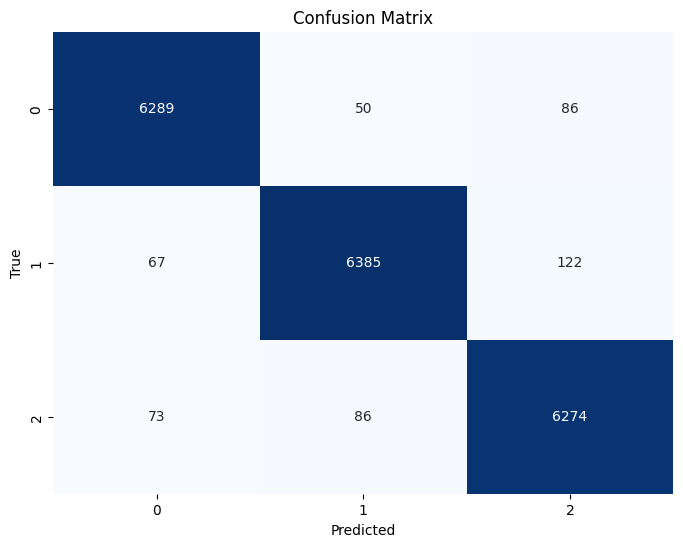

In [90]:
# Without Scaling and Test size 0.3
xgb_classifier_w_kfold(5, final_df, False, True, 0.3)

Average Train accuracy:  0.9728722688375058
Average Train mse:  0.05352768411837239
Average Train precision:  0.972904953693214
Average Train f1:  0.9728689046943888
Average Train duration:  159.6096067905426
Average Test accuracy: 0.9738472622478387
******************************************
Best Test accuracy: 0.9748867846850556
Best Test MSE: 0.050123507616303006
Best Test precision: 0.9748821573142475
Best Test recall: 0.9749234774474989
Best Test best f1: 0.9748898324697146


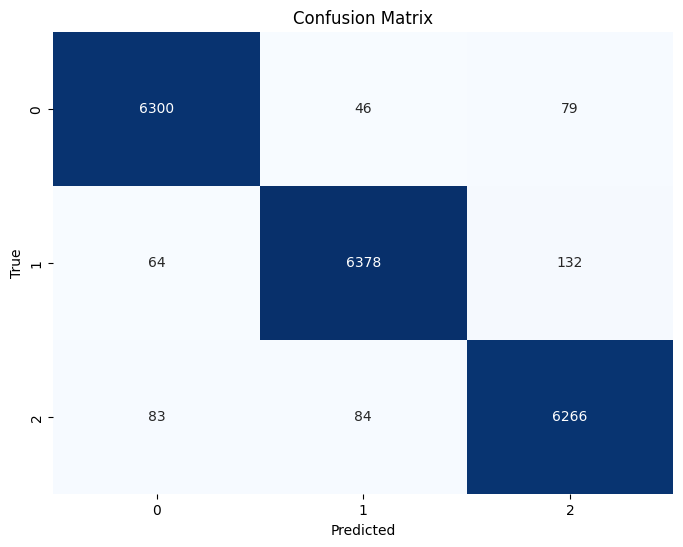

In [91]:
# With Scaling and test size 0.3
xgb_classifier_w_kfold(5, final_df, True, True, 0.3)

Average Train accuracy:  0.9740052031741792
Average Train mse:  0.05013703824799307
Average Train precision:  0.9740194935768812
Average Train f1:  0.9739988633317044
Average Train duration:  211.88204970359803
Average Test accuracy: 0.9747742184484756
******************************************
Best Test accuracy: 0.975993824778078
Best Test MSE: 0.048784253184098805
Best Test precision: 0.975975305879058
Best Test recall: 0.9760323053094737
Best Test best f1: 0.9759934222814158


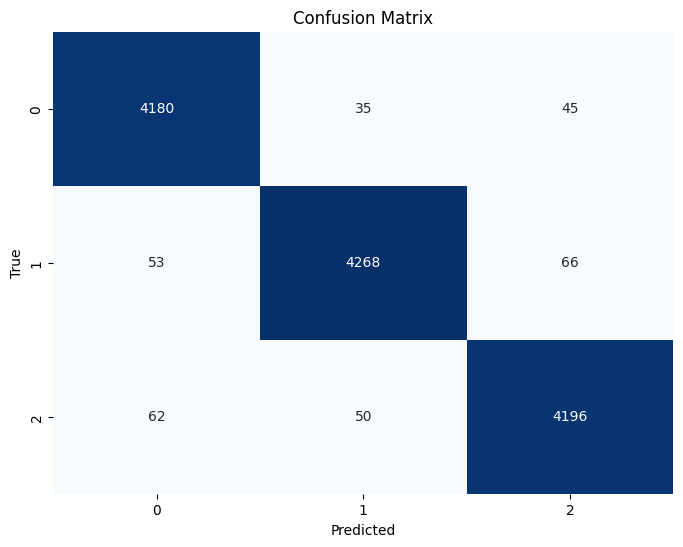

In [92]:
# With Scaling and test size 0.2
xgb_classifier_w_kfold(5, final_df, True, True, 0.2)

Testing with the dataset that has only data from last link

Average Train accuracy:  0.9721223888433055
Average Train mse:  0.038794809562505715
Average Train precision:  0.9724537204331568
Average Train f1:  0.9721634845688134
Average Train duration:  67.05446701049804
Average Test accuracy: 0.9725298476739399
******************************************
Best Test accuracy: 0.9732400164676822
Best Test MSE: 0.03417044051049815
Best Test precision: 0.9738885531907112
Best Test recall: 0.9731739291542381
Best Test best f1: 0.9733804808602514


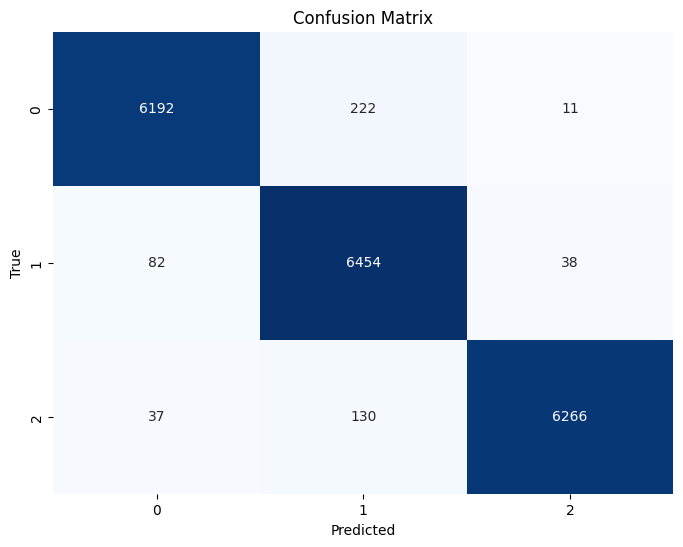

In [93]:
# With Scaling and Test Size 0.3
xgb_classifier_w_kfold(5, end_df, True, True, 0.3)

Average Train accuracy:  0.972306918451116
Average Train mse:  0.03996682114280562
Average Train precision:  0.97250353833756
Average Train f1:  0.9723339632076986
Average Train duration:  70.8125955104828
Average Test accuracy: 0.9713932844461597
******************************************
Best Test accuracy: 0.9729834040910845
Best Test MSE: 0.03975299112311849
Best Test precision: 0.9734505612657581
Best Test recall: 0.9729209110594085
Best Test best f1: 0.9730753051935629


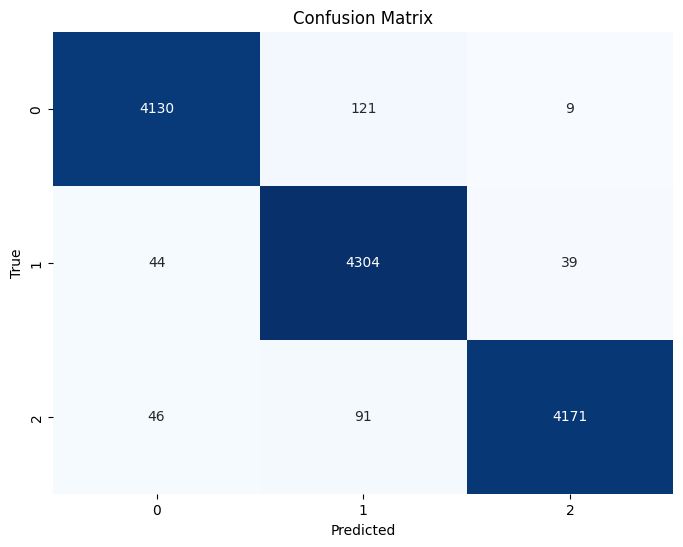

In [94]:
# With Scaling and Test Size 0.2
xgb_classifier_w_kfold(5, end_df, True, True, 0.2)

#### 2.1.2 Logistic Classifer
We chose Linear Classification for comparision due to having a multiclass classification.

In [145]:
def logistic_classifier_w_kfold(
    n_splits: int,
    df: pd.DataFrame,
    is_scaled: bool,
    test_size: float
  ) -> None:
  """
  Classification with XGBoost, We used hyper parameter training along side The
  Scaling

  Args:
    n_splits (int): Number of splits in outer cross validation.
    df (pandas df): pd DataFrame of all data.
    is_scaled (bool): Does the model scale the data or not.
    test_size (float): Test size can be 0.3, 0.2, ...
  """
  # Checking if we scale the data or not
  if is_scaled:
        scaler = StandardScaler()
        X_scaled = scaler.fit_transform(df.drop('link', axis=1))
        df_scaled = pd.DataFrame(X_scaled, columns=df.columns[:-1])
        df_scaled['link'] = df['link']
        df = df_scaled

  # Split the data into features (X) and target variable (y)
  X = df.drop('link', axis=1)
  y = df['link']

  label_encoder = LabelEncoder()
  y = label_encoder.fit_transform(y)

  # Split data into initial train and test sets
  X_train_initial, X_test_initial, y_train_initial, y_test_initial = train_test_split(X, y, test_size=test_size, random_state=42)

  # Initialize the StratifiedKFold for hypermeter optimization
  # Outer cross validation of 5 folds
  outer_skf = StratifiedKFold(n_splits=n_splits, shuffle=True, random_state=42)

  # Initialize a list to store the accuracies
  accuracies = []
  train_accuracies = []
  mse_scores = []
  precision_scores = []
  recall_scores = []
  f1_scores = []
  training_durations = []

  # Choosing the best model to predict
  best_model = None
  best_score = 0.0

  # Perform k-fold cross-validation
  for train_index, test_index in outer_skf.split(X_train_initial, y_train_initial):
    X_train, X_test = X_train_initial.iloc[train_index], X_train_initial.iloc[test_index]
    y_train, y_test = y_train_initial[train_index], y_train_initial[test_index]

    # Hyperparam optimization
    model = LogisticRegression(multi_class='multinomial', solver='sag')

    # Train time
    start_time = time.time()
    model.fit(X_train, y_train)
    training_duration = time.time() - start_time

    # Checking the best grid for training data
    y_pred = model.predict(X_test)

    # Metrics for training
    train_accuracy = accuracy_score(y_test, y_pred)
    mse = mean_squared_error(y_test, y_pred)
    precision = precision_score(y_test, y_pred, average='macro')
    recall = recall_score(y_test, y_pred, average='macro')
    f1 = f1_score(y_test, y_pred, average='macro')

    # Checking the grid for test
    y_pred = model.predict(X_test_initial)
    accuracy = accuracy_score(y_test_initial, y_pred)

    # Saving the best model for more test
    if accuracy > best_score:
        best_score = accuracy
        best_mse = mean_squared_error(y_test_initial, y_pred)
        best_precision = precision_score(y_test_initial, y_pred, average='macro')
        best_recall = recall_score(y_test_initial, y_pred, average='macro')
        best_f1 = f1_score(y_test_initial, y_pred, average='macro')
        best_model = model


    accuracies.append(accuracy)
    mse_scores.append(mse)
    precision_scores.append(precision)
    recall_scores.append(recall)
    f1_scores.append(f1)
    training_durations.append(training_duration)
    train_accuracies.append(train_accuracy)



  # Compute the average accuracy across all folds
  average_accuracy = np.mean(accuracies)
  average_train_accuracy = np.mean(train_accuracies)
  average_mse = np.mean(mse_scores)
  average_precision = np.mean(precision_scores)
  average_f1 = np.mean(f1_scores)
  average_train_duration = np.mean(training_durations)


  print("Average Train accuracy: ", average_train_accuracy)
  print("Average Train mse: ", average_mse)
  print("Average Train precision: ", average_precision)
  print("Average Train f1: ", average_f1)
  print("Average Train duration: ", average_train_duration)
  print("Average Test accuracy:", average_accuracy)

  print("******************************************")

  print("Best Test accuracy:", best_score)
  print("Best Test MSE:", best_mse)
  print("Best Test precision:", best_precision)
  print("Best Test recall:", best_recall)
  print("Best Test best f1:", best_f1)

  # drawing confusing matrix
  y_pred_best = best_model.predict(X_test_initial)
  confusion_best = confusion_matrix(y_test_initial, y_pred_best)
  plt.figure(figsize=(8, 6))
  sns.heatmap(confusion_best, annot=True, cmap='Blues', fmt='d', cbar=False)
  plt.title('Confusion Matrix')
  plt.xlabel('Predicted')
  plt.ylabel('True')
  plt.show()

  return

Average Train accuracy:  0.6678502188509863
Average Train mse:  0.5679628849506136
Average Train precision:  0.664791262654247
Average Train f1:  0.6654978623990015
Average Train duration:  0.8448235988616943
Average Test accuracy: 0.669534787978592
******************************************
Best Test accuracy: 0.6698744339234253
Best Test MSE: 0.5581515026759983
Best Test precision: 0.6673232668466009
Best Test recall: 0.6705200549788667
Best Test best f1: 0.6682923035747611


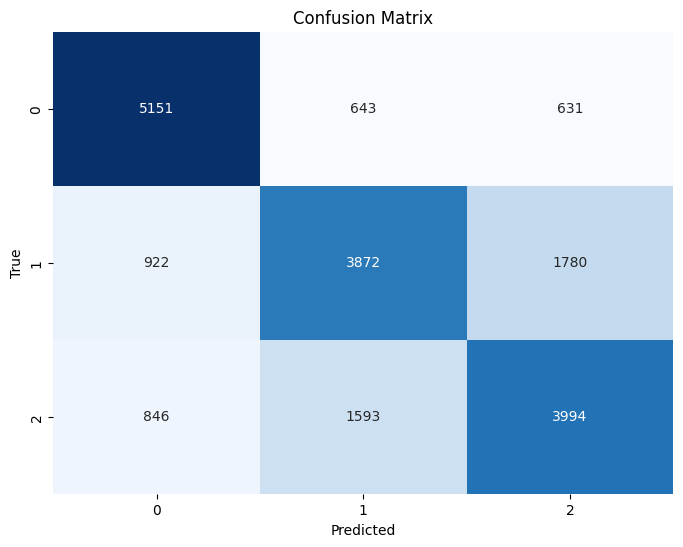

In [77]:
# Without Scaling and Test Size 0.3 on full Dataset
logistic_classifier_w_kfold(5, final_df, False, 0.3)

Average Train accuracy:  0.6681810476879628
Average Train mse:  0.5673012224127107
Average Train precision:  0.6651514946313437
Average Train f1:  0.6658534299605743
Average Train duration:  0.9335935592651368
Average Test accuracy: 0.6695039110745163
******************************************
Best Test accuracy: 0.670028818443804
Best Test MSE: 0.5566076574722107
Best Test precision: 0.6675554077350719
Best Test recall: 0.6706767438436456
Best Test best f1: 0.6685269536762087


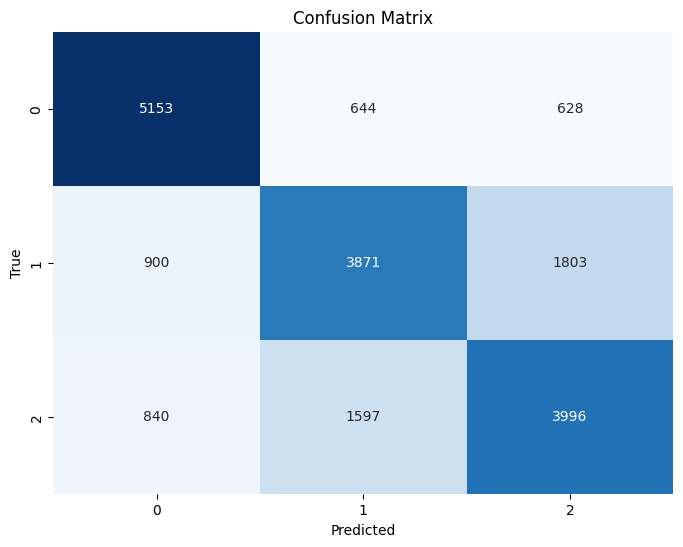

In [78]:
# With Scaling and Test Size 0.3 on full Dataset
logistic_classifier_w_kfold(5, final_df, True, 0.3)

Average Train accuracy:  0.6690147640644601
Average Train mse:  0.5627962208422455
Average Train precision:  0.6660472420323071
Average Train f1:  0.6667851403263809
Average Train duration:  1.7294510364532472
Average Test accuracy: 0.6664762639907371
******************************************
Best Test accuracy: 0.6669239675800849
Best Test MSE: 0.5653415669625628
Best Test precision: 0.6644438550543522
Best Test recall: 0.6679340013000449
Best Test best f1: 0.6654415770662647


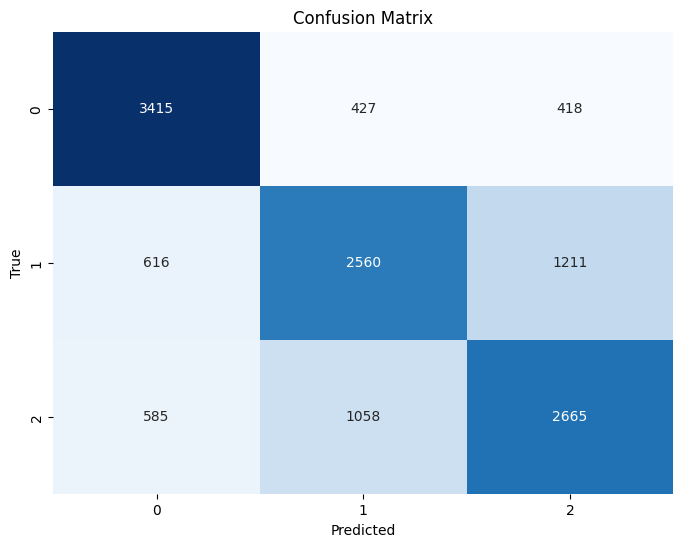

In [79]:
# With Scaling and Test Size 0.2 on full Dataset
logistic_classifier_w_kfold(5, final_df, True, 0.2)

Average Train accuracy:  0.4697732008335058
Average Train mse:  1.116649915223788
Average Train precision:  0.46817406909509074
Average Train f1:  0.46457670767945725
Average Train duration:  0.4917431831359863
Average Test accuracy: 0.47313709345409627
******************************************
Best Test accuracy: 0.47432070811033344
Best Test MSE: 1.0965932482503087
Best Test precision: 0.47193819843924567
Best Test recall: 0.47351478959689713
Best Test best f1: 0.46835495891273476


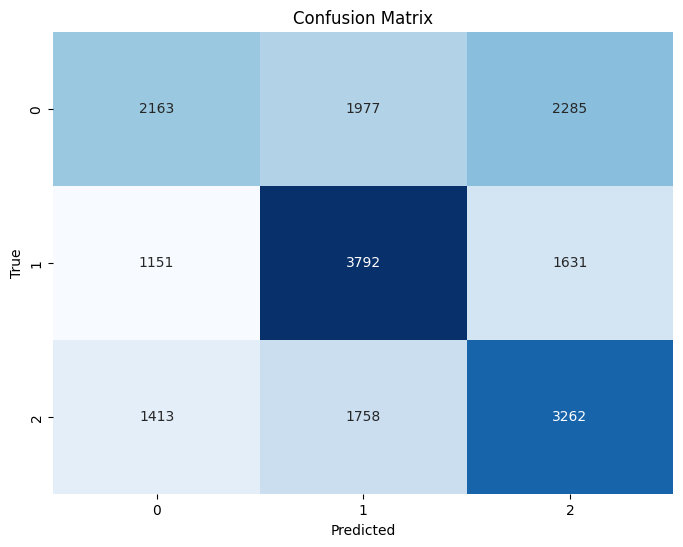

In [80]:
# With Scaling and Test Size 0.3 on full Dataset
logistic_classifier_w_kfold(5, end_df, True, 0.3)

Average Train accuracy:  0.46958595198091596
Average Train mse:  1.1124316452116614
Average Train precision:  0.4679162007229424
Average Train f1:  0.4645352124540293
Average Train duration:  0.7727694034576416
Average Test accuracy: 0.4751524507912003
******************************************
Best Test accuracy: 0.4758008490930143
Best Test MSE: 1.0975685063681977
Best Test precision: 0.4724340950966561
Best Test recall: 0.4746680134750834
Best Test best f1: 0.4696886989150591


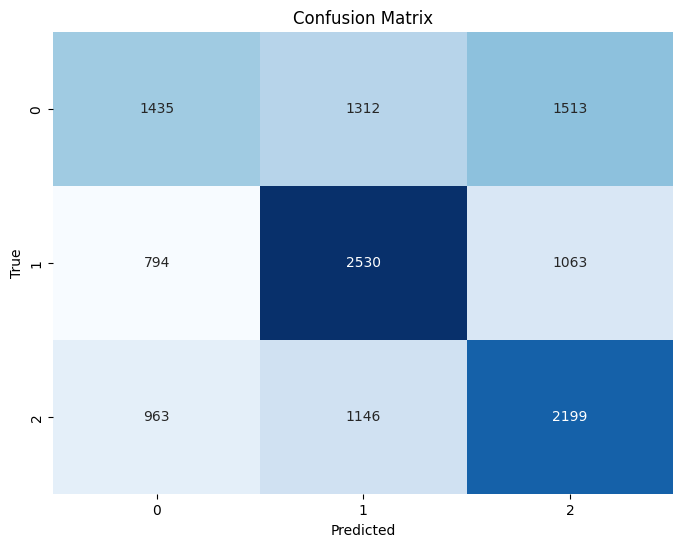

In [81]:
# With Scaling and Test Size 0.2 on full Dataset
logistic_classifier_w_kfold(5, end_df, True, 0.2)

### 2.2 In time Train and Test Split

#### 2.2.1 In Time Split

In [173]:
def in_time_spliter(df, window_size, spacing, train_ratio):
  """
  This function splits the data to get the last ratio of it.
  """
  start_point = int((21600 / spacing) * train_ratio)
  range_size = int(21600  / spacing)
  window_space = int(window_size / spacing)
  test_ranges = [
      (start_point, range_size - window_space),
      (start_point + range_size, 2 * (range_size - window_space)),
      (start_point + 2 * range_size, 3 * (range_size - window_space))
  ]

  # Get the indices for the rows in the test set
  test_indices = []
  for start, end in test_ranges:
      test_indices.extend(list(range(start, end + 1)))

  # Split the data into train and test sets
  train_data = df[~df.index.isin(test_indices)]
  test_data = df[df.index.isin(test_indices)]

  return train_data, test_data

In [96]:
train_data, test_data = in_time_spliter(final_df, 10, 1, 0.7)

X_train = train_data.drop('link', axis=1)
y_train = train_data['link']

X_test = test_data.drop('link', axis=1)
y_test = test_data['link']

train_data

,mean_B,std_B,max_osnr_B,min_osnr_B,peak_to_peak_B,kurtosis_B,skewness_B,mean_C,std_C,max_osnr_C,...,kurtosis_C,skewness_C,mean_D,std_D,max_osnr_D,min_osnr_D,peak_to_peak_D,kurtosis_D,skewness_D,link
0,-0.147289,1.050458,2.267521,-0.877476,3.144996,0.586930,1.557780,0.854412,1.057799,1.823733,...,-1.050891,-0.801280,-0.115125,0.848617,0.803778,-2.398459,3.202237,2.466606,-1.731141,1
1,-0.147289,1.050458,2.267521,-0.877476,3.144996,0.586930,1.557780,0.871233,1.033000,1.823733,...,-1.019705,-0.801570,-0.289160,1.006045,0.803778,-2.398459,3.202237,-0.147097,-1.083813,1
2,-0.461789,0.689012,1.583826,-0.877476,2.461302,4.799260,2.560758,0.717740,1.121530,1.823733,...,-1.634799,-0.436351,-0.546731,1.057316,0.803778,-2.398459,3.202237,-1.140324,-0.622802,1
3,-0.234802,0.928154,1.638522,-0.877476,2.515997,0.201236,1.458647,0.827078,0.988612,1.823733,...,-1.640324,-0.424516,-0.493360,0.972573,0.803778,-1.911162,2.714940,-1.282336,-0.523694,1
4,-0.207455,0.920874,1.638522,-0.877476,2.515997,0.128237,1.410731,0.677790,0.951562,1.823733,...,-1.705454,-0.112416,-0.437669,1.021438,0.803778,-1.911162,2.714940,-1.335638,-0.484011,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
58316,-0.292708,0.621862,0.716360,-1.461946,2.178305,-0.609440,-0.148080,-0.782832,0.902988,0.853926,...,-0.606764,0.940440,0.028315,0.627970,1.532075,-0.730692,2.262767,0.734404,0.984635,3
58317,-0.251064,0.653963,0.716360,-1.461946,2.178305,-0.877226,-0.194820,-0.702518,0.868202,0.853926,...,-0.617084,0.842969,-0.075024,0.675161,1.532075,-0.837594,2.369670,0.562127,1.042541,3
58318,-0.388810,0.576121,0.524156,-1.461946,1.986102,-0.652240,-0.063536,-0.569583,0.948454,0.853926,...,-1.376808,0.468876,-0.192616,0.698047,1.532075,-0.855411,2.387487,0.965275,1.295564,3
64771,0.191004,0.534150,1.485173,-0.500929,1.986102,0.951751,1.045495,-1.167789,1.145839,1.795546,...,1.724017,1.605713,-0.873228,0.745171,0.872844,-1.746264,2.619108,0.377997,0.976943,3


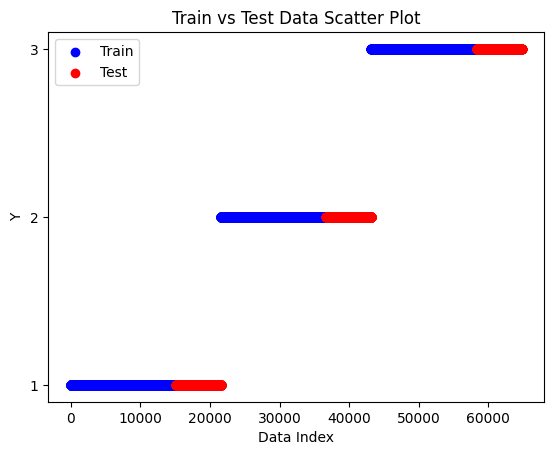

In [97]:
train_data, test_data = in_time_spliter(final_df, 10, 1, 0.7)

X_train = train_data.drop('link', axis=1)
y_train = train_data['link']

X_test = test_data.drop('link', axis=1)
y_test = test_data['link']

scatter_plot_train_test(X_train, X_test, y_train, y_test)

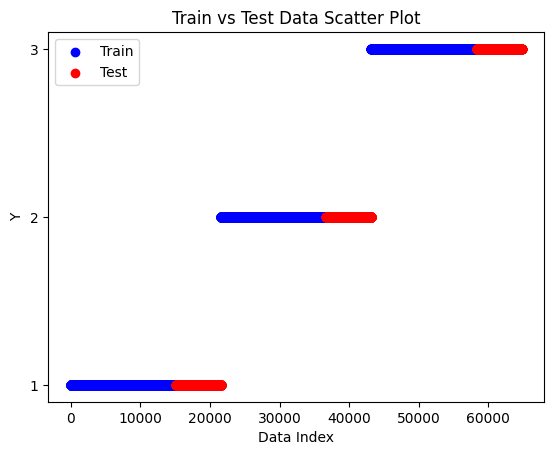

In [98]:
train_data, test_data = in_time_spliter(end_df, 10, 1, 0.7)

X_train = train_data.drop('link', axis=1)
y_train = train_data['link']

X_test = test_data.drop('link', axis=1)
y_test = test_data['link']

scatter_plot_train_test(X_train, X_test, y_train, y_test)

#### 2.2.2 XGBoost


In [178]:
def in_time_xgb_classifier_w_kfold(
    n_splits: int,
    train_df: pd.DataFrame,
    test_df: pd.DataFrame,
    fast_params: bool
  ):
  """
  Classification with XGBoost, We used hyper parameter training along side The
  Scaling

  Args:
    n_splits (int): Number of splits in outer cross validation.
    train_df (pandas df): pd DataFrame of training set.
    test_df (pandas df): pd DataFrame of training set.
    fast_params (bool): Indicates if we should use small or big params.
  """
  # Parameteres for tuning
  if not fast_params:
    param_grid = {
      'n_estimators': [100, 200, 300],  # Number of trees or boosting rounds
      'max_depth': [3, 4, 5, 6],  # Maximum depth of each tree
      'learning_rate': [0.1, 0.01, 0.001],  # Learning rate (step size) for each boosting round
      'subsample': [0.8, 0.9, 1.0],  # Subsample ratio of training instances
      'colsample_bytree': [0.8, 0.9, 1.0],  # Subsample ratio of columns when constructing each tree
      'reg_alpha': [0, 0.1, 0.5],  # L1 regularization term on weights
      'reg_lambda': [0, 0.1, 0.5],  # L2 regularization term on weights
      'gamma': [0, 0.1, 0.5],  # Minimum loss reduction required to make a further partition on a leaf node
    }
  else:
    param_grid = {
      # 'n_estimators': [100, 200],  # Number of trees or boosting rounds
      'max_depth': [4, 6],  # Maximum depth of each tree
      # 'learning_rate': [0.1, 0.01],  # Learning rate (step size) for each boosting round
      'subsample': [0.8, 1.0],  # Subsample ratio of training instances
      #'colsample_bytree': [0.8, 1.0],  # Subsample ratio of columns when constructing each tree
      #'reg_alpha': [0, 0.1],  # L1 regularization term on weights
      #'reg_lambda': [0, 0.1],  # L2 regularization term on weights
      #'gamma': [0, 0.1],  # Minimum loss reduction required to make a further partition on a leaf node
    }

  # Shuffling the data
  train_df = train_df.sample(frac=1, random_state=42)
  test_df = test_df.sample(frac=1, random_state=42)

  label_encoder = LabelEncoder()

  # Split the data into features (X) and target variable (y)
  X_train_initial = train_df.drop('link', axis=1)
  y_train_initial = train_df['link']
  y_train_initial = label_encoder.fit_transform(y_train_initial)


  X_test_initial = test_df.drop('link', axis=1)
  y_test_initial = test_df['link']
  y_test_initial = label_encoder.fit_transform(y_test_initial)

  # Initialize the StratifiedKFold for hypermeter optimization
  # Outer cross validation of 5 folds
  outer_skf = StratifiedKFold(n_splits=n_splits, shuffle=True, random_state=42)
  # Inner cross validation of 3 folds
  inner_skf = StratifiedKFold(n_splits=2, shuffle=True, random_state=42)

  # Initialize a list to store the accuracies
  accuracies = []
  train_accuracies = []
  mse_scores = []
  precision_scores = []
  recall_scores = []
  f1_scores = []
  training_durations = []

  # Choosing the best model to predict
  best_model = None
  best_score = 0.0

  # Perform k-fold cross-validation
  for train_index, test_index in outer_skf.split(X_train_initial, y_train_initial):
    X_train, X_test = X_train_initial.iloc[train_index], X_train_initial.iloc[test_index]
    y_train, y_test = y_train_initial[train_index], y_train_initial[test_index]

    # Hyperparam optimization
    model = xgb.XGBClassifier(objective='multi:softmax', num_class=3)
    grid_search = GridSearchCV(estimator=model, param_grid=param_grid, cv=inner_skf)

    # Train time
    start_time = time.time()
    grid_search.fit(X_train, y_train)
    training_duration = time.time() - start_time

    # Checking the best grid for training data
    y_pred = grid_search.best_estimator_.predict(X_test)

    # Metrics for training
    train_accuracy = accuracy_score(y_test, y_pred)
    mse = mean_squared_error(y_test, y_pred)
    precision = precision_score(y_test, y_pred, average='macro')
    recall = recall_score(y_test, y_pred, average='macro')
    f1 = f1_score(y_test, y_pred, average='macro')

    # Checking the grid for test
    y_pred = grid_search.best_estimator_.predict(X_test_initial)
    accuracy = accuracy_score(y_test_initial, y_pred)

    # Saving the best model for more test
    if accuracy > best_score:
        best_score = accuracy
        best_mse = mean_squared_error(y_test_initial, y_pred)
        best_precision = precision_score(y_test_initial, y_pred, average='macro')
        best_recall = recall_score(y_test_initial, y_pred, average='macro')
        best_f1 = f1_score(y_test_initial, y_pred, average='macro')
        best_model = grid_search.best_estimator_


    accuracies.append(accuracy)
    mse_scores.append(mse)
    precision_scores.append(precision)
    recall_scores.append(recall)
    f1_scores.append(f1)
    training_durations.append(training_duration)
    train_accuracies.append(train_accuracy)



  # Compute the average accuracy across all folds
  average_accuracy = np.mean(accuracies)
  average_train_accuracy = np.mean(train_accuracies)
  average_mse = np.mean(mse_scores)
  average_precision = np.mean(precision_scores)
  average_f1 = np.mean(f1_scores)
  average_train_duration = np.mean(training_durations)


  print("Average Train accuracy: ", average_train_accuracy)
  print("Average Train mse: ", average_mse)
  print("Average Train precision: ", average_precision)
  print("Average Train f1: ", average_f1)
  print("Average Train duration: ", average_train_duration)

  print("Average Test accuracy:", average_accuracy)

  print("Best Test accuracy:", best_score)
  print("Best Test MSE:", best_mse)
  print("Best Test precision:", best_precision)
  print("Best Test recall:", best_recall)
  print("Best Test best f1:", best_f1)

  # drawing confusing matrix
  y_pred_best = best_model.predict(X_test_initial)
  confusion_best = confusion_matrix(y_test_initial, y_pred_best)
  plt.figure(figsize=(8, 6))
  sns.heatmap(confusion_best, annot=True, cmap='Blues', fmt='d', cbar=False)
  plt.title('Confusion Matrix')
  plt.xlabel('Predicted')
  plt.ylabel('True')
  plt.show()

  return best_model

Average Train accuracy:  0.9808756072711053
Average Train mse:  0.038094500933641515
Average Train precision:  0.9808914430330151
Average Train f1:  0.9808752233554004
Average Train duration:  191.58872818946838
Average Test accuracy: 0.8723924481584648
Best Test accuracy: 0.8820282678221397
Best Test MSE: 0.25275972351181264
Best Test precision: 0.8821163157522491
Best Test recall: 0.88201211479822
Best Test best f1: 0.8820148301022929


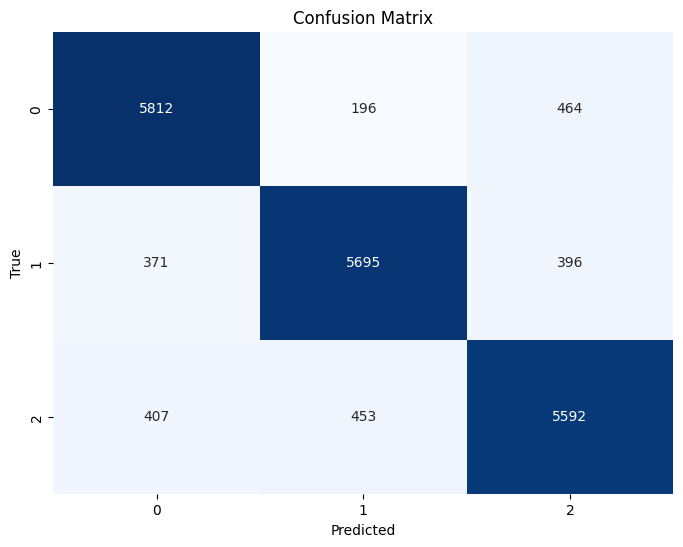

In [101]:
# Testing In_time split on window size
train_data, test_data = in_time_spliter(final_df, 10, 1, 0.7)

model_3_full_10 = in_time_xgb_classifier_w_kfold(5, train_data, test_data, True)

Average Train accuracy:  0.9741777108886268
Average Train mse:  0.03672851761057383
Average Train precision:  0.9743703462544431
Average Train f1:  0.9742148322694264
Average Train duration:  60.3552502155304
Average Test accuracy: 0.9465490560198081
Best Test accuracy: 0.950479727638502
Best Test MSE: 0.07923243577839678
Best Test precision: 0.9515117471358406
Best Test recall: 0.9504718924583525
Best Test best f1: 0.9506063186271226


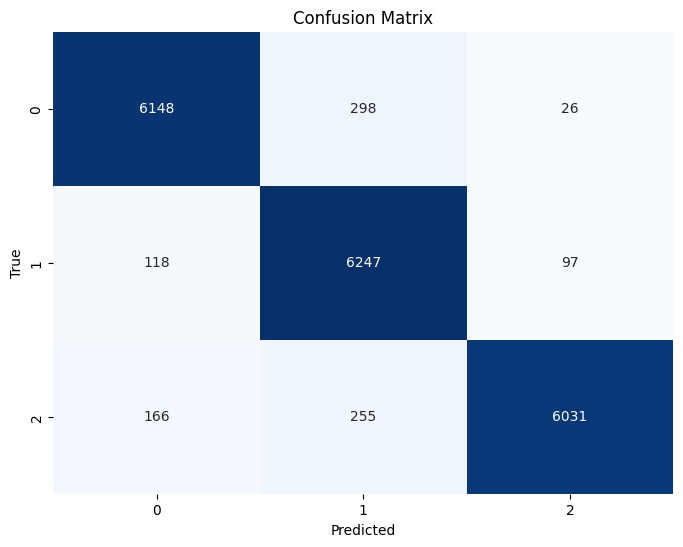

In [102]:
# Testing In time spli on window 10 with 0.3 test size on partial dataset
train_data, test_data = in_time_spliter(end_df, 10, 1, 0.7)

model_3_partial_10 = in_time_xgb_classifier_w_kfold(5, train_data, test_data, True)

#### 2.2.3 Logistic Regression

In [131]:
def in_time_logistic_classifier_w_kfold(
    n_splits: int,
    train_df: pd.DataFrame,
    test_df: pd.DataFrame
  ):
  """
  Classification with Logistic Regression, We used hyper parameter training along side The
  Scaling

  Args:
    n_splits (int): Number of splits in outer cross validation.
    train_df (pandas df): pd DataFrame of training set.
    test_df (pandas df): pd DataFrame of training set.
  """
  # Shuffling the data
  train_df = train_df.sample(frac=1, random_state=42)
  test_df = test_df.sample(frac=1, random_state=42)

  label_encoder = LabelEncoder()

  # Split the data into features (X) and target variable (y)
  X_train_initial = train_df.drop('link', axis=1)
  y_train_initial = train_df['link']
  y_train_initial = label_encoder.fit_transform(y_train_initial)


  X_test_initial = test_df.drop('link', axis=1)
  y_test_initial = test_df['link']
  y_test_initial = label_encoder.fit_transform(y_test_initial)

  # Initialize the StratifiedKFold for hypermeter optimization
  # Outer cross validation of 5 folds
  outer_skf = StratifiedKFold(n_splits=n_splits, shuffle=True, random_state=42)

  # Initialize a list to store the accuracies
  accuracies = []
  train_accuracies = []
  mse_scores = []
  precision_scores = []
  recall_scores = []
  f1_scores = []
  training_durations = []

  # Choosing the best model to predict
  best_model = None
  best_score = 0.0

  # Perform k-fold cross-validation
  for train_index, test_index in outer_skf.split(X_train_initial, y_train_initial):
    X_train, X_test = X_train_initial.iloc[train_index], X_train_initial.iloc[test_index]
    y_train, y_test = y_train_initial[train_index], y_train_initial[test_index]

    # Hyperparam optimization
    model = LogisticRegression(multi_class='multinomial', solver='sag')

    # Train time
    start_time = time.time()
    model.fit(X_train, y_train)
    training_duration = time.time() - start_time

    # Checking the best grid for training data
    y_pred = model.predict(X_test)

    # Metrics for training
    train_accuracy = accuracy_score(y_test, y_pred)
    mse = mean_squared_error(y_test, y_pred)
    precision = precision_score(y_test, y_pred, average='macro')
    recall = recall_score(y_test, y_pred, average='macro')
    f1 = f1_score(y_test, y_pred, average='macro')

    # Checking the grid for test
    y_pred = model.predict(X_test_initial)
    accuracy = accuracy_score(y_test_initial, y_pred)

    # Saving the best model for more test
    if accuracy > best_score:
        best_score = accuracy
        best_mse = mean_squared_error(y_test_initial, y_pred)
        best_precision = precision_score(y_test_initial, y_pred, average='macro')
        best_recall = recall_score(y_test_initial, y_pred, average='macro')
        best_f1 = f1_score(y_test_initial, y_pred, average='macro')
        best_model = model


    accuracies.append(accuracy)
    mse_scores.append(mse)
    precision_scores.append(precision)
    recall_scores.append(recall)
    f1_scores.append(f1)
    training_durations.append(training_duration)
    train_accuracies.append(train_accuracy)



  # Compute the average accuracy across all folds
  average_accuracy = np.mean(accuracies)
  average_train_accuracy = np.mean(train_accuracies)
  average_mse = np.mean(mse_scores)
  average_precision = np.mean(precision_scores)
  average_f1 = np.mean(f1_scores)
  average_train_duration = np.mean(training_durations)


  print("Average Train accuracy: ", average_train_accuracy)
  print("Average Train mse: ", average_mse)
  print("Average Train precision: ", average_precision)
  print("Average Train f1: ", average_f1)
  print("Average Train duration: ", average_train_duration)
  print("Average Test accuracy:", average_accuracy)

  print("******************************************")

  print("Best Test accuracy:", best_score)
  print("Best Test MSE:", best_mse)
  print("Best Test precision:", best_precision)
  print("Best Test recall:", best_recall)
  print("Best Test best f1:", best_f1)

  # drawing confusing matrix
  y_pred_best = best_model.predict(X_test_initial)
  confusion_best = confusion_matrix(y_test_initial, y_pred_best)
  plt.figure(figsize=(8, 6))
  sns.heatmap(confusion_best, annot=True, cmap='Blues', fmt='d', cbar=False)
  plt.title('Confusion Matrix')
  plt.xlabel('Predicted')
  plt.ylabel('True')
  plt.show()

  return best_model

Average Train accuracy:  0.6716462490761339
Average Train mse:  0.5417848782088898
Average Train precision:  0.6690599833846429
Average Train f1:  0.6699248781159816
Average Train duration:  0.7755878448486329
Average Test accuracy: 0.5837202104611576
******************************************
Best Test accuracy: 0.5854740534406273
Best Test MSE: 0.8043433405550398
Best Test precision: 0.5836305592438964
Best Test recall: 0.58538031387028
Best Test best f1: 0.584275612157564


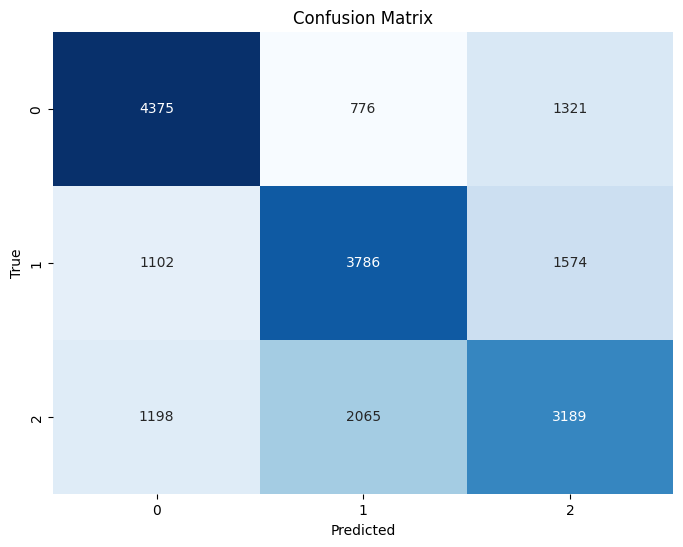

In [132]:
# Testing In_time split on window size 10 and test size 0.3 without scaling
train_data, test_data = in_time_spliter(final_df, 10, 1, 0.7)

lmodel_3_full_10 = in_time_logistic_classifier_w_kfold(5, train_data, test_data)

Average Train accuracy:  0.671536082945395
Average Train mse:  0.5415645459474123
Average Train precision:  0.668988749202054
Average Train f1:  0.669841831481055
Average Train duration:  1.238112783432007
Average Test accuracy: 0.5832765913545858
******************************************
Best Test accuracy: 0.5851129681213246
Best Test MSE: 0.8022284122562674
Best Test precision: 0.5835518255822302
Best Test recall: 0.5850217827447964
Best Test best f1: 0.5841009156940312


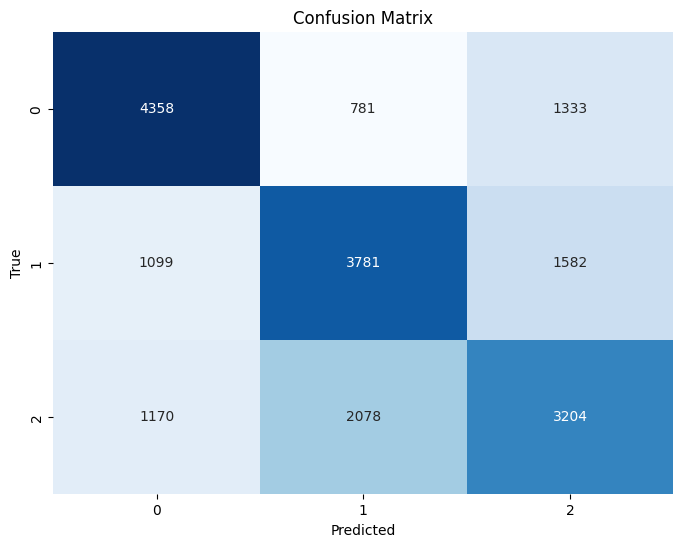

In [133]:
# Testing In_time split on window size 10 and test size 0.3 with scaling
train_data, test_data = in_time_spliter(final_df, 10, 1, 0.7)

# Reset index
train_data.reset_index(drop=True, inplace=True)
test_data.reset_index(drop=True, inplace=True)

# Scaling
scaler = StandardScaler()

# Train set
X_train = train_data.drop('link', axis=1)
y_train = train_data['link']
X_train_scaled = scaler.fit_transform(X_train)
train_data_scaled = pd.DataFrame(X_train_scaled, columns=X_train.columns)
train_data_scaled['link'] = y_train
train_data = train_data_scaled

# Test set
X_test = test_data.drop('link', axis=1)
y_test = test_data['link']
X_test_scaled = scaler.transform(X_test)
test_data_scaled = pd.DataFrame(X_test_scaled, columns=X_test.columns)
test_data_scaled['link'] = y_test
test_data = test_data_scaled


lsmodel_3_full_10 = in_time_logistic_classifier_w_kfold(5, train_data, test_data)

Average Train accuracy:  0.4467800939226397
Average Train mse:  1.1473767492595903
Average Train precision:  0.44506505393436385
Average Train f1:  0.44012360883158436
Average Train duration:  0.8308406829833984
Average Test accuracy: 0.5116269472815433
******************************************
Best Test accuracy: 0.5136696585164552
Best Test MSE: 1.1059527494067884
Best Test precision: 0.5088339668703722
Best Test recall: 0.5136898405067601
Best Test best f1: 0.5096696059687948


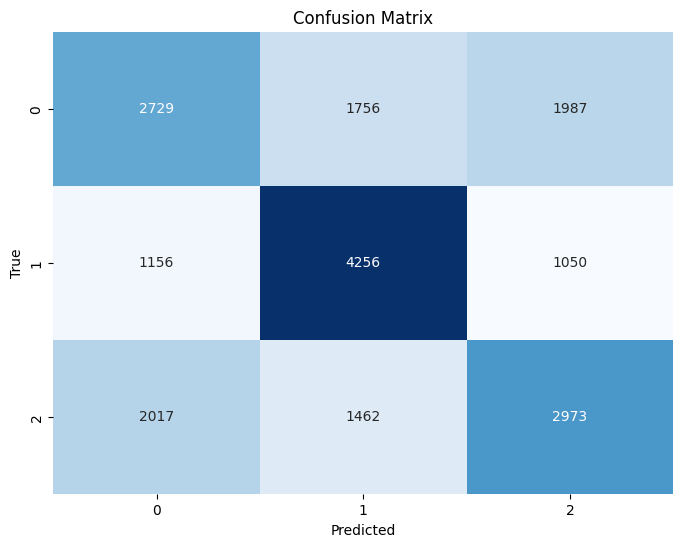

In [134]:
# Testing In_time split partial on window size 10 and test size 0.3 without scaling
train_data, test_data = in_time_spliter(end_df, 10, 1, 0.7)

lmodel_3_partial_10 = in_time_logistic_classifier_w_kfold(5, train_data, test_data)

Average Train accuracy:  0.44675805535675134
Average Train mse:  1.1472666074003999
Average Train precision:  0.445001086123565
Average Train f1:  0.4401234506094201
Average Train duration:  0.5250661849975586
Average Test accuracy: 0.511317445579284
******************************************
Best Test accuracy: 0.5132054059630661
Best Test MSE: 1.1067265036624367
Best Test precision: 0.508328239314512
Best Test recall: 0.5132257463706079
Best Test best f1: 0.5091581849839081


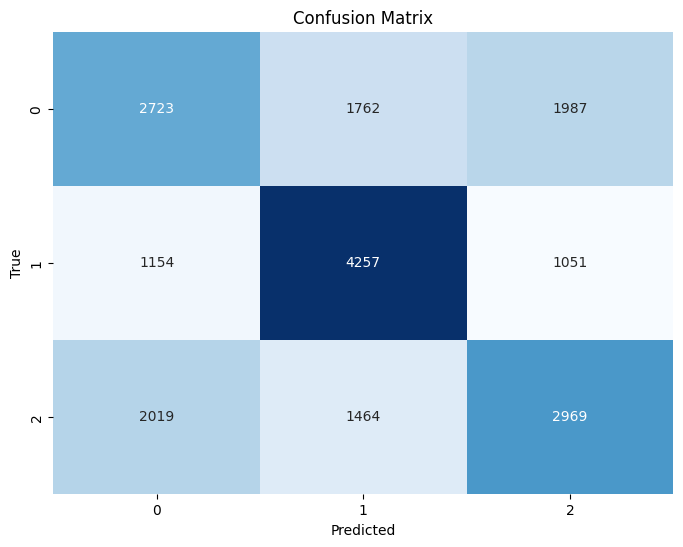

In [135]:
# Testing In_time split on window size 10 and test size 0.3 with scaling
train_data, test_data = in_time_spliter(end_df, 10, 1, 0.7)

# Reset index
train_data.reset_index(drop=True, inplace=True)
test_data.reset_index(drop=True, inplace=True)

# Scaling
scaler = StandardScaler()

# Train set
X_train = train_data.drop('link', axis=1)
y_train = train_data['link']
X_train_scaled = scaler.fit_transform(X_train)
train_data_scaled = pd.DataFrame(X_train_scaled, columns=X_train.columns)
train_data_scaled['link'] = y_train
train_data = train_data_scaled

# Test set
X_test = test_data.drop('link', axis=1)
y_test = test_data['link']
X_test_scaled = scaler.transform(X_test)
test_data_scaled = pd.DataFrame(X_test_scaled, columns=X_test.columns)
test_data_scaled['link'] = y_test
test_data = test_data_scaled

lsmodel_3_partial_10 = in_time_logistic_classifier_w_kfold(5, train_data, test_data)

### 2.3 Bigger Window sizes and Spacing
Something that was concering to me was the window sizes. I believed that 10s window size with 1 sec difference is not rational, the difference between the windows were not much. So let's test on window sizes of 100 with 25 steps between them.

#### 2.3.1 Random Splits

##### 2.3.1.1 XGBoost

In [142]:
window_size = 100
spacing = 25
std_cpy = std_aggr_df.copy()
new_final_df = dataset_builder(std_cpy, links, nodes, window_size, spacing)
new_end_df = new_final_df.iloc[:, 14:]

In [137]:
new_final_df

,mean_B,std_B,max_osnr_B,min_osnr_B,peak_to_peak_B,kurtosis_B,skewness_B,mean_C,std_C,max_osnr_C,...,kurtosis_C,skewness_C,mean_D,std_D,max_osnr_D,min_osnr_D,peak_to_peak_D,kurtosis_D,skewness_D,link
0,-0.158775,0.853506,2.267521,-1.998735,4.266256,0.033878,-0.146887,0.437878,0.865643,2.244263,...,-0.365284,-0.095219,-0.249480,1.113478,2.010418,-2.468073,4.478491,-0.945739,-0.115725,1
1,-0.135256,0.943241,1.556478,-1.998735,3.555213,-0.922648,-0.274244,0.457222,0.864823,2.244263,...,-0.346165,-0.106545,-0.148076,1.161455,2.567329,-2.468073,5.035402,-0.548191,0.322044,1
2,-0.251758,1.007760,1.802608,-1.998735,3.801343,-1.127768,0.169230,0.340104,0.898593,2.580687,...,-0.485733,0.206895,-0.109324,1.139979,2.567329,-2.212822,4.780151,-0.550228,0.513353,1
3,-0.208275,1.012817,1.802608,-1.889344,3.691952,-1.062339,0.536193,0.289010,0.817179,2.580687,...,-0.109150,0.811201,-0.008848,1.089753,2.567329,-2.003981,4.571310,-0.383016,0.525119,1
4,-0.254766,0.861363,1.802608,-1.670562,3.473170,0.028135,1.074261,0.250952,0.834887,2.580687,...,1.225356,0.040119,0.114137,0.947823,2.567329,-2.003981,4.571310,0.219845,0.559972,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2578,0.257314,0.907686,3.343140,-1.237708,4.580848,1.924181,1.207270,-0.982234,0.847191,1.407820,...,0.390254,0.588050,-0.496397,1.030900,1.817148,-2.066972,3.884120,-0.812917,0.292318,3
2579,0.247063,0.928822,3.343140,-1.301776,4.644916,1.698389,1.171478,-1.018791,0.868959,1.407820,...,0.329307,0.528606,-0.525796,1.013199,1.638978,-2.066972,3.705949,-0.990920,0.279540,3
2580,0.150961,0.791767,2.221953,-1.301776,3.523729,-0.263609,0.423408,-1.033192,0.848815,1.407820,...,0.532082,0.730922,-0.424773,1.026198,1.692429,-1.942252,3.634681,-0.963879,0.266949,3
2581,0.210224,0.826425,2.830597,-1.301776,4.132373,0.806977,0.703107,-1.071688,0.861466,1.407820,...,0.654364,0.911572,-0.423526,1.043822,2.120038,-1.942252,4.062291,-0.825673,0.321851,3


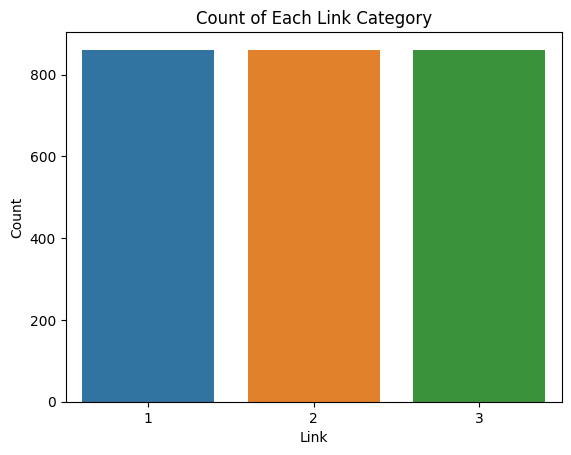

In [154]:
# Count the occurrences of each 'link' category
link_counts = new_final_df['link'].value_counts()

# Plot the count of each 'link' category
sns.barplot(x=link_counts.index, y=link_counts.values)

# Set the labels and title for the plot
plt.xlabel('Link')
plt.ylabel('Count')
plt.title('Count of Each Link Category')

# Show the plot
plt.show()

In [143]:
new_end_df

,mean_D,std_D,max_osnr_D,min_osnr_D,peak_to_peak_D,kurtosis_D,skewness_D,link
0,-0.249480,1.113478,2.010418,-2.468073,4.478491,-0.945739,-0.115725,1
1,-0.148076,1.161455,2.567329,-2.468073,5.035402,-0.548191,0.322044,1
2,-0.109324,1.139979,2.567329,-2.212822,4.780151,-0.550228,0.513353,1
3,-0.008848,1.089753,2.567329,-2.003981,4.571310,-0.383016,0.525119,1
4,0.114137,0.947823,2.567329,-2.003981,4.571310,0.219845,0.559972,1
...,...,...,...,...,...,...,...,...
2578,-0.496397,1.030900,1.817148,-2.066972,3.884120,-0.812917,0.292318,3
2579,-0.525796,1.013199,1.638978,-2.066972,3.705949,-0.990920,0.279540,3
2580,-0.424773,1.026198,1.692429,-1.942252,3.634681,-0.963879,0.266949,3
2581,-0.423526,1.043822,2.120038,-1.942252,4.062291,-0.825673,0.321851,3


Average Train accuracy:  0.9717987174974365
Average Train mse:  0.03483111675670712
Average Train precision:  0.9719065430657142
Average Train f1:  0.9717498559245838
Average Train duration:  7.605467891693115
Average Test accuracy: 0.9868387096774193
******************************************
Best Test accuracy: 0.9883870967741936
Best Test MSE: 0.015483870967741935
Best Test precision: 0.9884877105199528
Best Test recall: 0.9883821921338377
Best Test best f1: 0.9884176888866832


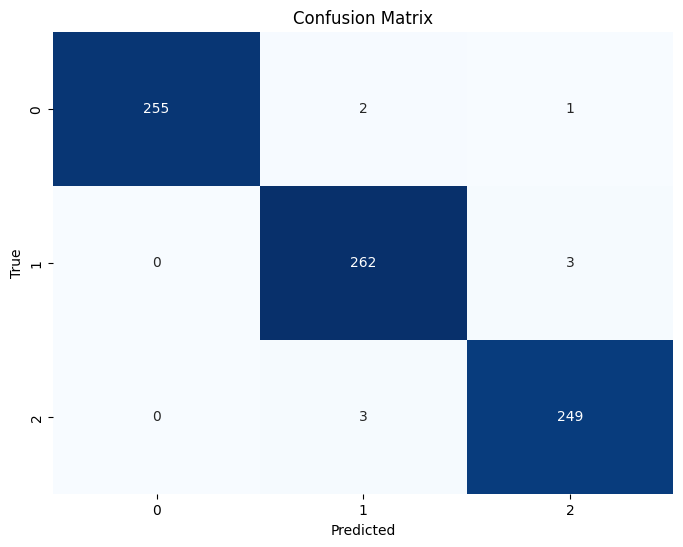

In [139]:
# Without Scaling and Test size 0.3 on window 100
model_3_wind_100 = xgb_classifier_w_kfold(5, new_final_df, False, True, 0.3)

Average Train accuracy:  0.881074669809155
Average Train mse:  0.2682756615295144
Average Train precision:  0.8811710289429536
Average Train f1:  0.8809939641274511
Average Train duration:  4.300648832321167
Average Test accuracy: 0.9024516129032257
******************************************
Best Test accuracy: 0.9096774193548387
Best Test MSE: 0.24129032258064517
Best Test precision: 0.9093574410647581
Best Test recall: 0.9091430614467034
Best Test best f1: 0.9091781819033639


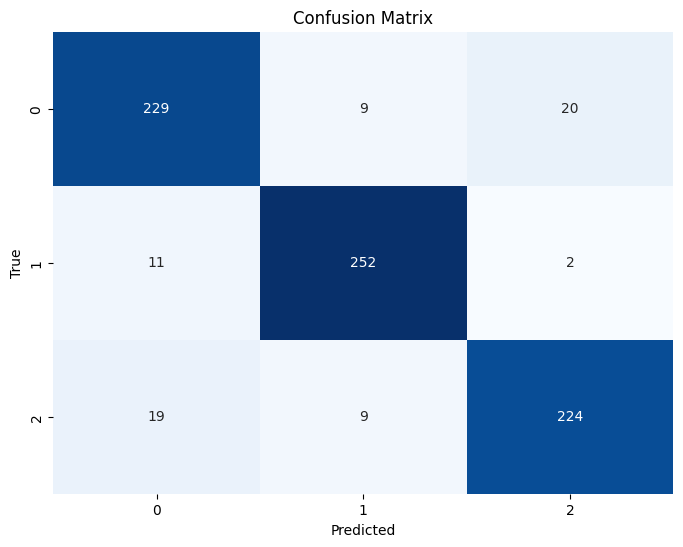

In [144]:
# Without Scaling and Test size 0.3 on window 100
model_3_partial_100 = xgb_classifier_w_kfold(5, new_end_df, True, True, 0.3)

##### 2.3.1.2 Logistic Regression

Average Train accuracy:  0.8882860684715569
Average Train mse:  0.14655729174637672
Average Train precision:  0.8892774847965244
Average Train f1:  0.8882779468600115
Average Train duration:  0.030955743789672852
Average Test accuracy: 0.9109677419354838
******************************************
Best Test accuracy: 0.9148387096774193
Best Test MSE: 0.0967741935483871
Best Test precision: 0.9155147746124895
Best Test recall: 0.9153112963775535
Best Test best f1: 0.915117322031418


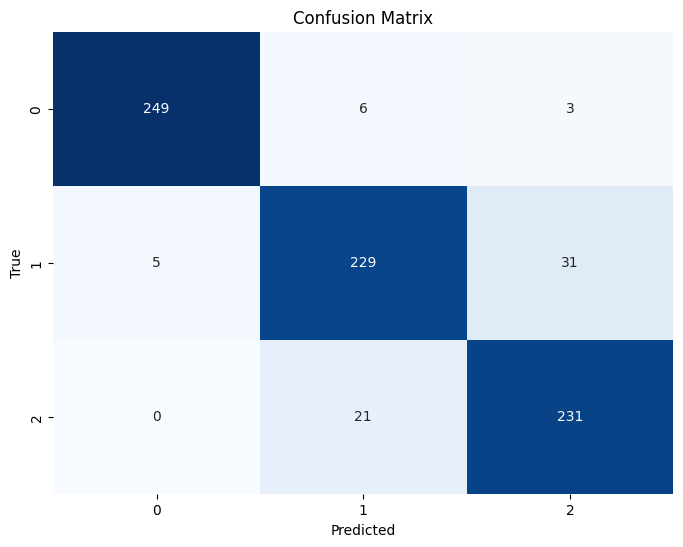

In [146]:
# With Scaling and Test Size 0.3 on full Dataset
logistic_classifier_w_kfold(5, new_final_df, True, 0.3)

Average Train accuracy:  0.632754319646164
Average Train mse:  0.8417792810027394
Average Train precision:  0.6368857364337254
Average Train f1:  0.6266368256543048
Average Train duration:  0.014719581604003907
Average Test accuracy: 0.6544516129032257
******************************************
Best Test accuracy: 0.6580645161290323
Best Test MSE: 0.8103225806451613
Best Test precision: 0.6640129218134333
Best Test recall: 0.6583741360617182
Best Test best f1: 0.6543811843555104


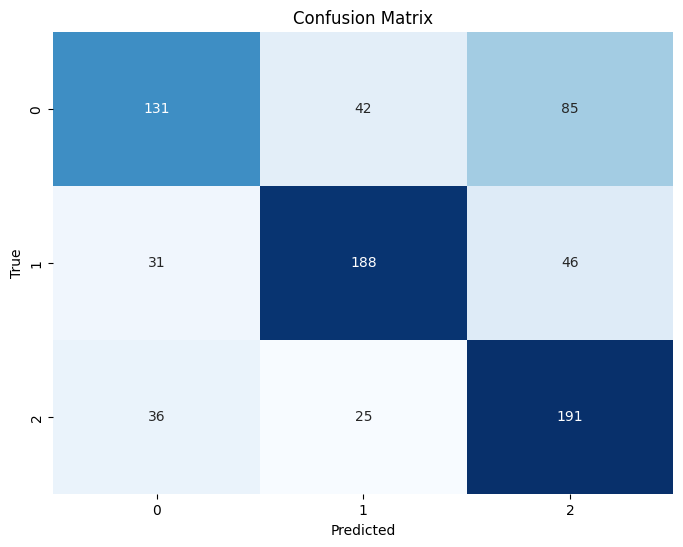

In [147]:
# With Scaling and Test Size 0.3 on partial Dataset
logistic_classifier_w_kfold(5, new_end_df, True, 0.3)

#### 2.3.2 In Time Split

##### 2.3.2.1 XGBoost

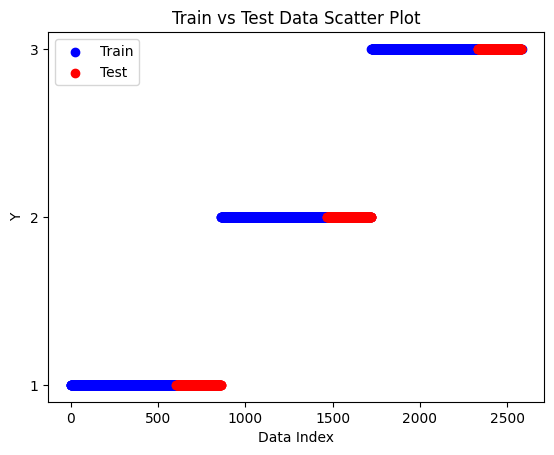

In [179]:
new_final_df.reset_index(drop=True, inplace=True)

train_data, test_data = in_time_spliter(new_final_df, 100, 25, 0.7)

X_train = train_data.drop('link', axis=1)
y_train = train_data['link']

X_test = test_data.drop('link', axis=1)
y_test = test_data['link']

scatter_plot_train_test(X_train, X_test, y_train, y_test)

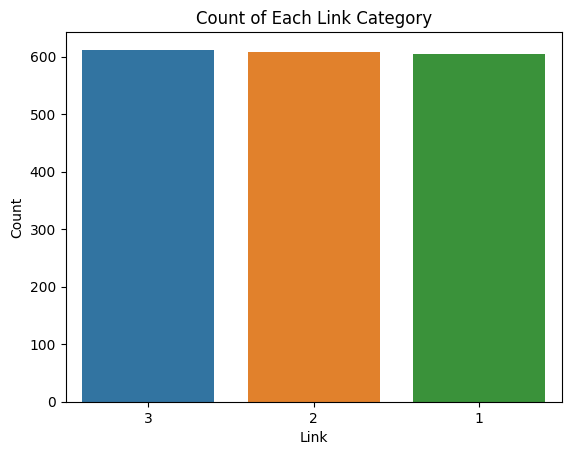

In [180]:
# Count the occurrences of each 'link' category
link_counts = train_data['link'].value_counts()

# Plot the count of each 'link' category
sns.barplot(x=link_counts.index, y=link_counts.values)

# Set the labels and title for the plot
plt.xlabel('Link')
plt.ylabel('Count')
plt.title('Count of Each Link Category')

# Show the plot
plt.show()

Average Train accuracy:  0.9846485021827487
Average Train mse:  0.02028300466656631
Average Train precision:  0.9847454796971571
Average Train f1:  0.984662362970943
Average Train duration:  10.61922836303711
Average Test accuracy: 0.8474308300395258
Best Test accuracy: 0.8603425559947299
Best Test MSE: 0.2028985507246377
Best Test precision: 0.8590620187603261
Best Test recall: 0.8593239992672946
Best Test best f1: 0.8576544094490273


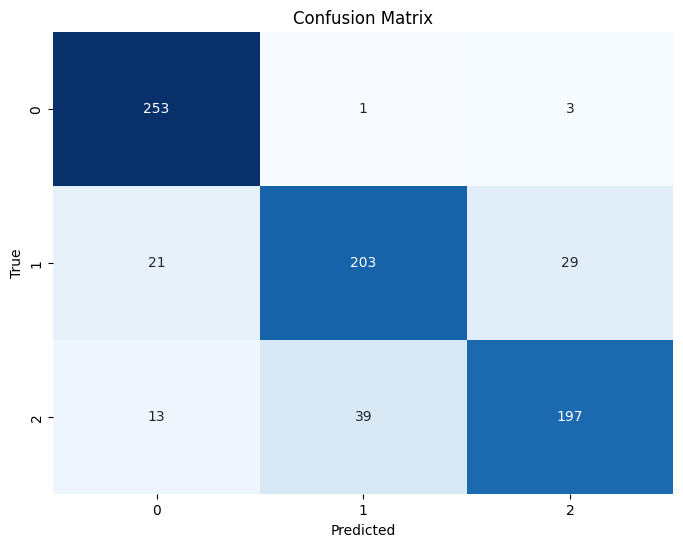

In [182]:
# Testing In_time split on window size
train_data, test_data = in_time_spliter(new_final_df, 100, 25, 0.7)

model_3_full_100 = in_time_xgb_classifier_w_kfold(5, train_data, test_data, True)

Average Train accuracy:  0.9089703447237694
Average Train mse:  0.19796025891916302
Average Train precision:  0.9094481279125333
Average Train f1:  0.908775403123282
Average Train duration:  3.5005778312683105
Average Test accuracy: 0.7422924901185771
Best Test accuracy: 0.7496706192358367
Best Test MSE: 0.6653491436100132
Best Test precision: 0.7517448930791829
Best Test recall: 0.7488479831467073
Best Test best f1: 0.7464733592026268


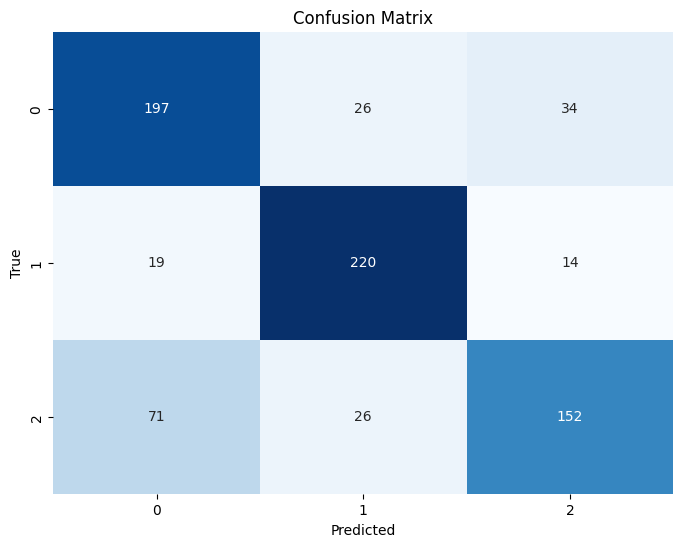

In [183]:
# Testing In_time split on window size
train_data, test_data = in_time_spliter(new_end_df, 100, 25, 0.7)

model_3_partial_100 = in_time_xgb_classifier_w_kfold(5, train_data, test_data, True)

##### 2.3.2.2 Logistic Regression

Average Train accuracy:  0.9122775854282704
Average Train mse:  0.1288544332379949
Average Train precision:  0.9134429682826128
Average Train f1:  0.9124055863050264
Average Train duration:  0.04812026023864746
Average Test accuracy: 0.8281949934123848
******************************************
Best Test accuracy: 0.8379446640316206
Best Test MSE: 0.22134387351778656
Best Test precision: 0.837256235833317
Best Test recall: 0.8367521752368873
Best Test best f1: 0.8360619326191312


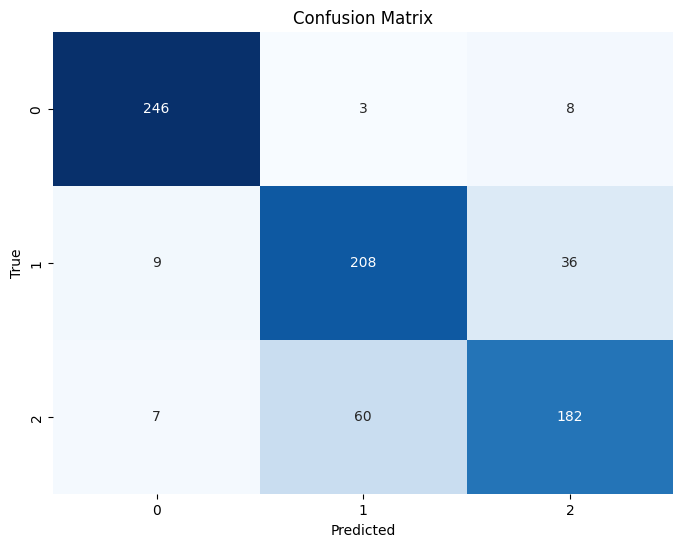

In [184]:
# Testing In_time split on window size 10 and test size 0.3 with scaling
train_data, test_data = in_time_spliter(new_final_df, 100, 25, 0.7)

# Reset index
train_data.reset_index(drop=True, inplace=True)
test_data.reset_index(drop=True, inplace=True)

# Scaling
scaler = StandardScaler()

# Train set
X_train = train_data.drop('link', axis=1)
y_train = train_data['link']
X_train_scaled = scaler.fit_transform(X_train)
train_data_scaled = pd.DataFrame(X_train_scaled, columns=X_train.columns)
train_data_scaled['link'] = y_train
train_data = train_data_scaled

# Test set
X_test = test_data.drop('link', axis=1)
y_test = test_data['link']
X_test_scaled = scaler.transform(X_test)
test_data_scaled = pd.DataFrame(X_test_scaled, columns=X_test.columns)
test_data_scaled['link'] = y_test
test_data = test_data_scaled


lsmodel_3_full_100 = in_time_logistic_classifier_w_kfold(5, train_data, test_data)

Average Train accuracy:  0.5986768026494055
Average Train mse:  0.9079271413517989
Average Train precision:  0.601360264840421
Average Train f1:  0.5929508008595654
Average Train duration:  0.07667975425720215
Average Test accuracy: 0.7238471673254281
******************************************
Best Test accuracy: 0.7364953886693018
Best Test MSE: 0.6745718050065876
Best Test precision: 0.7334197965776913
Best Test recall: 0.7374421325356177
Best Test best f1: 0.733479374700869


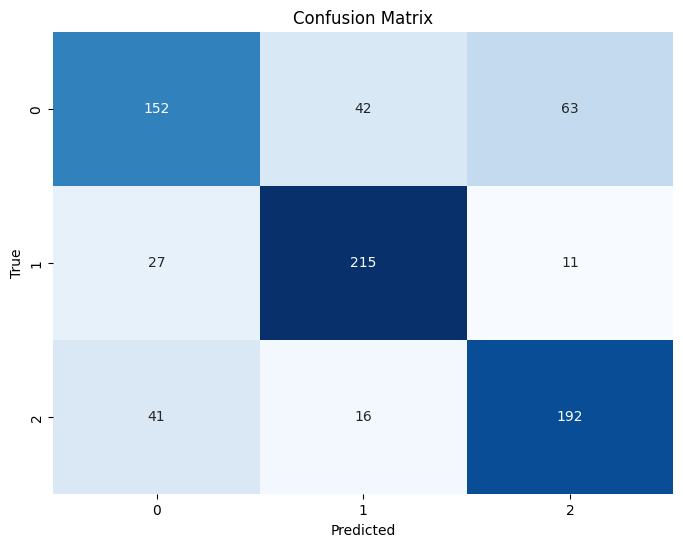

In [185]:
# Testing In_time split on window size 10 and test size 0.3 with scaling
train_data, test_data = in_time_spliter(new_end_df, 100, 25, 0.7)

# Reset index
train_data.reset_index(drop=True, inplace=True)
test_data.reset_index(drop=True, inplace=True)

# Scaling
scaler = StandardScaler()

# Train set
X_train = train_data.drop('link', axis=1)
y_train = train_data['link']
X_train_scaled = scaler.fit_transform(X_train)
train_data_scaled = pd.DataFrame(X_train_scaled, columns=X_train.columns)
train_data_scaled['link'] = y_train
train_data = train_data_scaled

# Test set
X_test = test_data.drop('link', axis=1)
y_test = test_data['link']
X_test_scaled = scaler.transform(X_test)
test_data_scaled = pd.DataFrame(X_test_scaled, columns=X_test.columns)
test_data_scaled['link'] = y_test
test_data = test_data_scaled


lsmodel_3_full_100 = in_time_logistic_classifier_w_kfold(5, train_data, test_data)

## 3. Explainable AI

In [189]:
!pip install shap

In [190]:
import shap
import shap.plots

### 3.1 Random Splits

#### 3.1.1 XGBoost

For Dataset with full datas

Average Train accuracy:  0.9721885458555913
Average Test accuracy: 0.9729827089337176
******************************************
Best Test accuracy: 0.9747324001646768


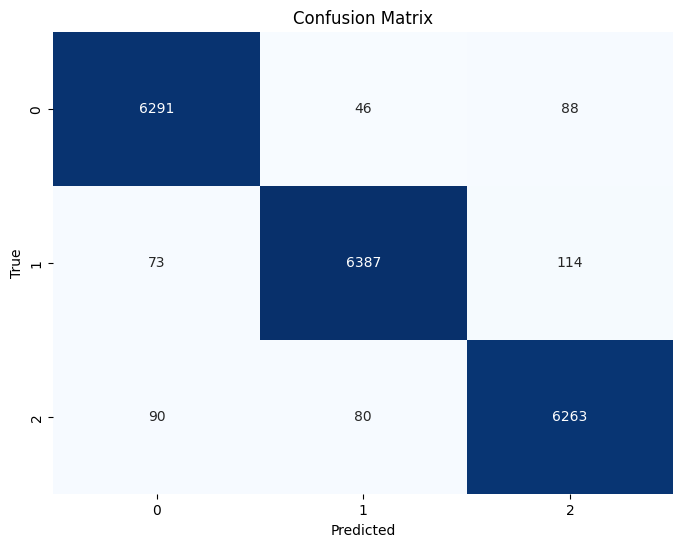

In [233]:
df = final_df.copy()

scaler = StandardScaler()
X_scaled = scaler.fit_transform(df.drop('link', axis=1))
df_scaled = pd.DataFrame(X_scaled, columns=df.columns[:-1])
df_scaled['link'] = df['link']
df = df_scaled

# Split the data into features (X) and target variable (y)
X = df.drop('link', axis=1)
y = df['link']

label_encoder = LabelEncoder()
y = label_encoder.fit_transform(y)

# Split data into initial train and test sets
X_train_initial, X_test_initial, y_train_initial, y_test_initial = train_test_split(X, y, test_size=0.3, random_state=42)

# Initialize the StratifiedKFold for hypermeter optimization
# Outer cross validation of 5 folds
outer_skf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

# Initialize a list to store the accuracies
accuracies = []
train_accuracies = []

# Choosing the best model to predict
best_model = None
best_score = 0.0

# Perform k-fold cross-validation
for train_index, test_index in outer_skf.split(X_train_initial, y_train_initial):
  X_train, X_test = X_train_initial.iloc[train_index], X_train_initial.iloc[test_index]
  y_train, y_test = y_train_initial[train_index], y_train_initial[test_index]

  # Hyperparam optimization
  model = xgb.XGBClassifier(objective='multi:softmax', num_class=3)

  model.fit(X_train, y_train)

  # Checking the best grid for training data
  y_pred = model.predict(X_test)

  # Metrics for training
  train_accuracy = accuracy_score(y_test, y_pred)

  # Checking the grid for test
  y_pred = model.predict(X_test_initial)
  accuracy = accuracy_score(y_test_initial, y_pred)

  # Saving the best model for more test
  if accuracy > best_score:
      best_score = accuracy
      best_model = model


  accuracies.append(accuracy)
  train_accuracies.append(train_accuracy)



# Compute the average accuracy across all folds
average_accuracy = np.mean(accuracies)
average_train_accuracy = np.mean(train_accuracies)


print("Average Train accuracy: ", average_train_accuracy)
print("Average Test accuracy:", average_accuracy)

print("******************************************")

print("Best Test accuracy:", best_score)

# drawing confusing matrix
y_pred_best = best_model.predict(X_test_initial)
confusion_best = confusion_matrix(y_test_initial, y_pred_best)
plt.figure(figsize=(8, 6))
sns.heatmap(confusion_best, annot=True, cmap='Blues', fmt='d', cbar=False)
plt.title('Confusion Matrix')
plt.xlabel('Predicted')
plt.ylabel('True')
plt.show()

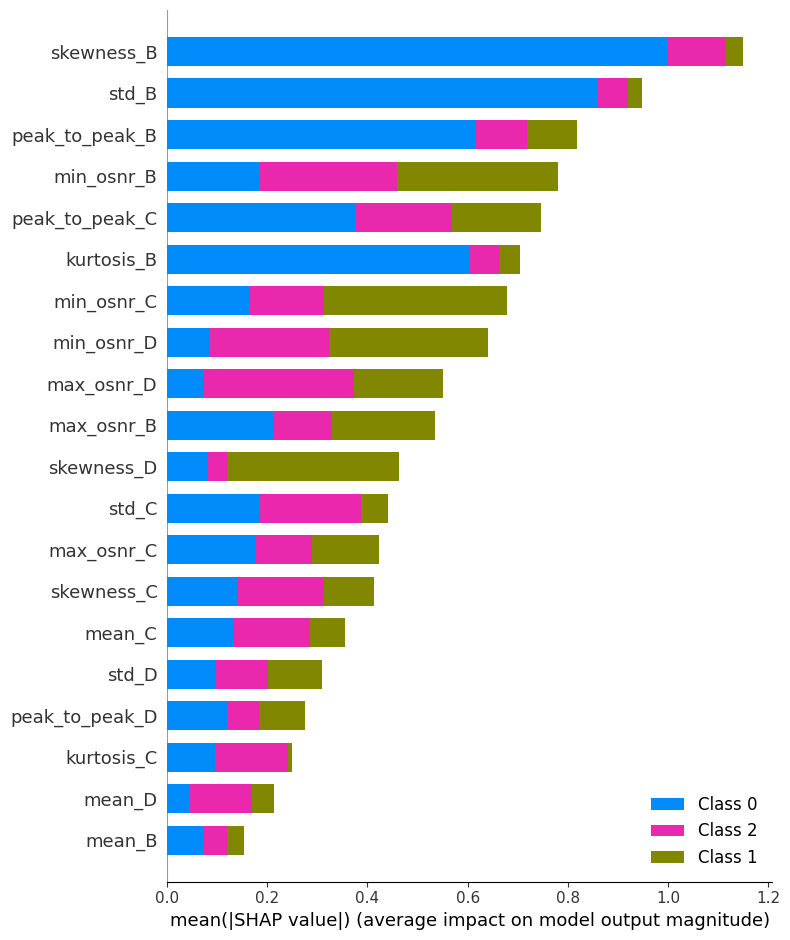

In [234]:
# Initialize the explainer
explainer = shap.TreeExplainer(best_model)

# Generate SHAP values for the test data
shap_values = explainer.shap_values(X_test_initial)

# Global summary plot
shap.summary_plot(shap_values, X_test_initial)

Link  1


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


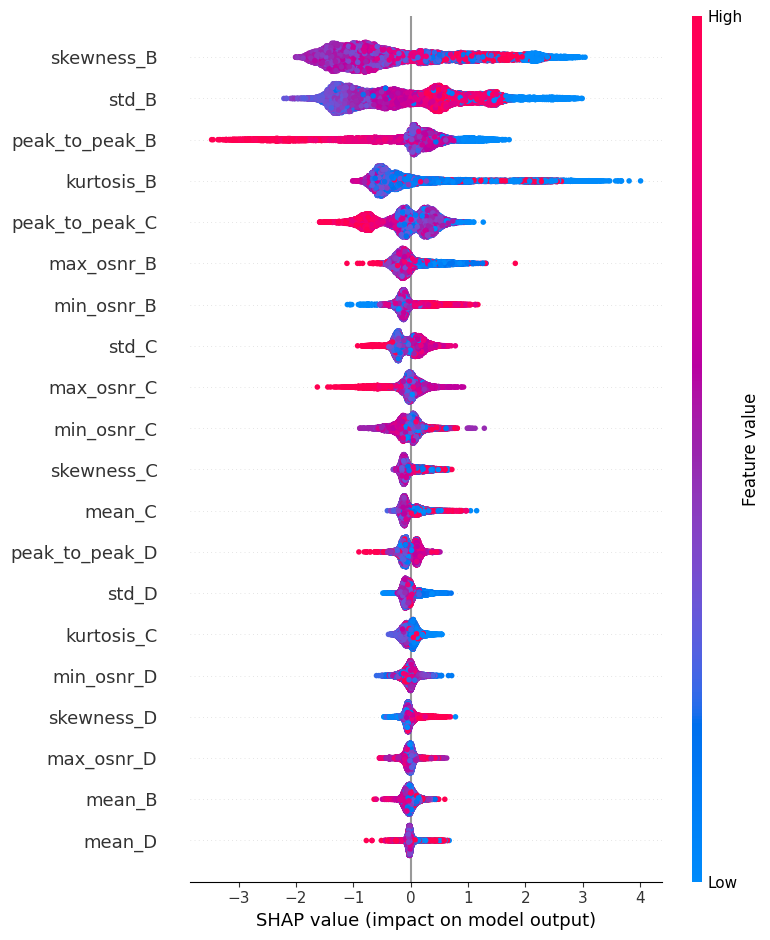

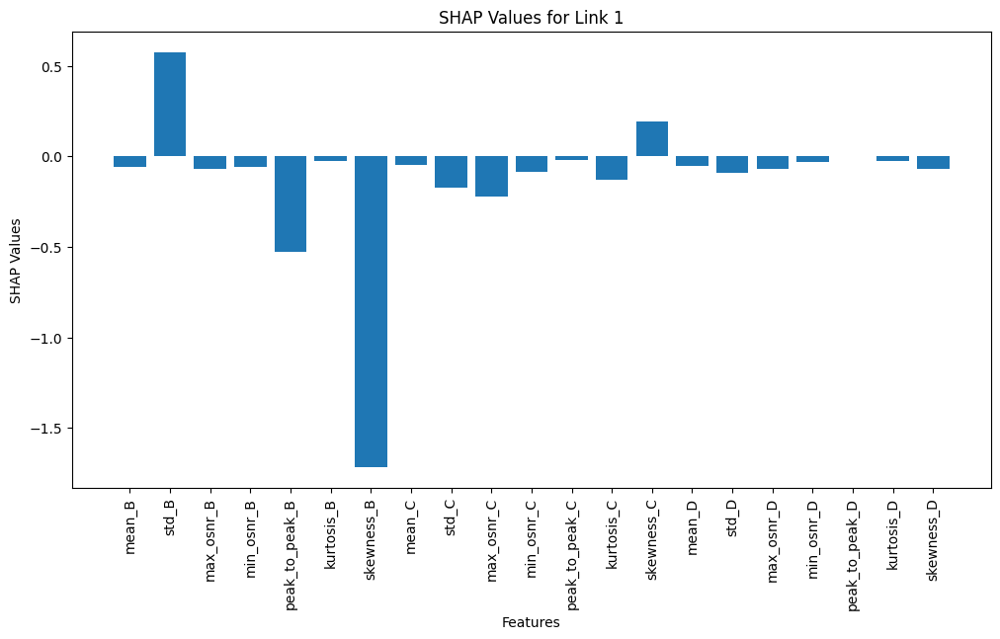

Link  2


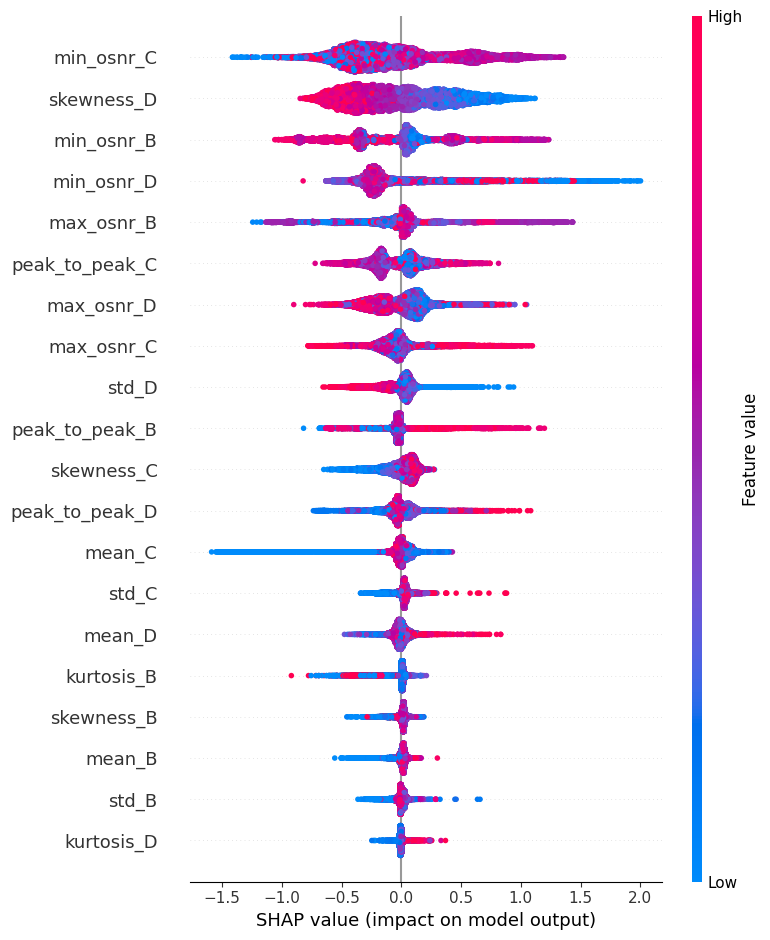

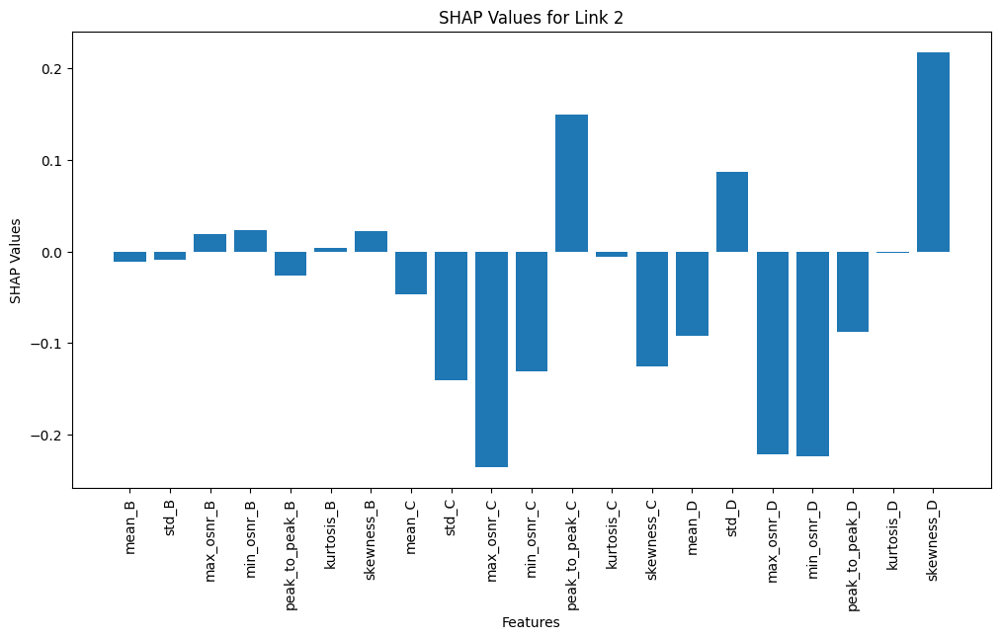

Link  3


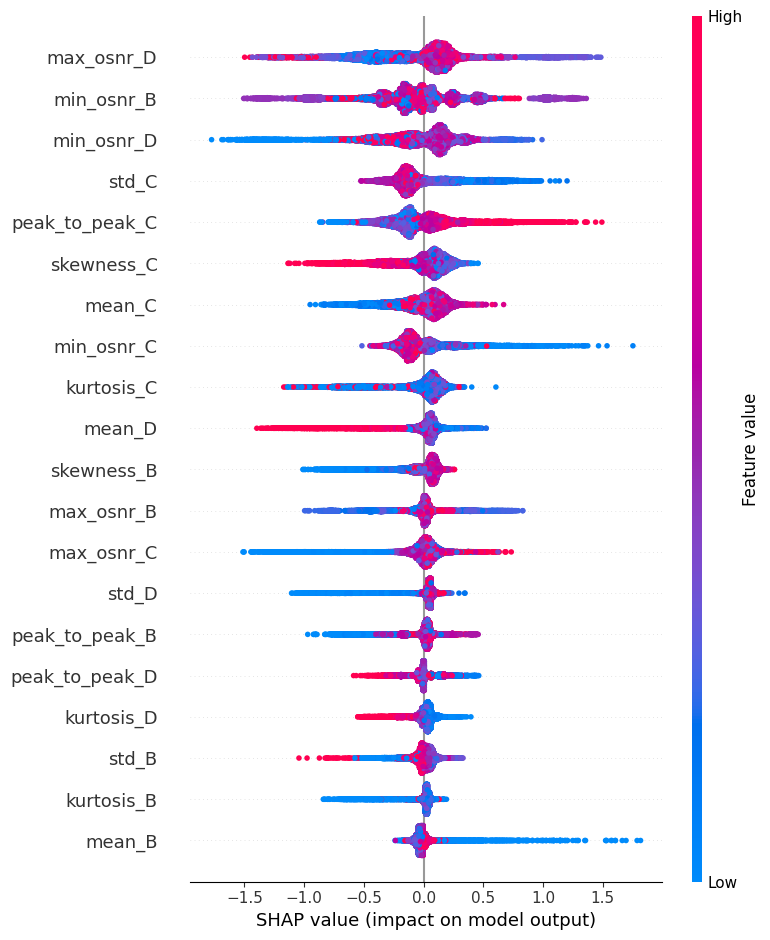

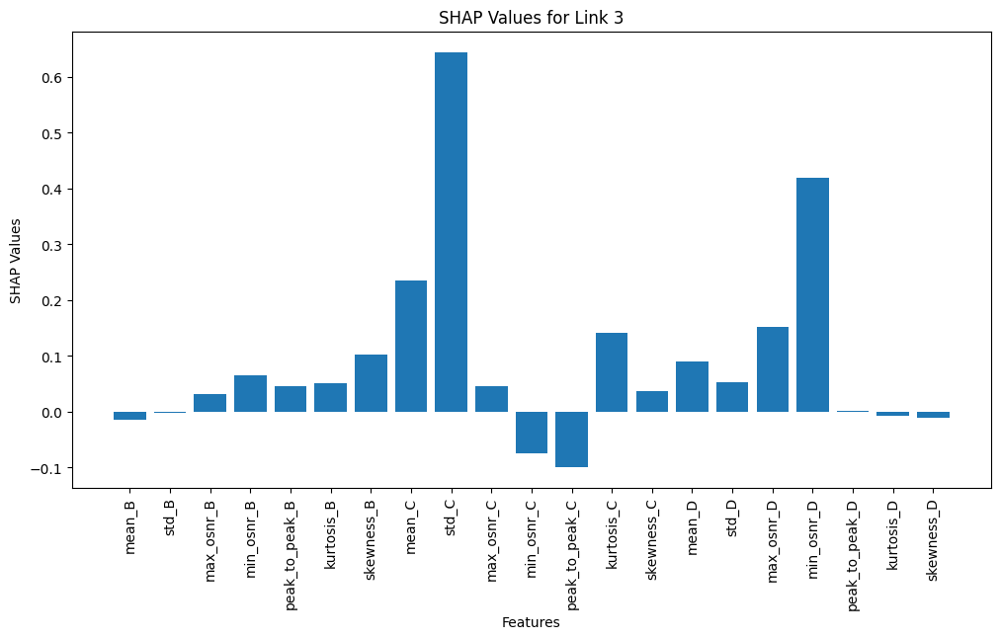

In [235]:
# Separate plots for each label
for label_idx in range(3):
    print("Link ", label_idx + 1)
    # Summary plot
    shap.summary_plot(shap_values[label_idx], X_test_initial, class_names=["1", "2", "3"], show=False)


    # Bar plot for a specific instance (e.g., instance at index 0)
    plt.figure(figsize=(12, 6))
    shap_values_label = shap_values[label_idx][0]
    plt.bar(range(len(shap_values_label)), shap_values_label)
    plt.xticks(range(len(shap_values_label)), X_test_initial.columns, rotation=90, ha='center')
    plt.xlabel("Features")
    plt.ylabel("SHAP Values")
    plt.title("SHAP Values for Link " + str(label_idx + 1))
    plt.show()

Link  1


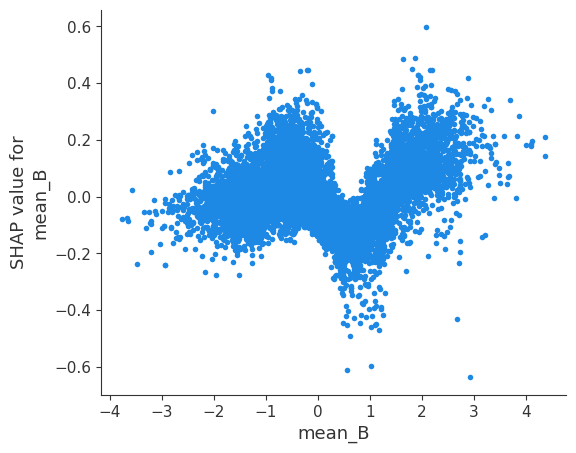

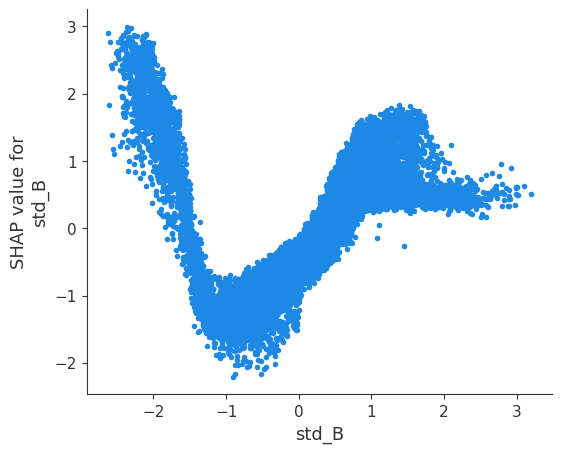

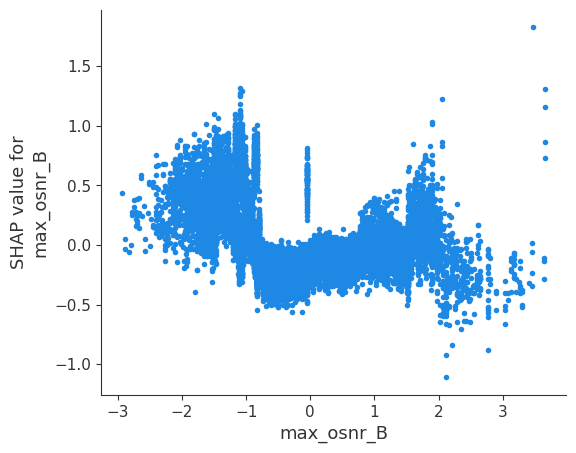

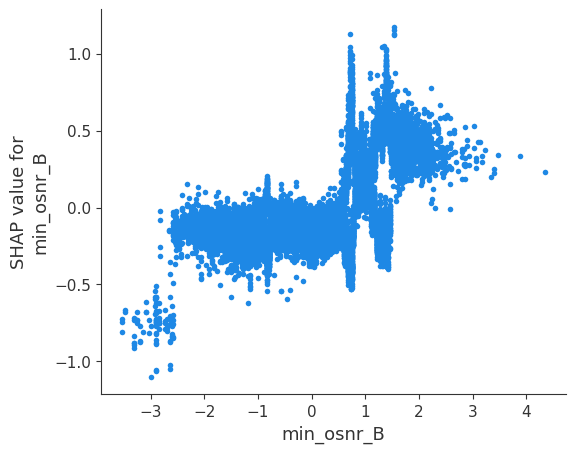

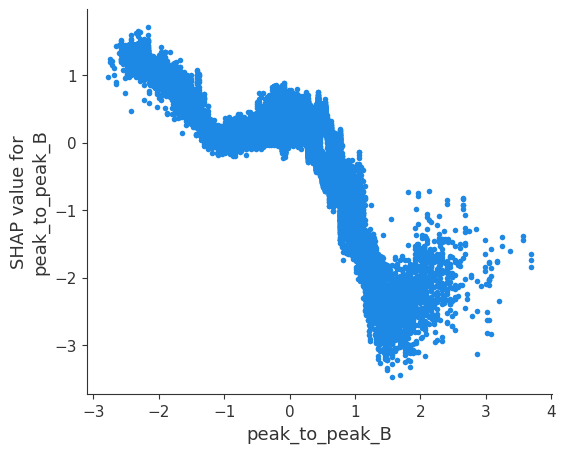

...

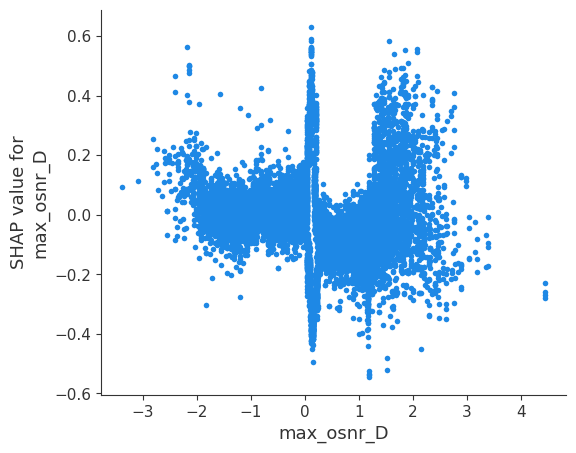

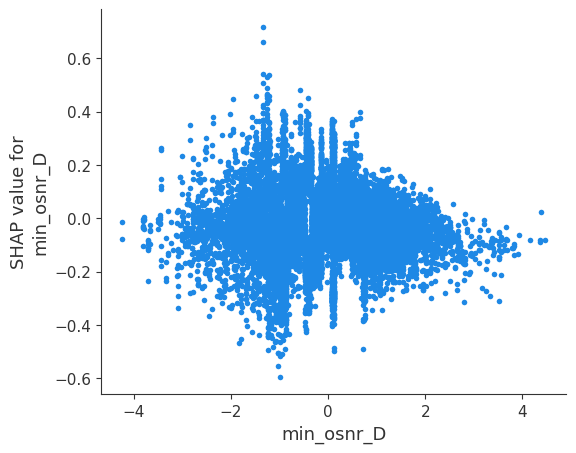

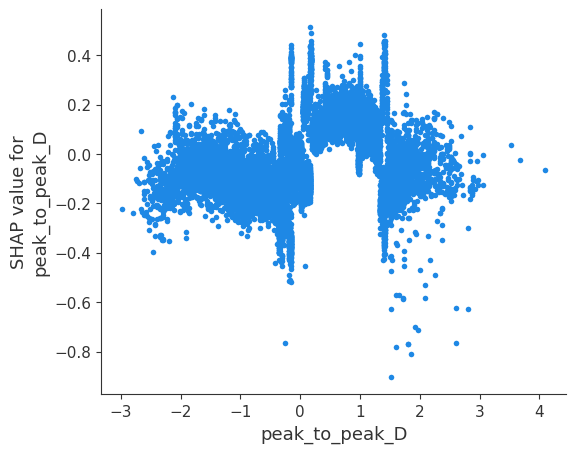

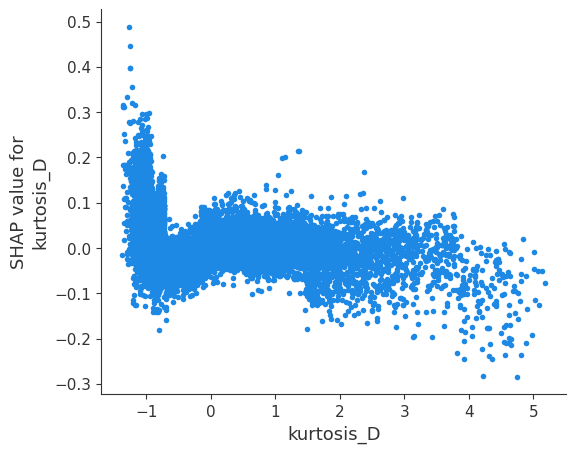

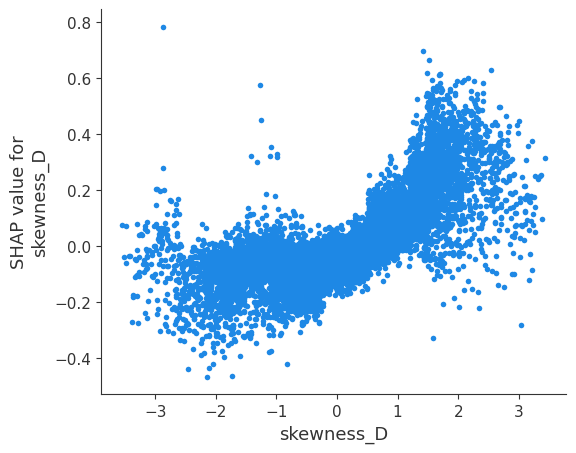

Link  2


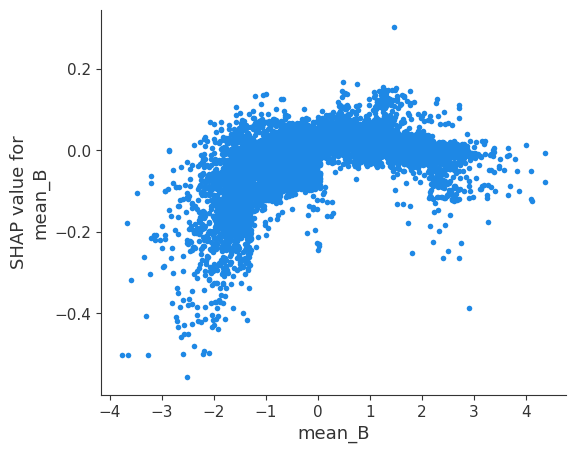

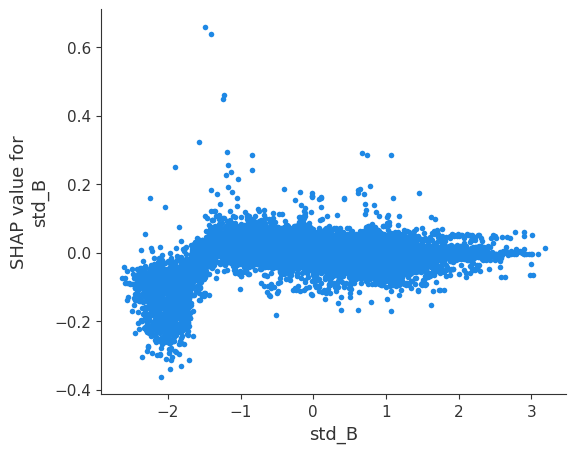

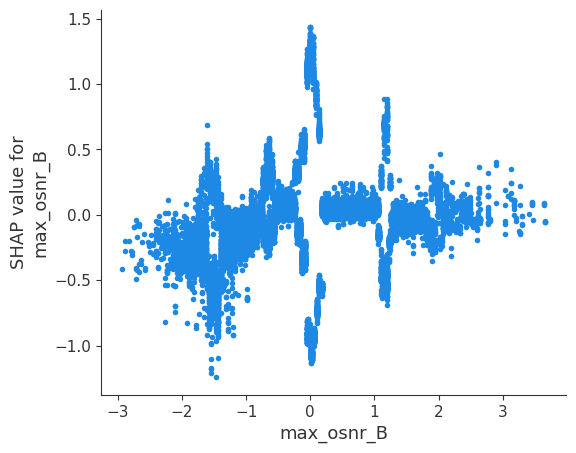

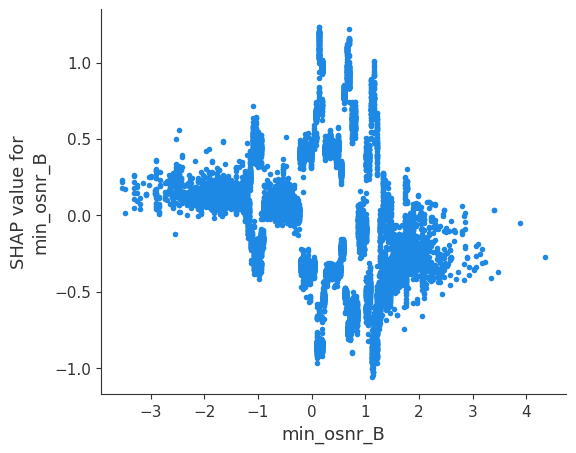

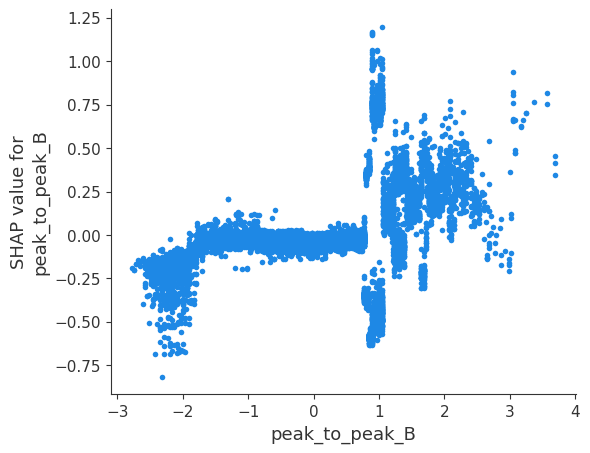

...

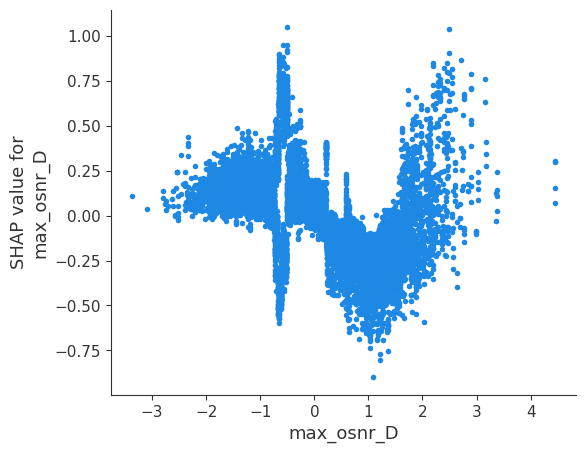

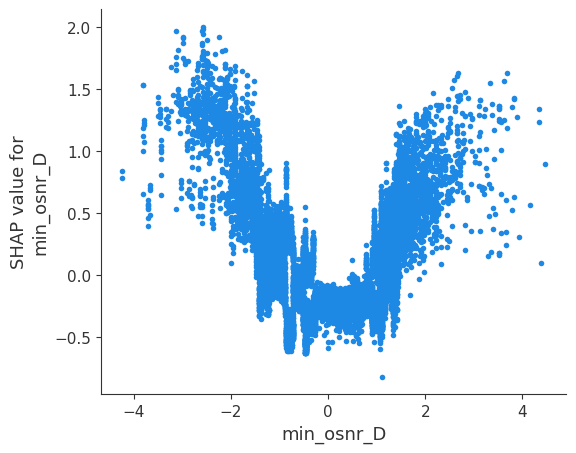

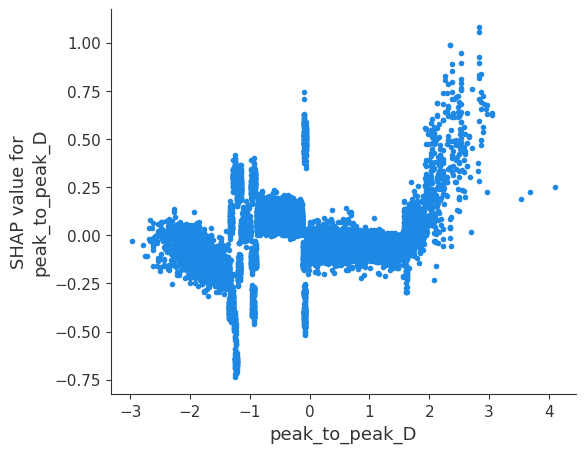

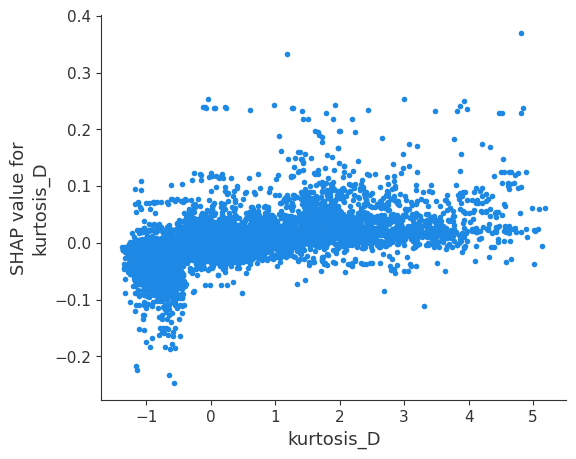

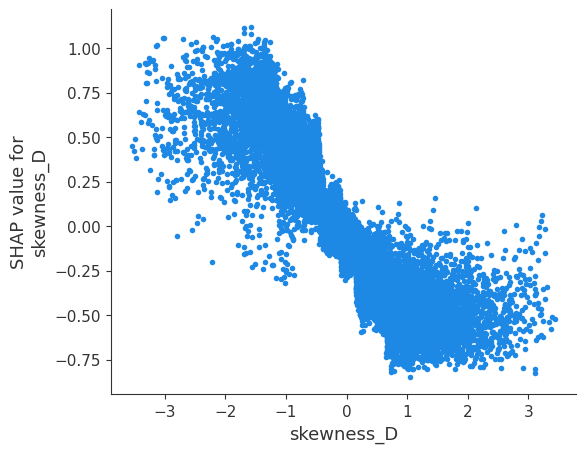

Link  3


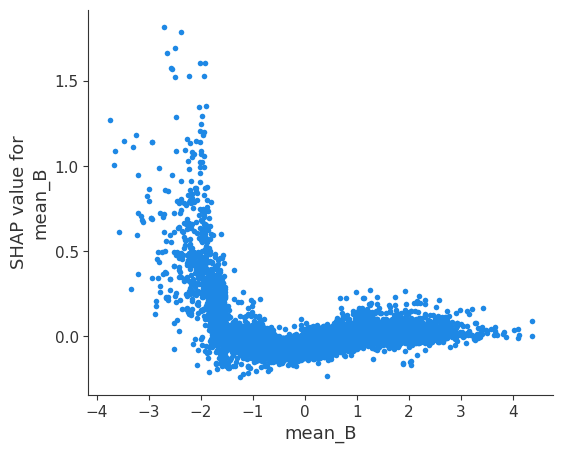

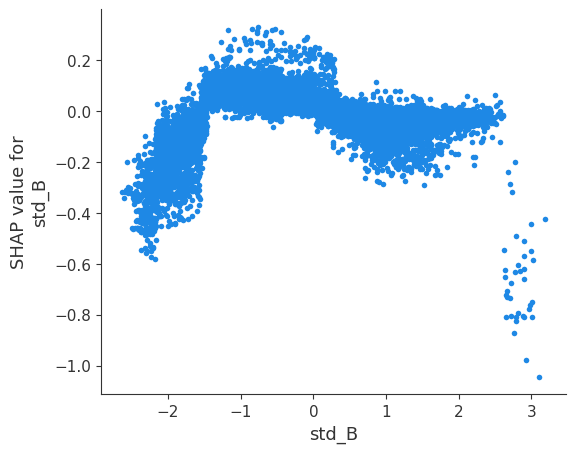

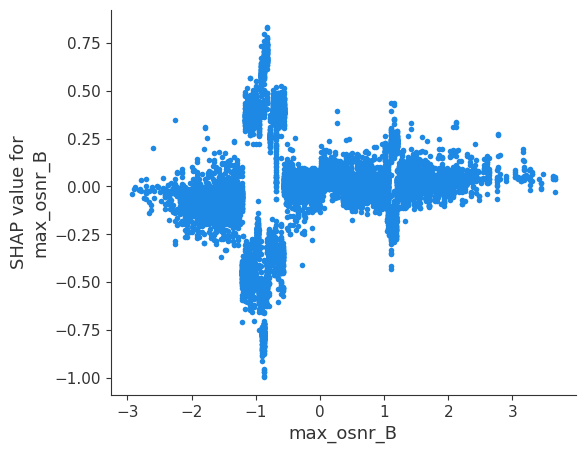

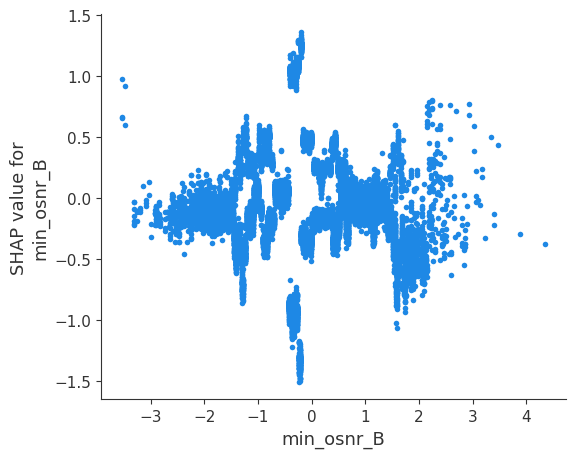

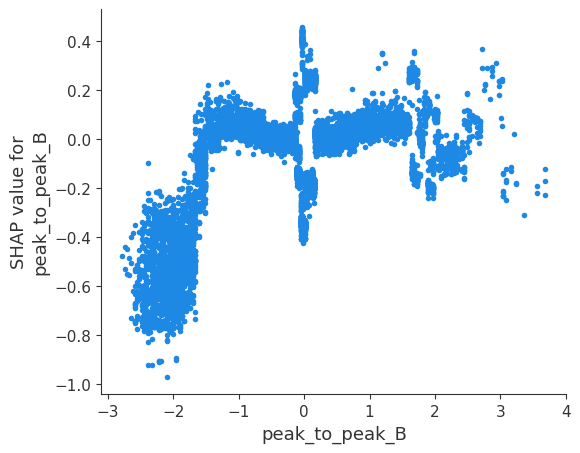

...

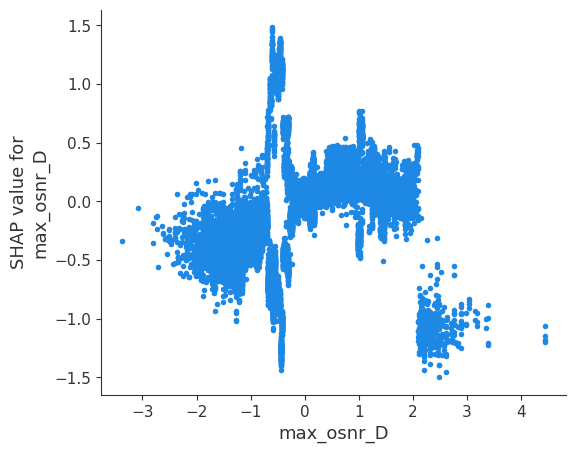

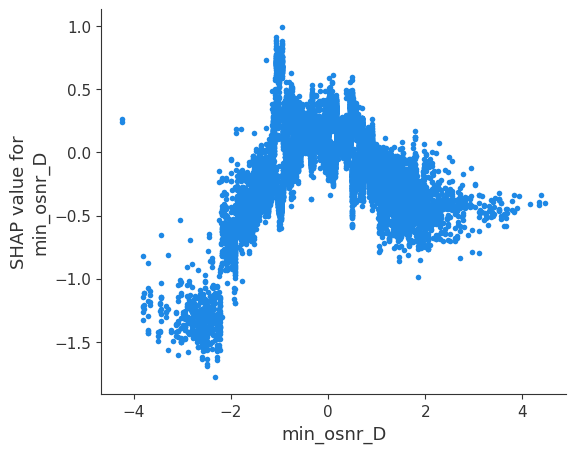

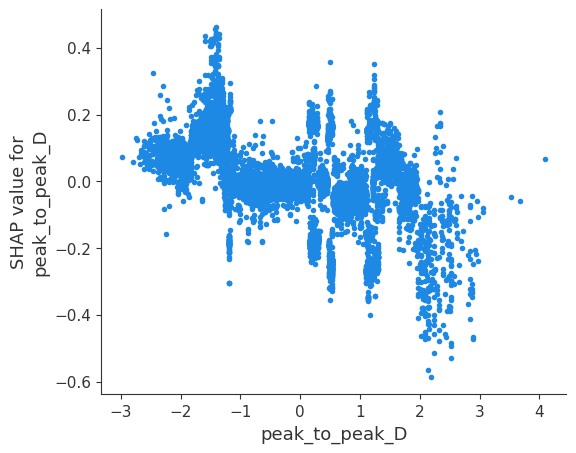

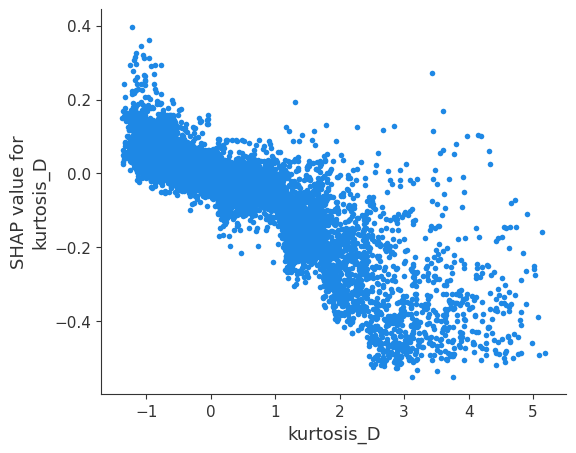

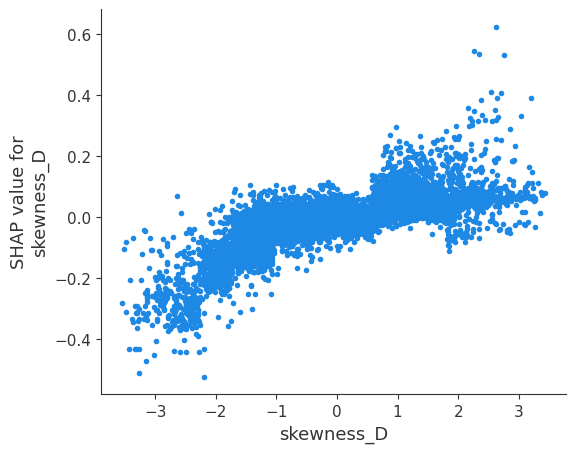

In [236]:
for label_idx in range(3):
  print("Link ", label_idx + 1)
  for feature_idx, feature_name in enumerate(X.columns):
    shap.dependence_plot(feature_idx, shap_values[label_idx], X_test_initial, interaction_index=None, feature_names=X_test_initial.columns)

For Partial Dataset

Average Train accuracy:  0.9712622577005201
Average Test accuracy: 0.9719946480032935
******************************************
Best Test accuracy: 0.9732400164676822


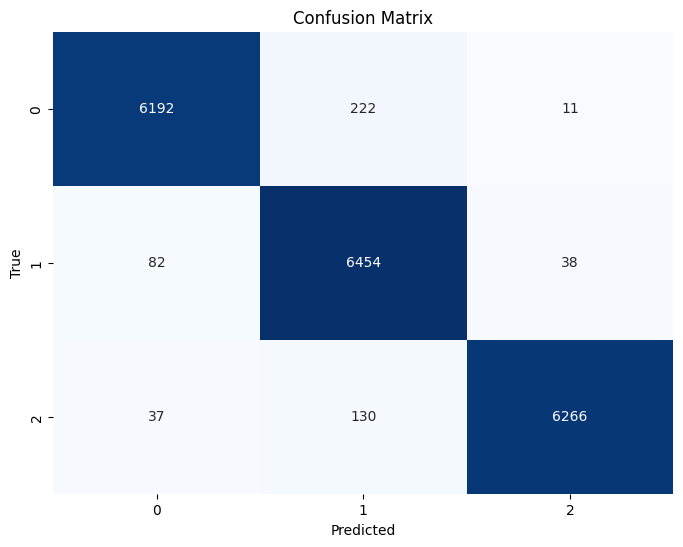

In [237]:
df = end_df.copy()

scaler = StandardScaler()
X_scaled = scaler.fit_transform(df.drop('link', axis=1))
df_scaled = pd.DataFrame(X_scaled, columns=df.columns[:-1])
df_scaled['link'] = df['link']
df = df_scaled

# Split the data into features (X) and target variable (y)
X = df.drop('link', axis=1)
y = df['link']

label_encoder = LabelEncoder()
y = label_encoder.fit_transform(y)

# Split data into initial train and test sets
X_train_initial, X_test_initial, y_train_initial, y_test_initial = train_test_split(X, y, test_size=0.3, random_state=42)

# Initialize the StratifiedKFold for hypermeter optimization
# Outer cross validation of 5 folds
outer_skf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

# Initialize a list to store the accuracies
accuracies = []
train_accuracies = []

# Choosing the best model to predict
best_model = None
best_score = 0.0

# Perform k-fold cross-validation
for train_index, test_index in outer_skf.split(X_train_initial, y_train_initial):
  X_train, X_test = X_train_initial.iloc[train_index], X_train_initial.iloc[test_index]
  y_train, y_test = y_train_initial[train_index], y_train_initial[test_index]

  # Hyperparam optimization
  model = xgb.XGBClassifier(objective='multi:softmax', num_class=3)

  model.fit(X_train, y_train)

  # Checking the best grid for training data
  y_pred = model.predict(X_test)

  # Metrics for training
  train_accuracy = accuracy_score(y_test, y_pred)

  # Checking the grid for test
  y_pred = model.predict(X_test_initial)
  accuracy = accuracy_score(y_test_initial, y_pred)

  # Saving the best model for more test
  if accuracy > best_score:
      best_score = accuracy
      best_model = model


  accuracies.append(accuracy)
  train_accuracies.append(train_accuracy)



# Compute the average accuracy across all folds
average_accuracy = np.mean(accuracies)
average_train_accuracy = np.mean(train_accuracies)


print("Average Train accuracy: ", average_train_accuracy)
print("Average Test accuracy:", average_accuracy)

print("******************************************")

print("Best Test accuracy:", best_score)

# drawing confusing matrix
y_pred_best = best_model.predict(X_test_initial)
confusion_best = confusion_matrix(y_test_initial, y_pred_best)
plt.figure(figsize=(8, 6))
sns.heatmap(confusion_best, annot=True, cmap='Blues', fmt='d', cbar=False)
plt.title('Confusion Matrix')
plt.xlabel('Predicted')
plt.ylabel('True')
plt.show()

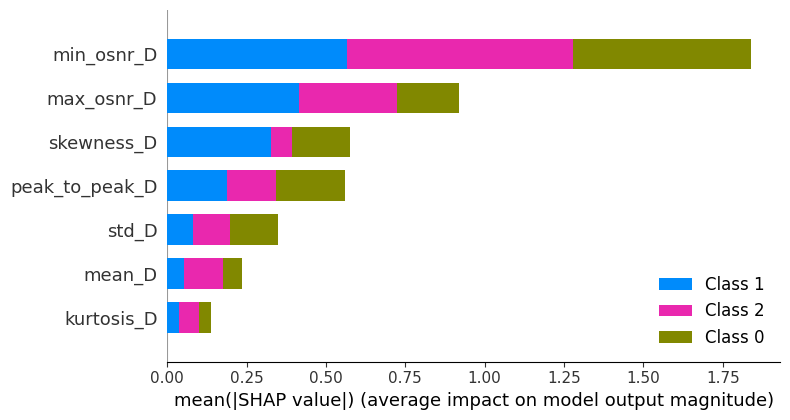

In [238]:
# Initialize the explainer
explainer = shap.TreeExplainer(best_model)

# Generate SHAP values for the test data
shap_values = explainer.shap_values(X_test_initial)

# Global summary plot
shap.summary_plot(shap_values, X_test_initial)

Link  1


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


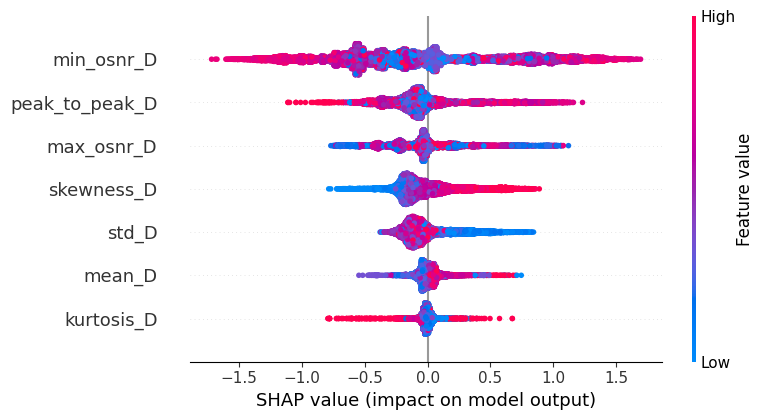

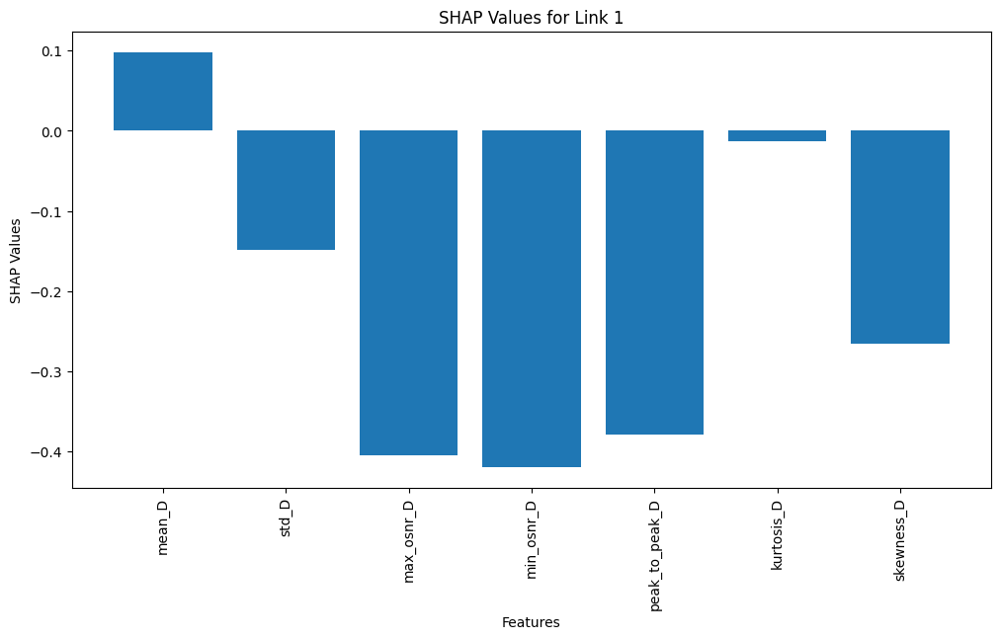

Link  2


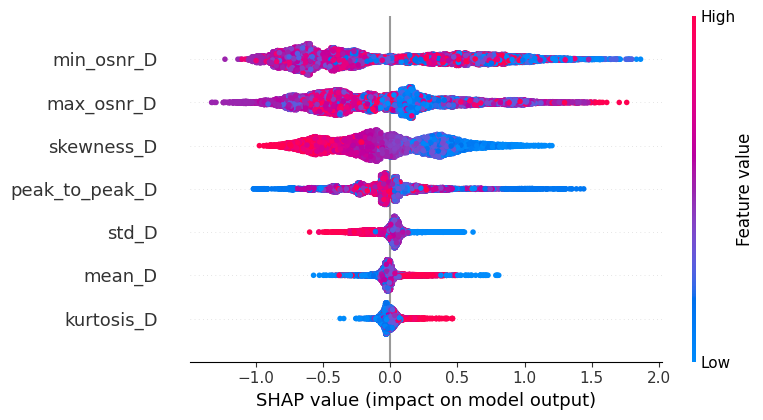

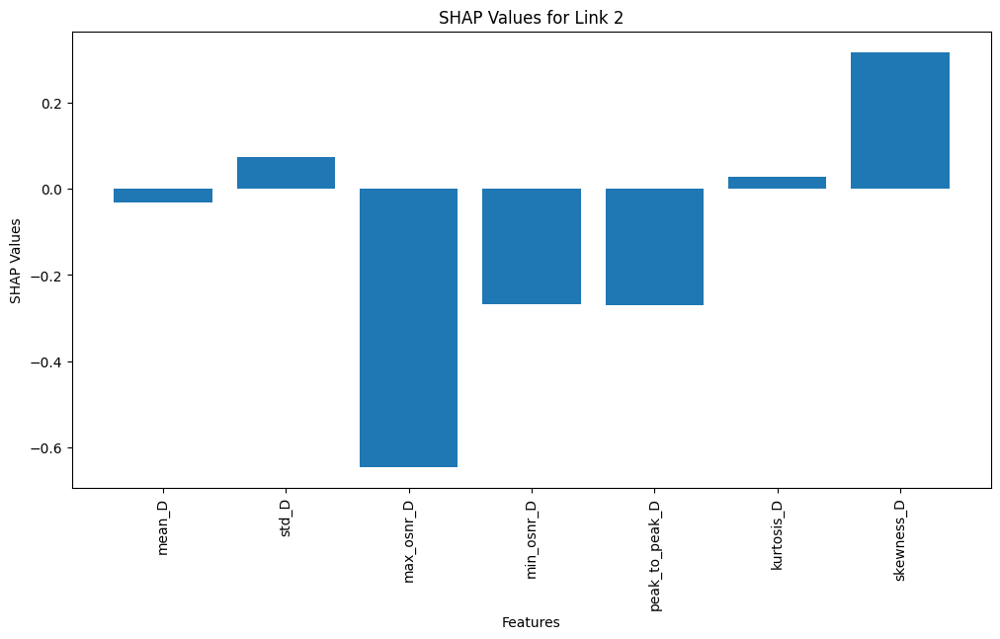

Link  3


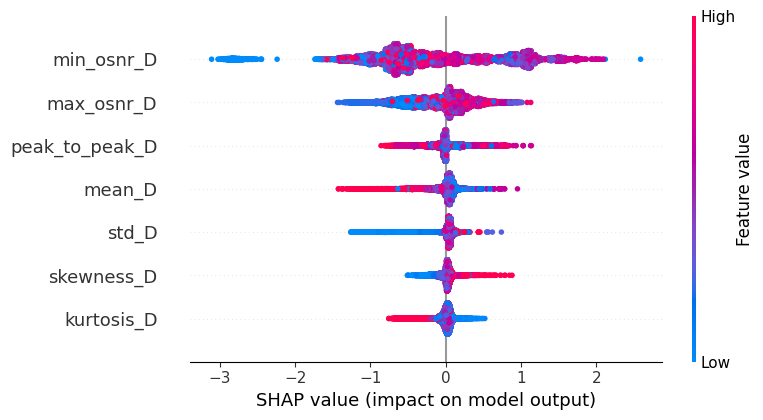

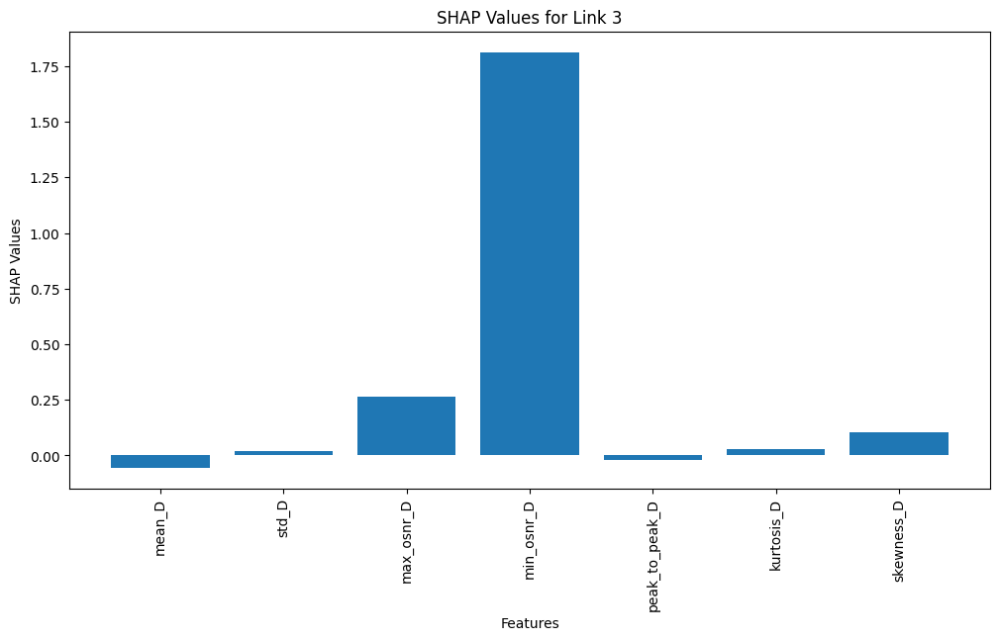

In [239]:
# Separate plots for each label
for label_idx in range(3):
    print("Link ", label_idx + 1)
    # Summary plot
    shap.summary_plot(shap_values[label_idx], X_test_initial, class_names=["1", "2", "3"], show=False)


    # Bar plot for a specific instance (e.g., instance at index 0)
    plt.figure(figsize=(12, 6))
    shap_values_label = shap_values[label_idx][0]
    plt.bar(range(len(shap_values_label)), shap_values_label)
    plt.xticks(range(len(shap_values_label)), X_test_initial.columns, rotation=90, ha='center')
    plt.xlabel("Features")
    plt.ylabel("SHAP Values")
    plt.title("SHAP Values for Link " + str(label_idx + 1))
    plt.show()

Link  1


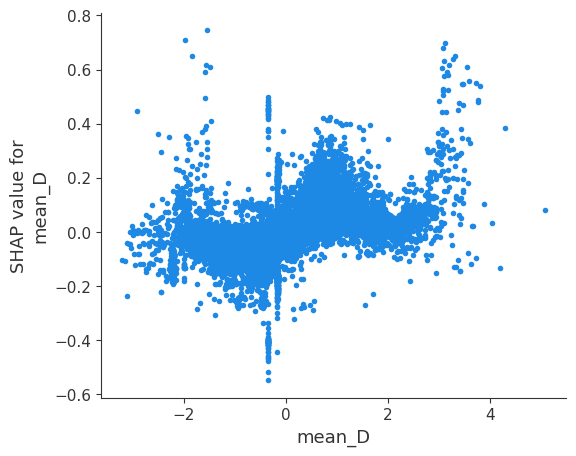

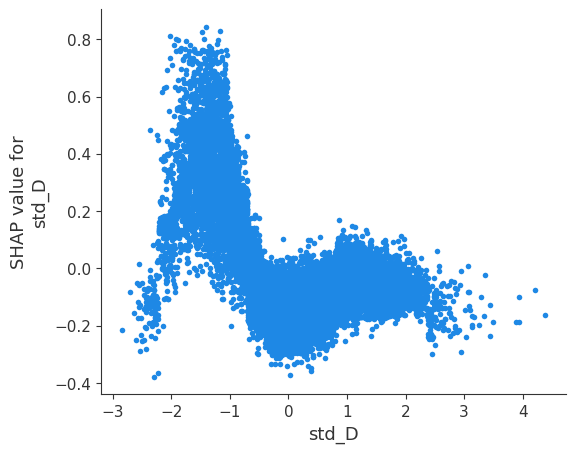

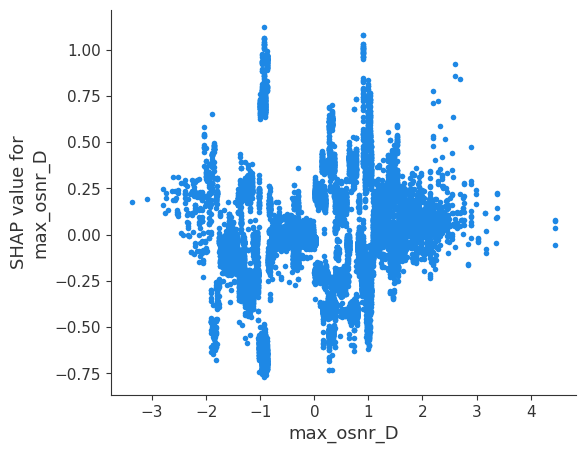

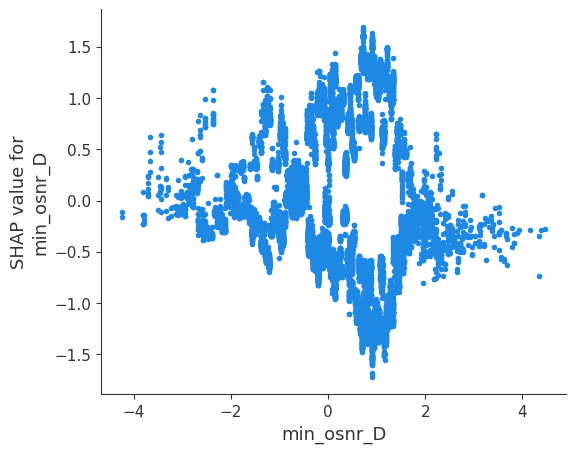

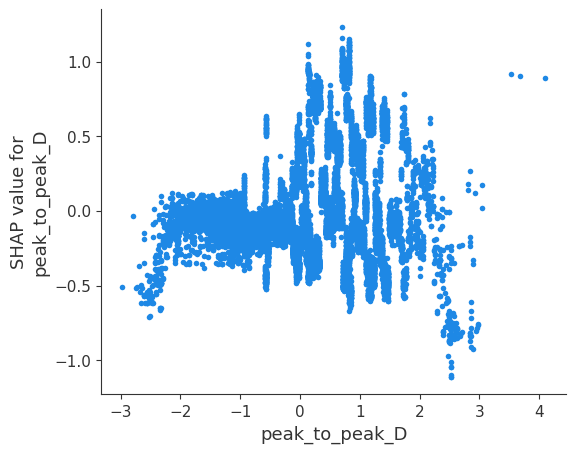

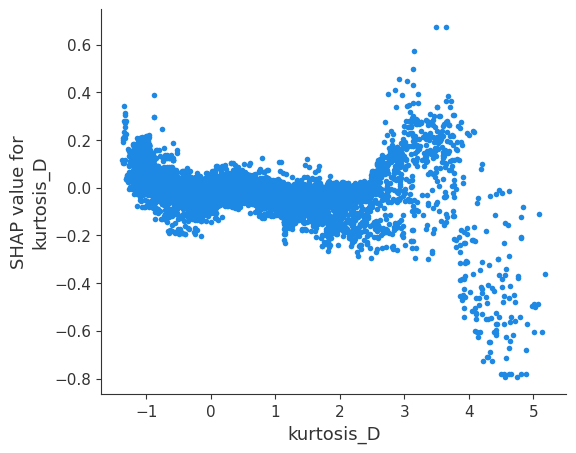

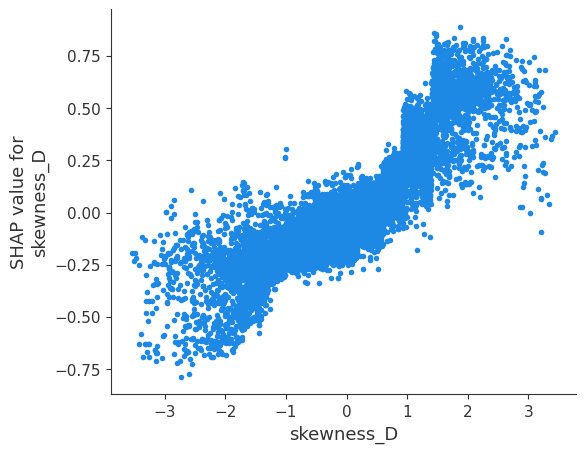

Link  2


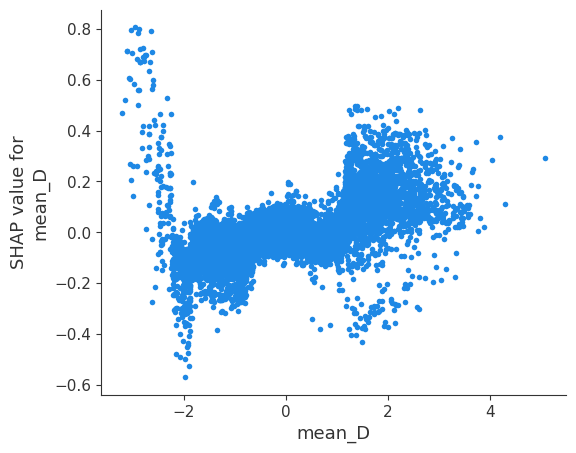

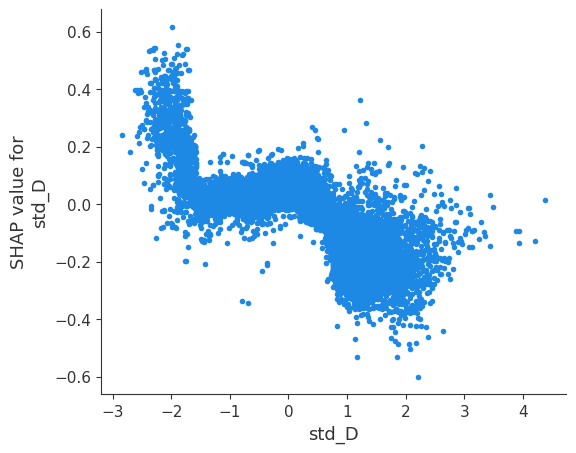

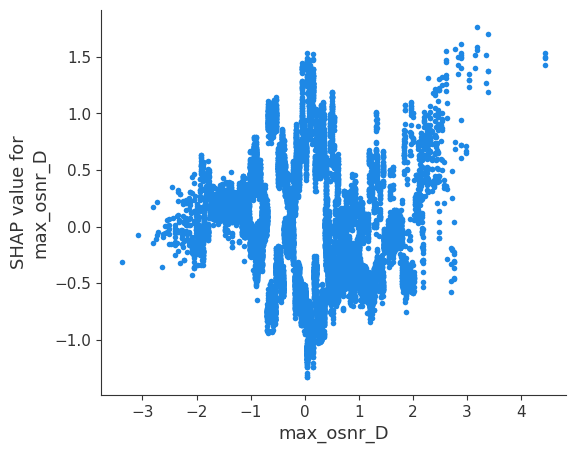

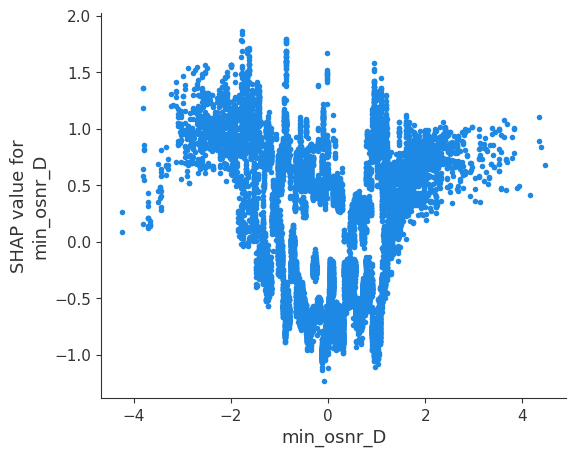

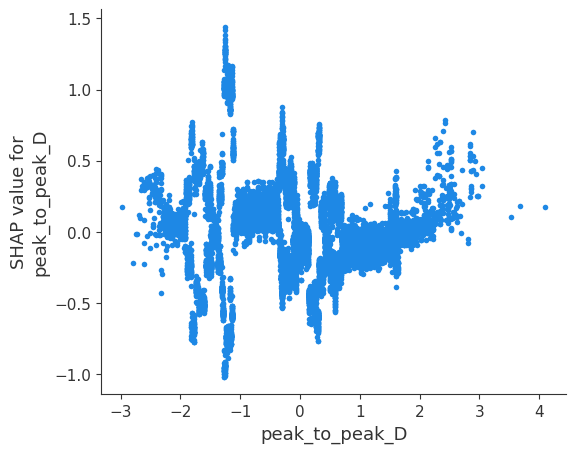

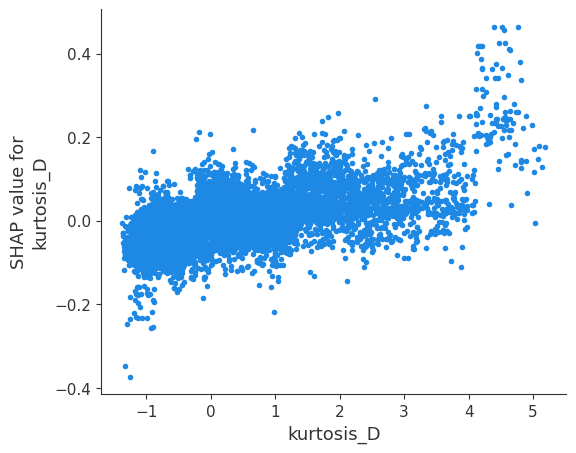

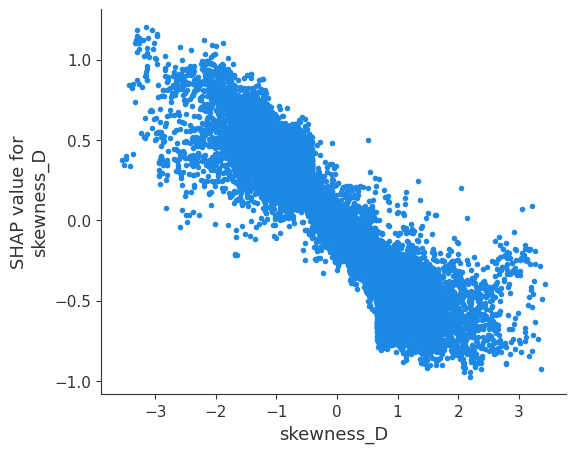

Link  3


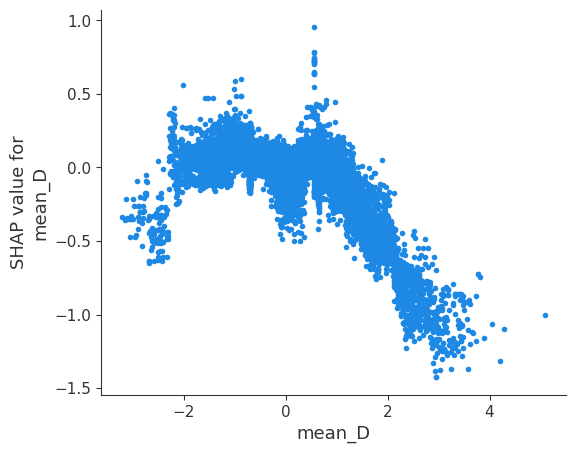

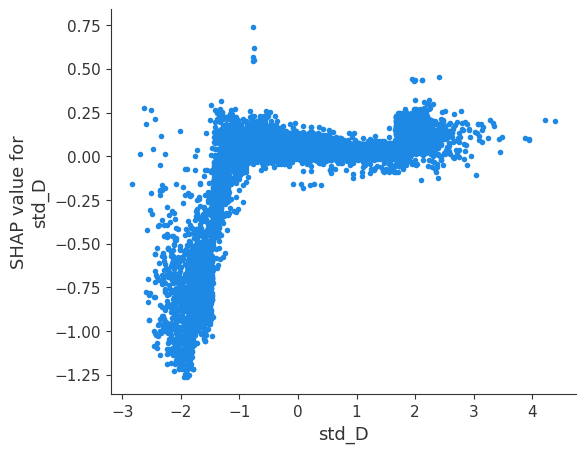

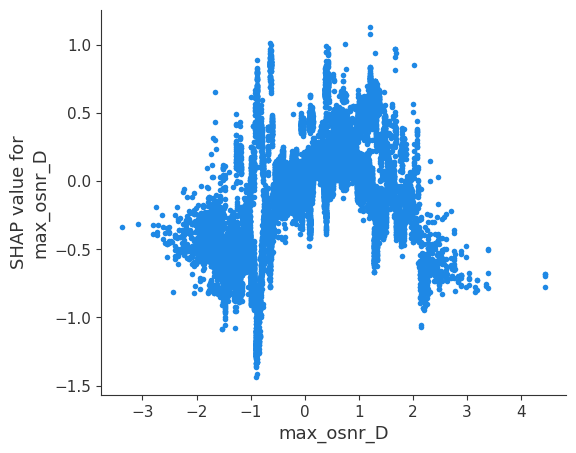

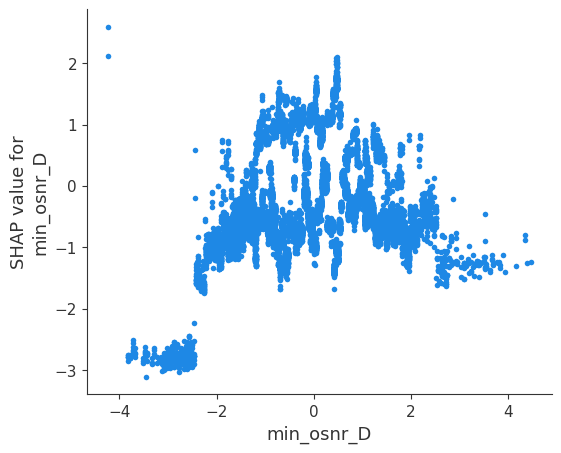

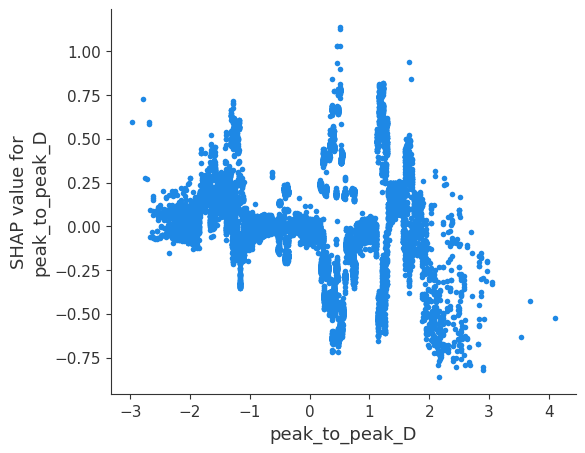

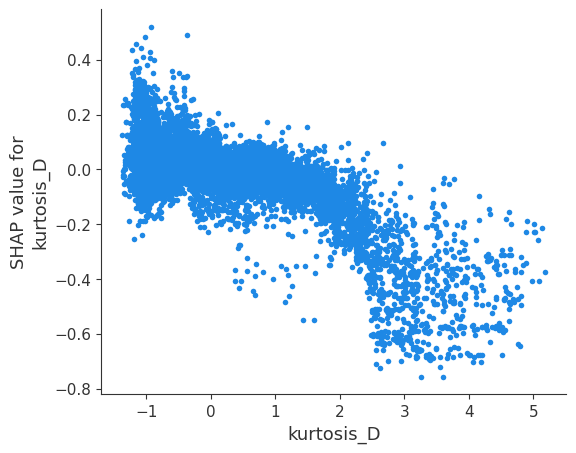

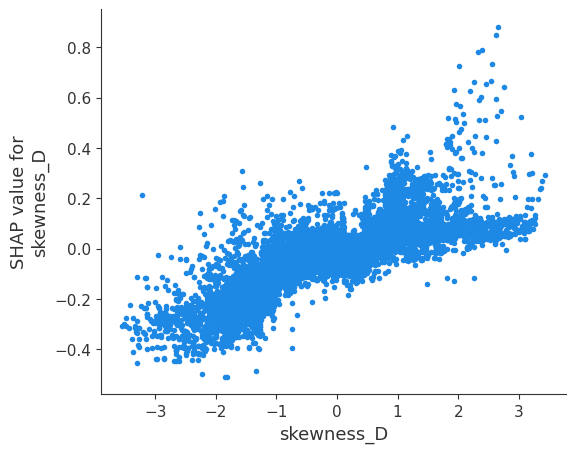

In [240]:
for label_idx in range(3):
  print("Link ", label_idx + 1)
  for feature_idx, feature_name in enumerate(X.columns):
    shap.dependence_plot(feature_idx, shap_values[label_idx], X_test_initial, interaction_index=None, feature_names=X_test_initial.columns)

#### 3.1.2 Logistic Regression

Average Train accuracy:  0.9712622577005201
Average Test accuracy: 0.6694833264717992
******************************************
Best Test accuracy: 0.6699773569370111


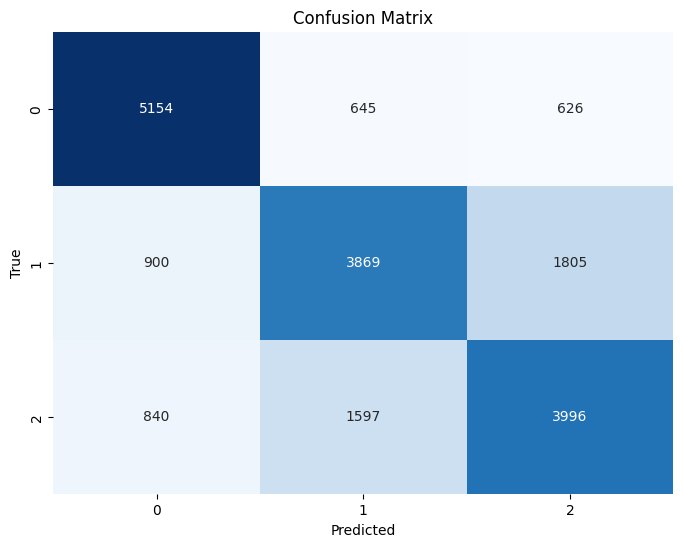

In [222]:
# Checking if we scale the data or not

df = final_df.copy()

scaler = StandardScaler()
X_scaled = scaler.fit_transform(df.drop('link', axis=1))
df_scaled = pd.DataFrame(X_scaled, columns=df.columns[:-1])
df_scaled['link'] = df['link']
df = df_scaled

# Split the data into features (X) and target variable (y)
X = df.drop('link', axis=1)
y = df['link']

label_encoder = LabelEncoder()
y = label_encoder.fit_transform(y)

# Split data into initial train and test sets
X_train_initial, X_test_initial, y_train_initial, y_test_initial = train_test_split(X, y, test_size=0.3, random_state=42)

# Initialize the StratifiedKFold for hypermeter optimization
# Outer cross validation of 5 folds
outer_skf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

# Initialize a list to store the accuracies
accuracies = []
train_accuracies = []

# Choosing the best model to predict
best_model = None
best_score = 0.0

# Perform k-fold cross-validation
for train_index, test_index in outer_skf.split(X_train_initial, y_train_initial):
  X_train, X_test = X_train_initial.iloc[train_index], X_train_initial.iloc[test_index]
  y_train, y_test = y_train_initial[train_index], y_train_initial[test_index]

  # Hyperparam optimization
  model = LogisticRegression(multi_class='multinomial', solver='sag')

  model.fit(X_train, y_train)

  # Checking the best grid for training data
  y_pred = model.predict(X_test)

  # Metrics for training
  train_accuracy = accuracy_score(y_test, y_pred)

  # Checking the grid for test
  y_pred = model.predict(X_test_initial)
  accuracy = accuracy_score(y_test_initial, y_pred)

  # Saving the best model for more test
  if accuracy > best_score:
      best_score = accuracy
      best_model = model


  accuracies.append(accuracy)
  train_accuracies.append(train_accuracy)



# Compute the average accuracy across all folds
average_accuracy = np.mean(accuracies)


print("Average Train accuracy: ", average_train_accuracy)
print("Average Test accuracy:", average_accuracy)

print("******************************************")

print("Best Test accuracy:", best_score)

# drawing confusing matrix
y_pred_best = best_model.predict(X_test_initial)
confusion_best = confusion_matrix(y_test_initial, y_pred_best)
plt.figure(figsize=(8, 6))
sns.heatmap(confusion_best, annot=True, cmap='Blues', fmt='d', cbar=False)
plt.title('Confusion Matrix')
plt.xlabel('Predicted')
plt.ylabel('True')
plt.show()


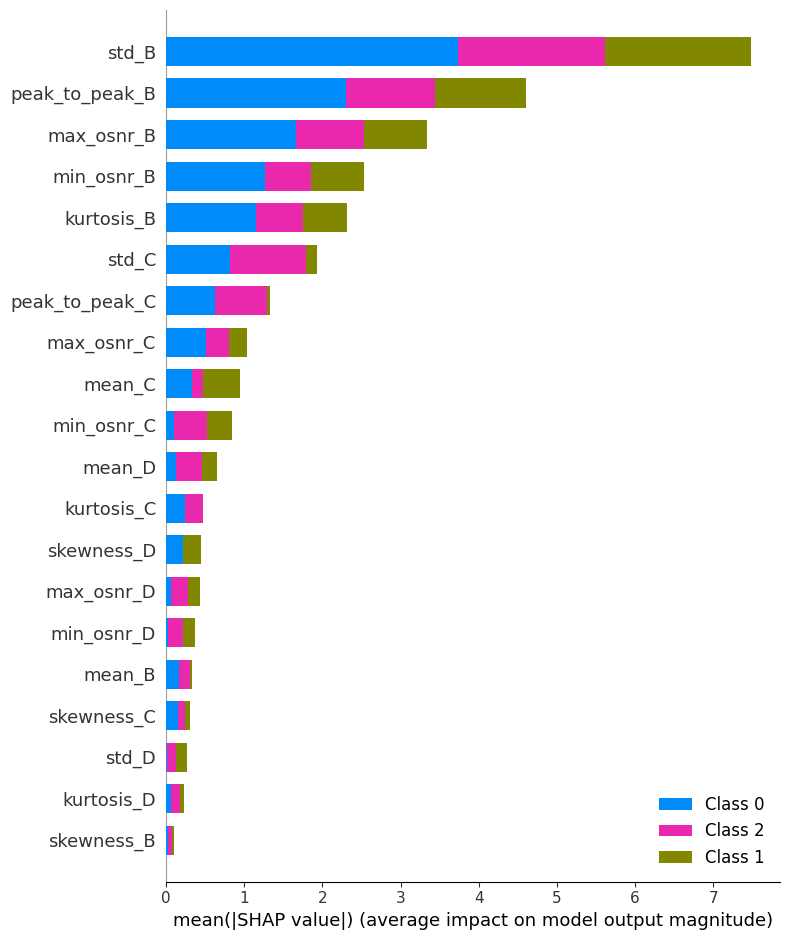

In [228]:
# Initialize the explainer
explainer = shap.LinearExplainer(best_model, X_train_initial)

# Generate SHAP values for the test data
shap_values = explainer.shap_values(X_test_initial)

shap.summary_plot(shap_values, X_test_initial)

Link  1


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


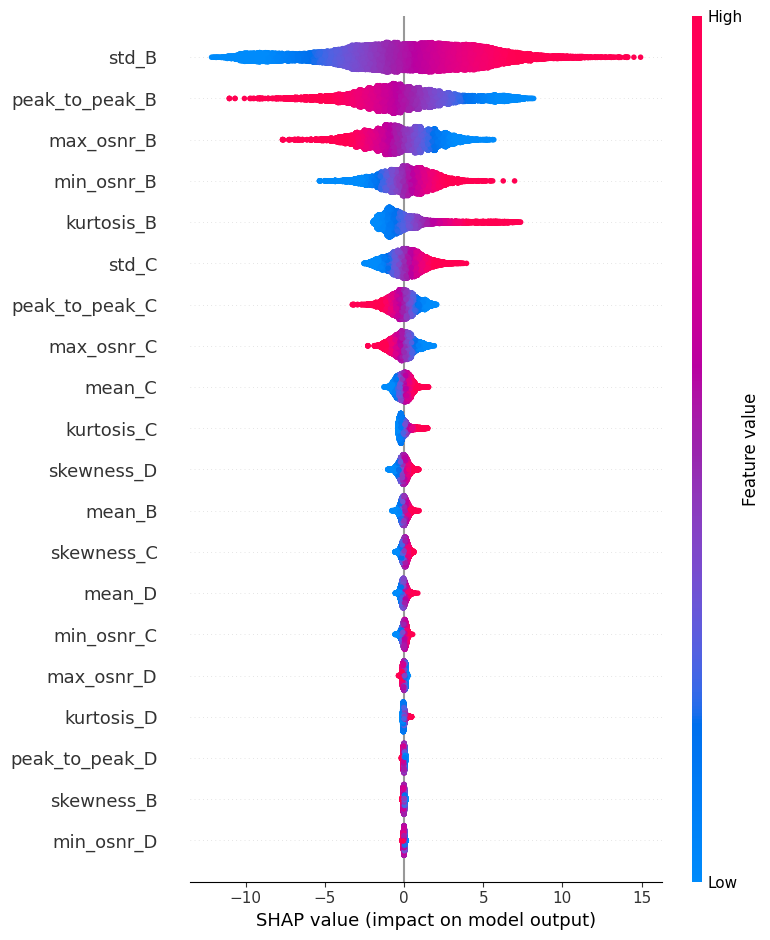

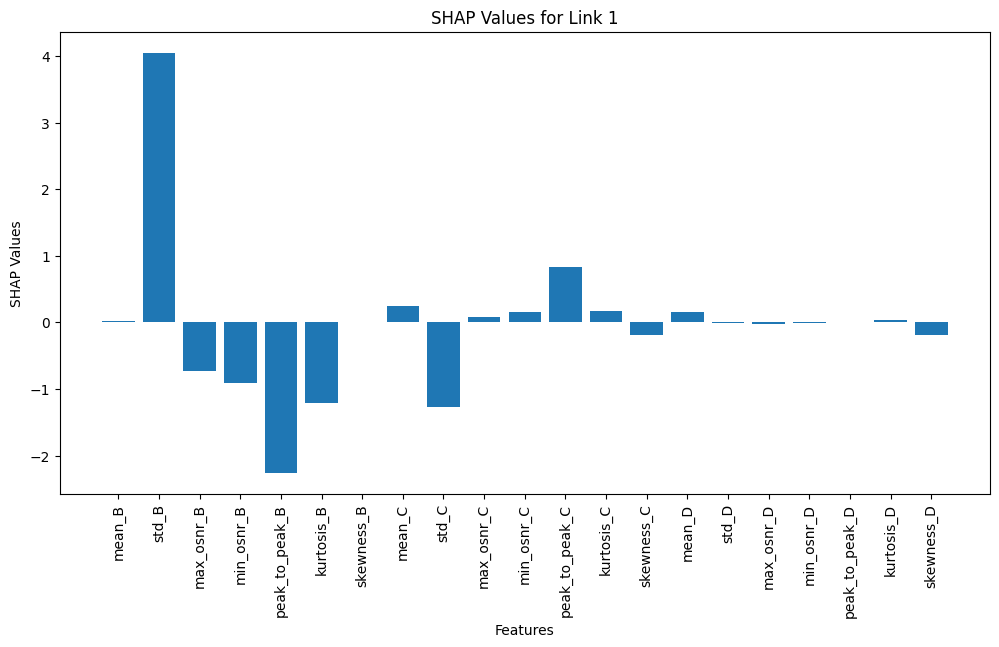

Link  2


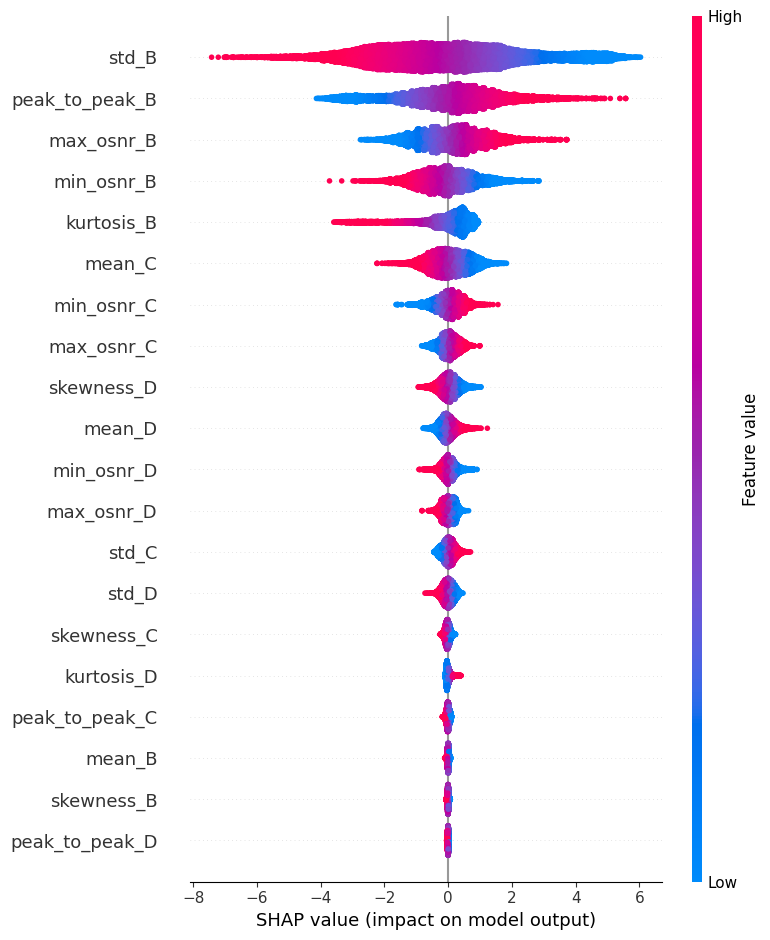

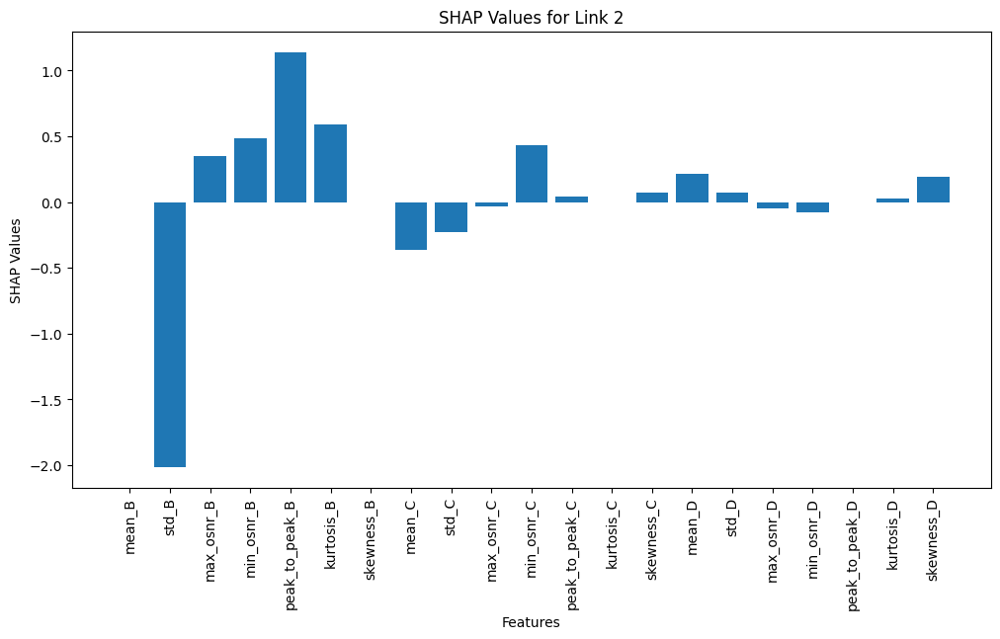

Link  3


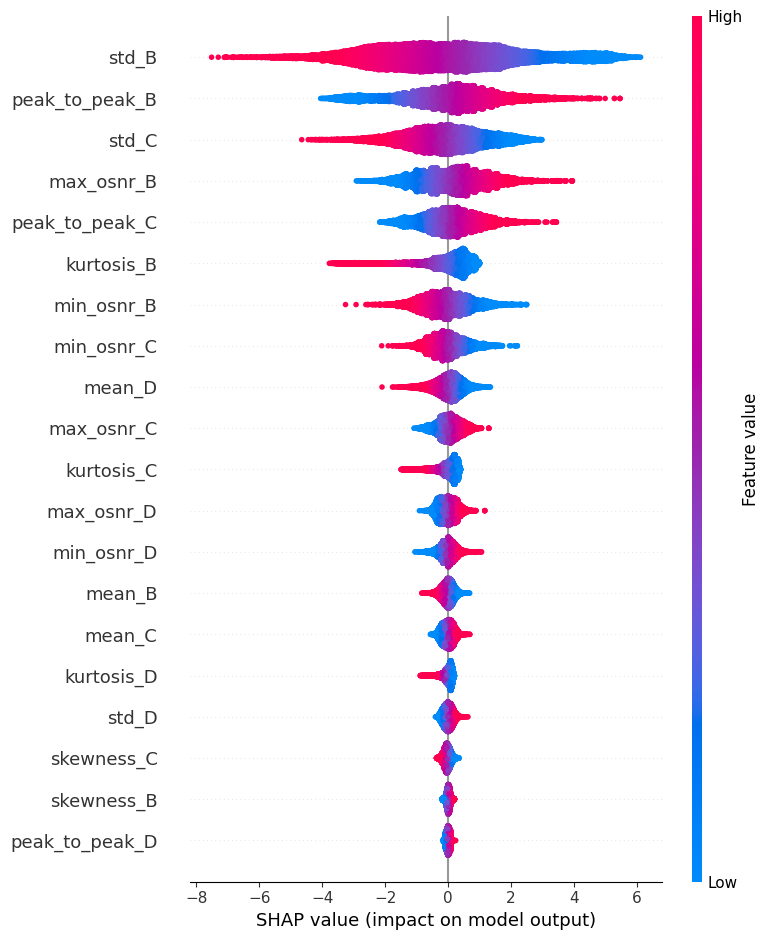

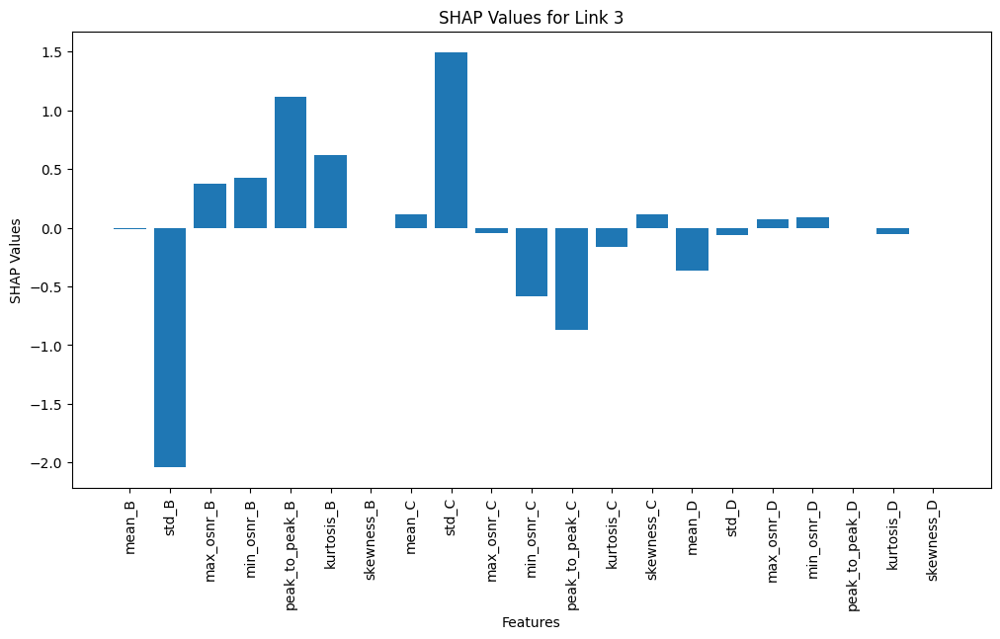

In [229]:
# Separate plots for each label
for label_idx in range(3):
    print("Link ", label_idx + 1)
    # Summary plot
    shap.summary_plot(shap_values[label_idx], X_test_initial, class_names=["1", "2", "3"], show=False)


    # Bar plot for a specific instance (e.g., instance at index 0)
    plt.figure(figsize=(12, 6))
    shap_values_label = shap_values[label_idx][0]
    plt.bar(range(len(shap_values_label)), shap_values_label)
    plt.xticks(range(len(shap_values_label)), X_test_initial.columns, rotation=90, ha='center')
    plt.xlabel("Features")
    plt.ylabel("SHAP Values")
    plt.title("SHAP Values for Link " + str(label_idx + 1))
    plt.show()

Link  1


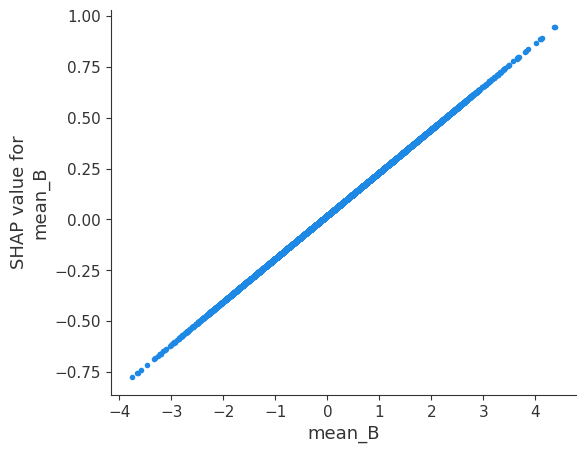

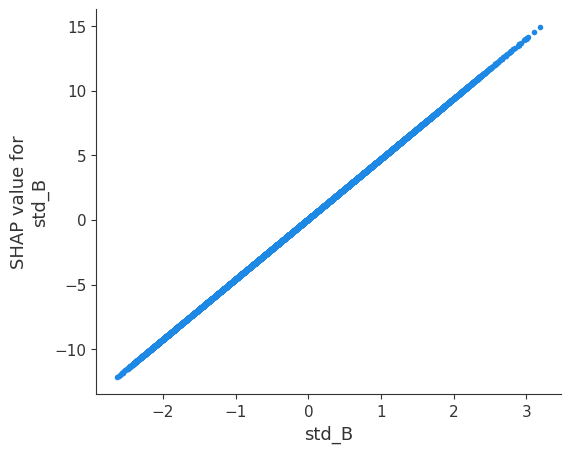

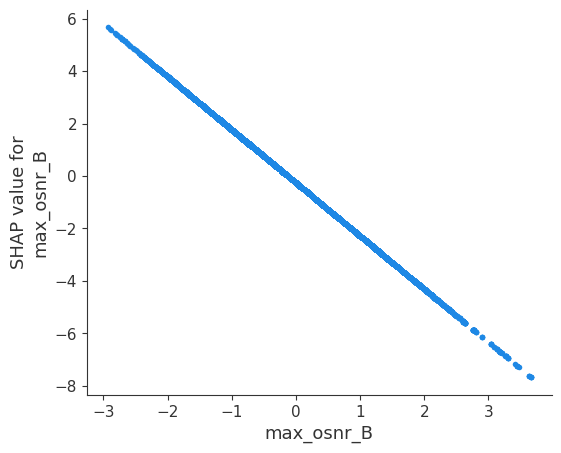

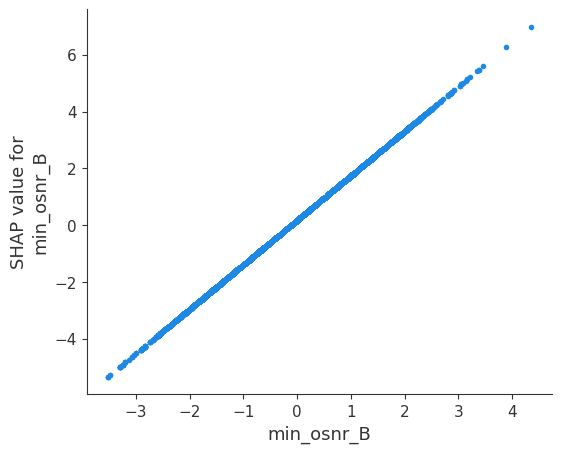

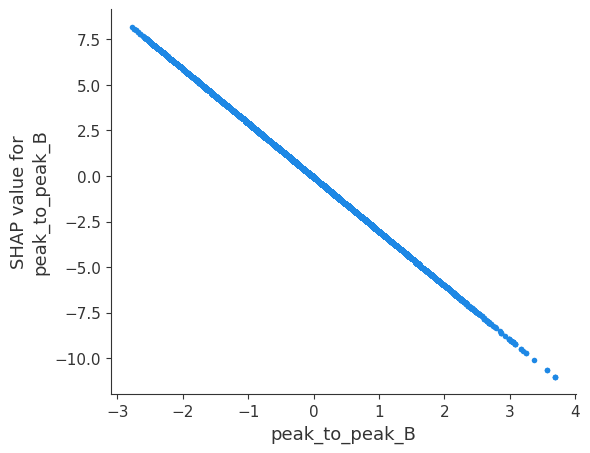

...

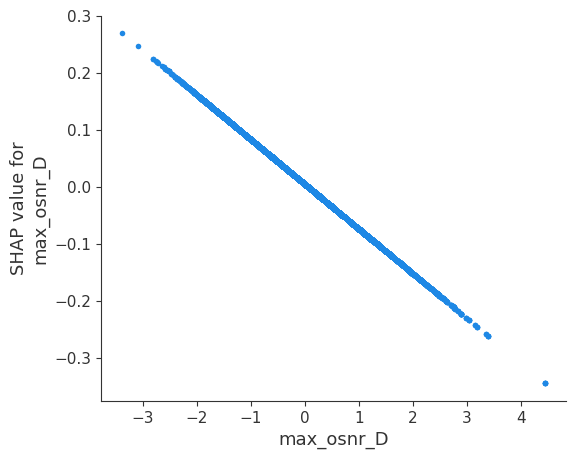

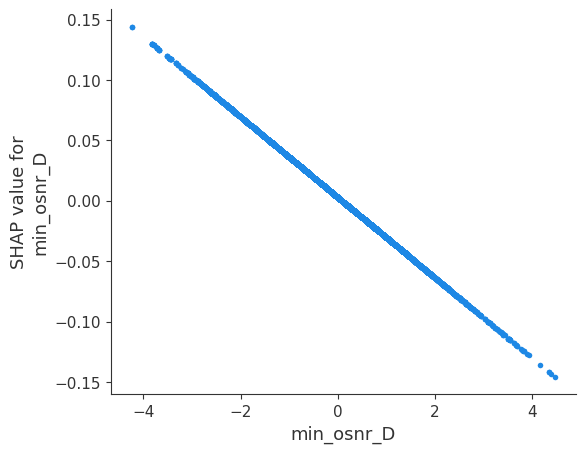

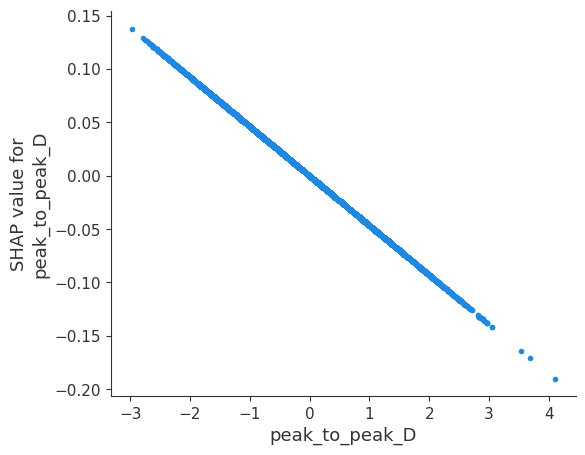

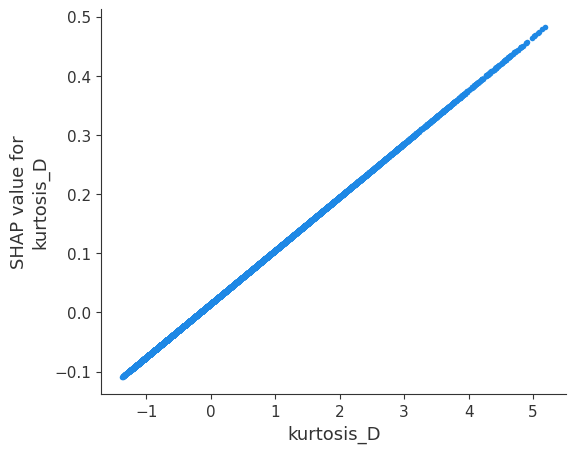

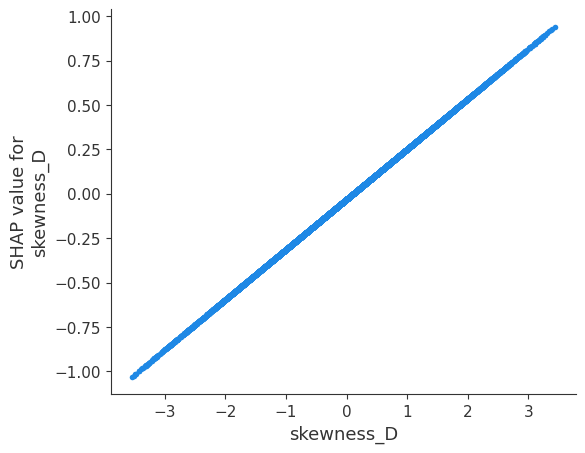

Link  2


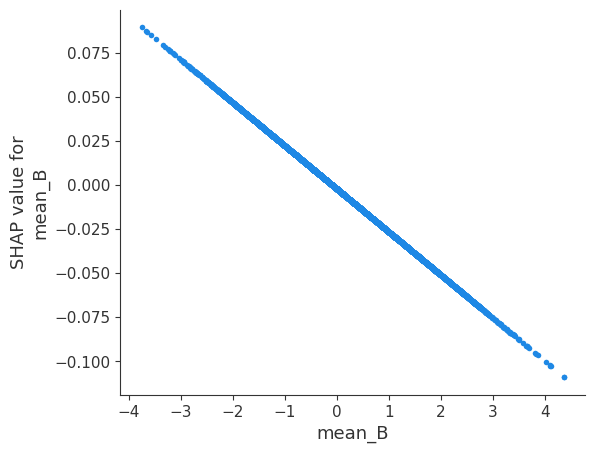

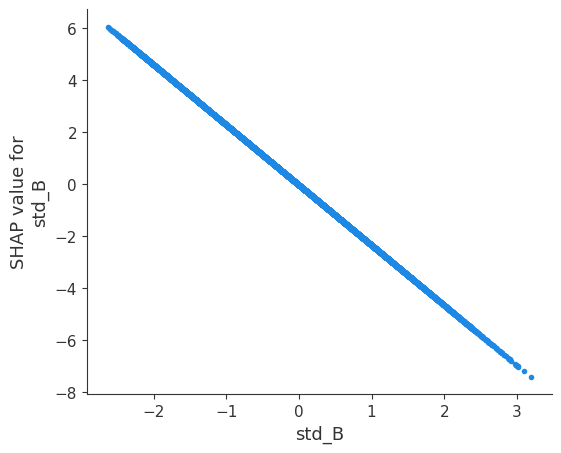

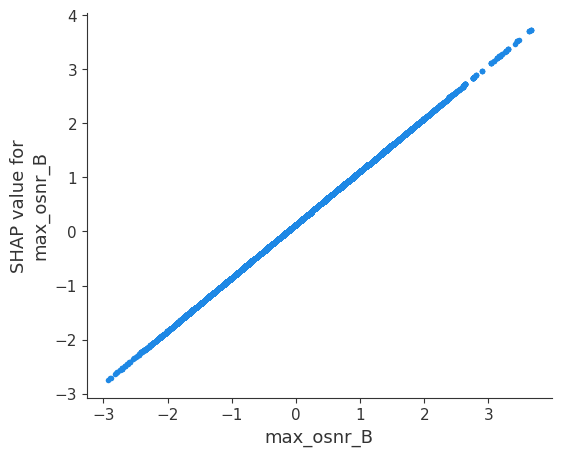

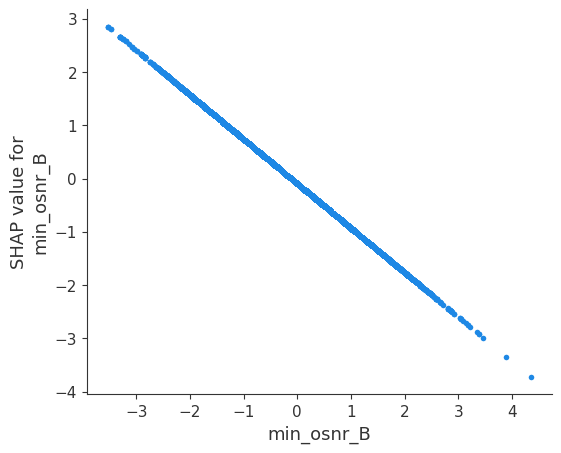

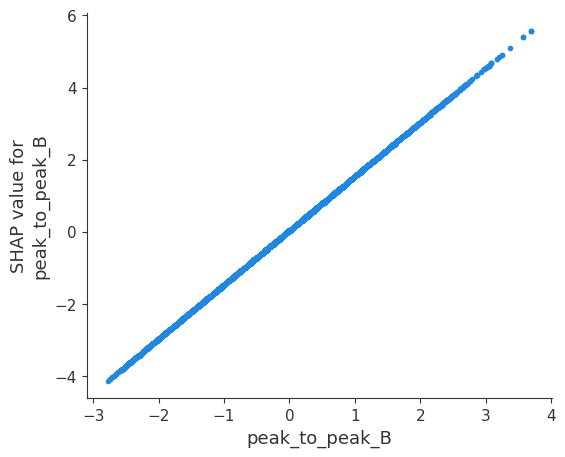

...

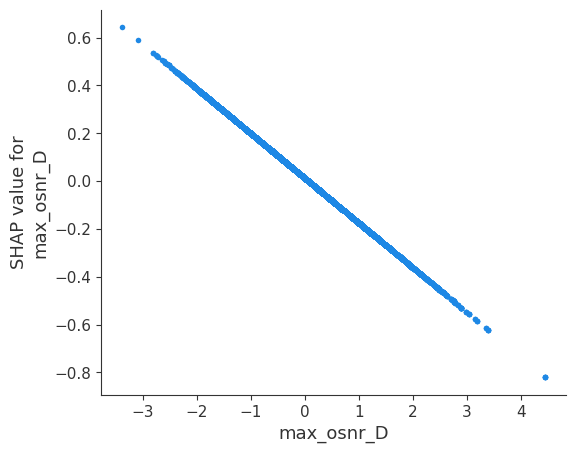

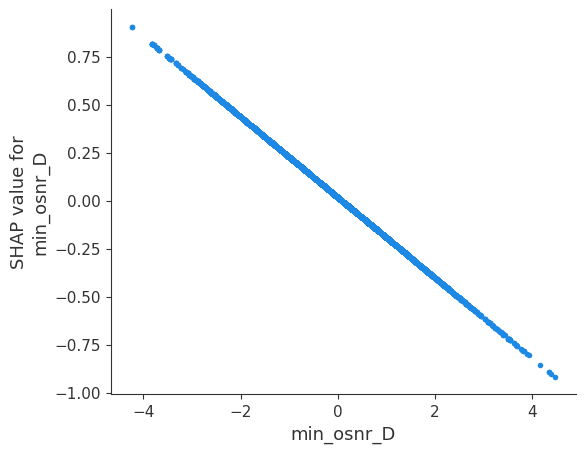

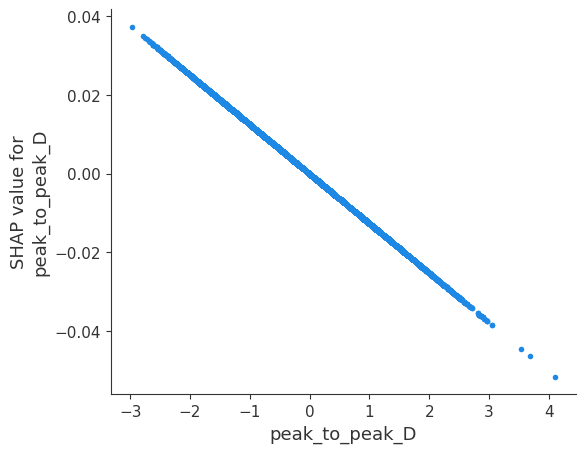

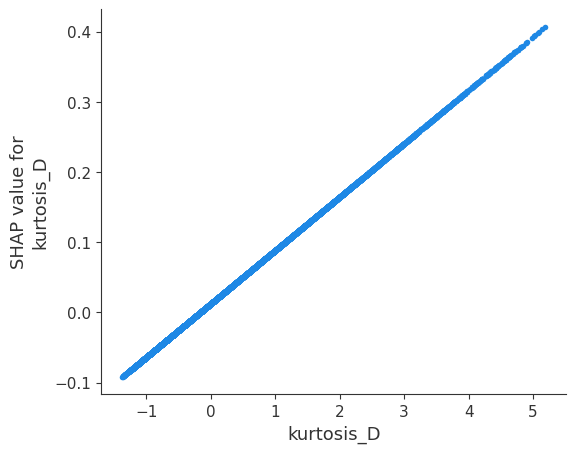

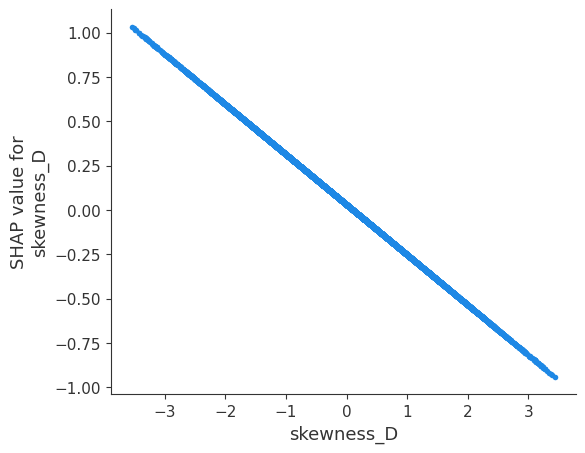

Link  3


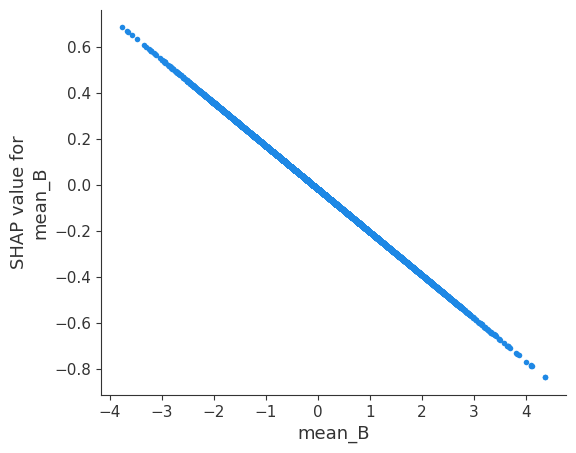

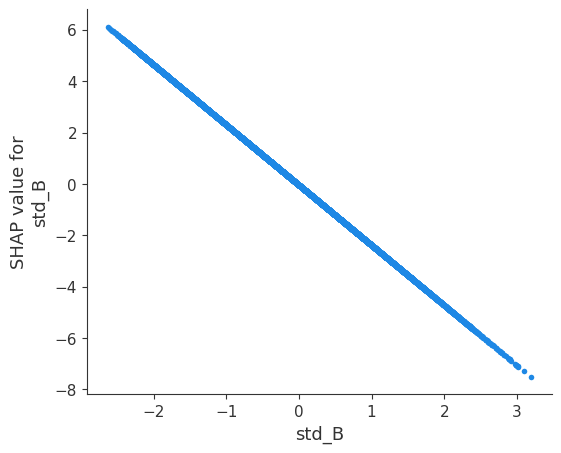

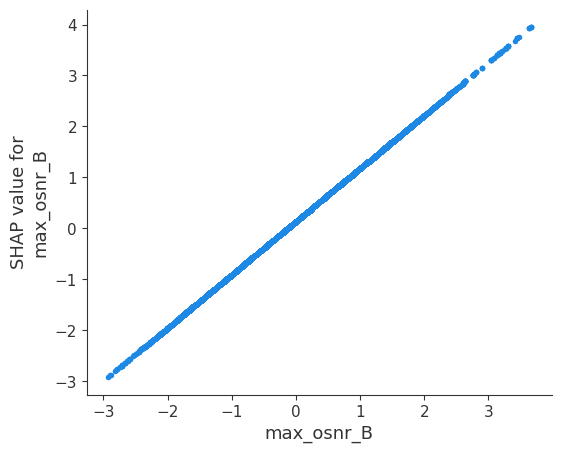

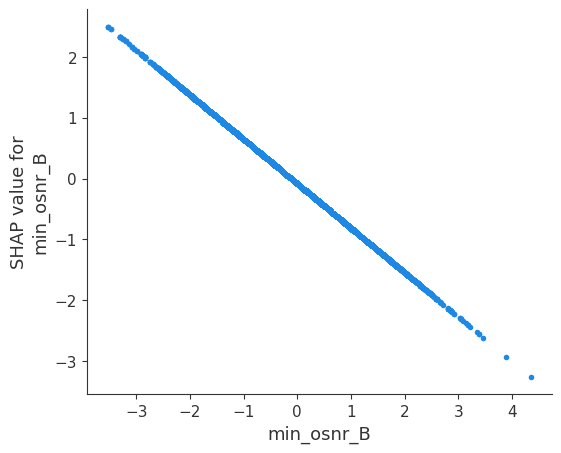

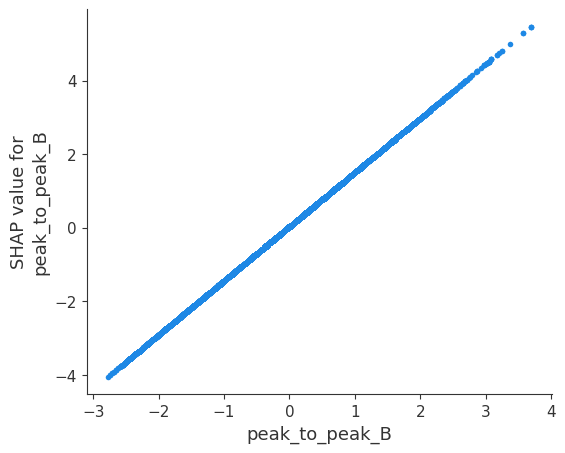

...

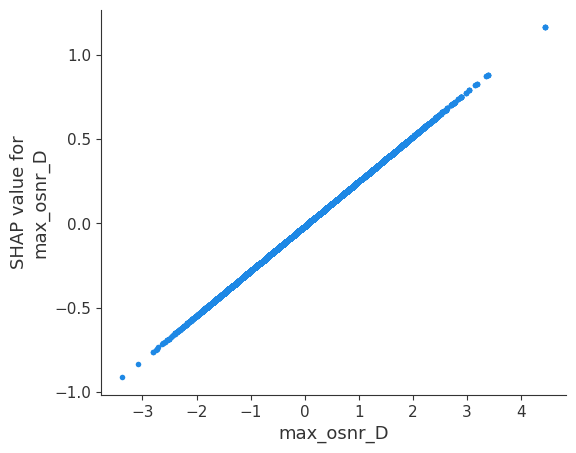

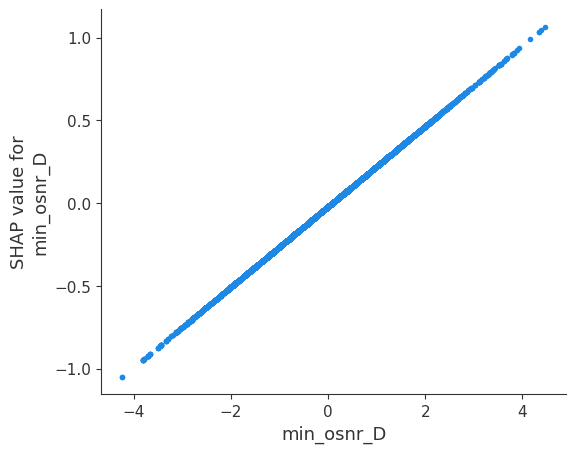

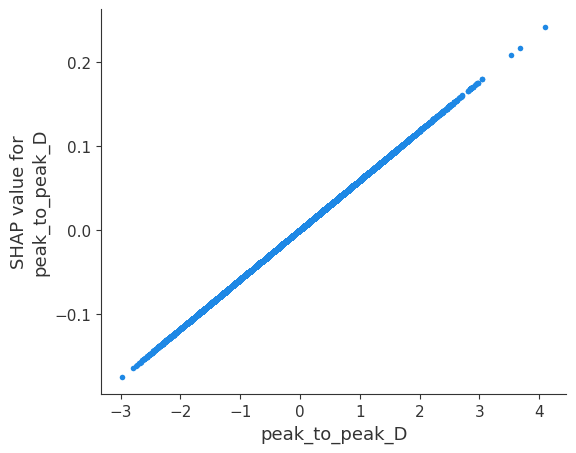

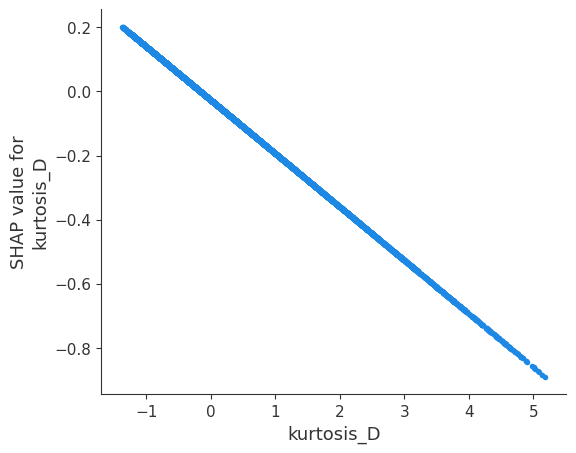

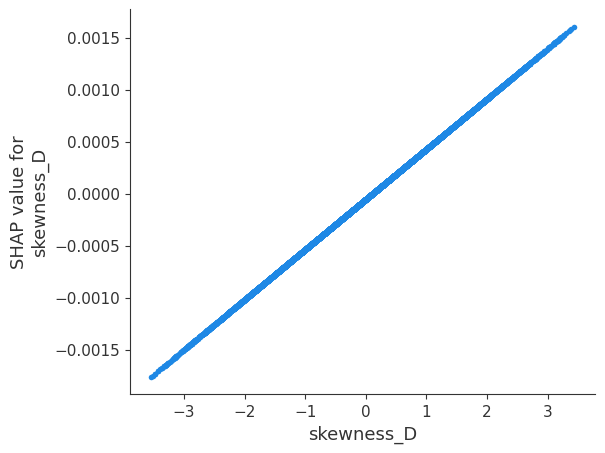

In [230]:
for label_idx in range(3):
  print("Link ", label_idx + 1)
  for feature_idx, feature_name in enumerate(X.columns):
    shap.dependence_plot(feature_idx, shap_values[label_idx], X_test_initial, interaction_index=None, feature_names=X_test_initial.columns)

Partial Dataframe

Average Train accuracy:  0.9712622577005201
Average Test accuracy: 0.47314738575545495
******************************************
Best Test accuracy: 0.4743721696171264


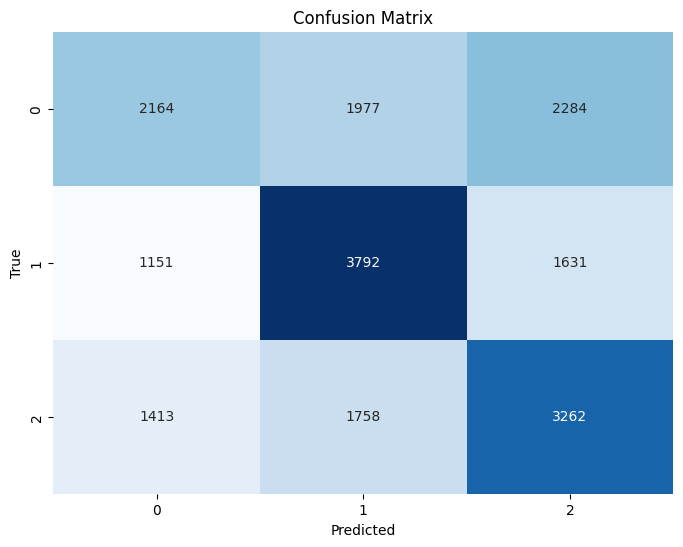

In [231]:
# Checking if we scale the data or not

df = end_df.copy()

scaler = StandardScaler()
X_scaled = scaler.fit_transform(df.drop('link', axis=1))
df_scaled = pd.DataFrame(X_scaled, columns=df.columns[:-1])
df_scaled['link'] = df['link']
df = df_scaled

# Split the data into features (X) and target variable (y)
X = df.drop('link', axis=1)
y = df['link']

label_encoder = LabelEncoder()
y = label_encoder.fit_transform(y)

# Split data into initial train and test sets
X_train_initial, X_test_initial, y_train_initial, y_test_initial = train_test_split(X, y, test_size=0.3, random_state=42)

# Initialize the StratifiedKFold for hypermeter optimization
# Outer cross validation of 5 folds
outer_skf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

# Initialize a list to store the accuracies
accuracies = []
train_accuracies = []

# Choosing the best model to predict
best_model = None
best_score = 0.0

# Perform k-fold cross-validation
for train_index, test_index in outer_skf.split(X_train_initial, y_train_initial):
  X_train, X_test = X_train_initial.iloc[train_index], X_train_initial.iloc[test_index]
  y_train, y_test = y_train_initial[train_index], y_train_initial[test_index]

  # Hyperparam optimization
  model = LogisticRegression(multi_class='multinomial', solver='sag')

  model.fit(X_train, y_train)

  # Checking the best grid for training data
  y_pred = model.predict(X_test)

  # Metrics for training
  train_accuracy = accuracy_score(y_test, y_pred)

  # Checking the grid for test
  y_pred = model.predict(X_test_initial)
  accuracy = accuracy_score(y_test_initial, y_pred)

  # Saving the best model for more test
  if accuracy > best_score:
      best_score = accuracy
      best_model = model


  accuracies.append(accuracy)
  train_accuracies.append(train_accuracy)



# Compute the average accuracy across all folds
average_accuracy = np.mean(accuracies)


print("Average Train accuracy: ", average_train_accuracy)
print("Average Test accuracy:", average_accuracy)

print("******************************************")

print("Best Test accuracy:", best_score)

# drawing confusing matrix
y_pred_best = best_model.predict(X_test_initial)
confusion_best = confusion_matrix(y_test_initial, y_pred_best)
plt.figure(figsize=(8, 6))
sns.heatmap(confusion_best, annot=True, cmap='Blues', fmt='d', cbar=False)
plt.title('Confusion Matrix')
plt.xlabel('Predicted')
plt.ylabel('True')
plt.show()


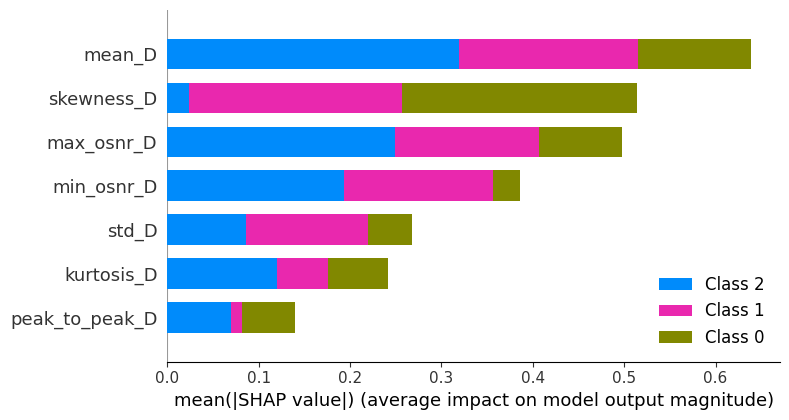

In [232]:
# Initialize the explainer
explainer = shap.LinearExplainer(best_model, X_train_initial)

# Generate SHAP values for the test data
shap_values = explainer.shap_values(X_test_initial)

shap.summary_plot(shap_values, X_test_initial)

### 3.2 In Time Split

#### 3.2.1 XGBoost

Average Train accuracy:  0.9726075556692424
Average Test accuracy: 0.9732091395636063
******************************************
Best Test accuracy: 0.9747324001646768


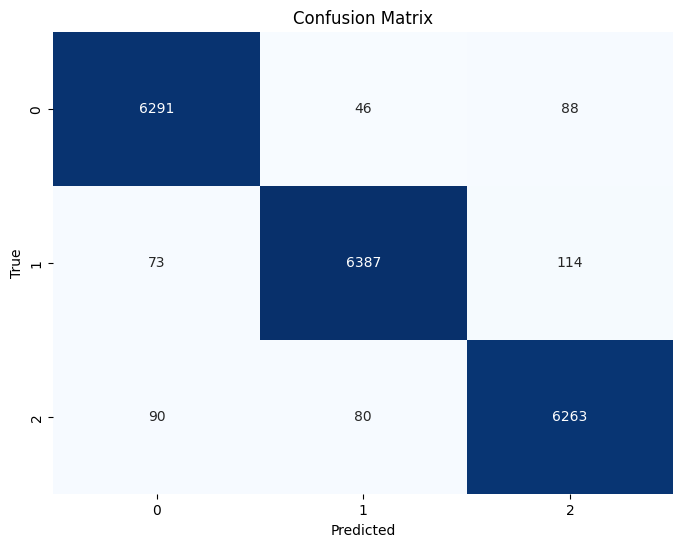

In [241]:
df = final_df.copy()

train_df, test_df = in_time_spliter(df, 10, 1, 0.7)

# Shuffling the data
train_df = train_df.sample(frac=1, random_state=42)
test_df = test_df.sample(frac=1, random_state=42)

label_encoder = LabelEncoder()

# Split the data into features (X) and target variable (y)
X_train_initial = train_df.drop('link', axis=1)
y_train_initial = train_df['link']
y_train_initial = label_encoder.fit_transform(y_train_initial)


X_test_initial = test_df.drop('link', axis=1)
y_test_initial = test_df['link']
y_test_initial = label_encoder.fit_transform(y_test_initial)

# Split the data into features (X) and target variable (y)
X = df.drop('link', axis=1)
y = df['link']

label_encoder = LabelEncoder()
y = label_encoder.fit_transform(y)

# Split data into initial train and test sets
X_train_initial, X_test_initial, y_train_initial, y_test_initial = train_test_split(X, y, test_size=0.3, random_state=42)

# Initialize the StratifiedKFold for hypermeter optimization
# Outer cross validation of 5 folds
outer_skf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

# Initialize a list to store the accuracies
accuracies = []
train_accuracies = []

# Choosing the best model to predict
best_model = None
best_score = 0.0

# Perform k-fold cross-validation
for train_index, test_index in outer_skf.split(X_train_initial, y_train_initial):
  X_train, X_test = X_train_initial.iloc[train_index], X_train_initial.iloc[test_index]
  y_train, y_test = y_train_initial[train_index], y_train_initial[test_index]

  # Hyperparam optimization
  model = xgb.XGBClassifier(objective='multi:softmax', num_class=3)

  model.fit(X_train, y_train)

  # Checking the best grid for training data
  y_pred = model.predict(X_test)

  # Metrics for training
  train_accuracy = accuracy_score(y_test, y_pred)

  # Checking the grid for test
  y_pred = model.predict(X_test_initial)
  accuracy = accuracy_score(y_test_initial, y_pred)

  # Saving the best model for more test
  if accuracy > best_score:
      best_score = accuracy
      best_model = model


  accuracies.append(accuracy)
  train_accuracies.append(train_accuracy)



# Compute the average accuracy across all folds
average_accuracy = np.mean(accuracies)
average_train_accuracy = np.mean(train_accuracies)


print("Average Train accuracy: ", average_train_accuracy)
print("Average Test accuracy:", average_accuracy)

print("******************************************")

print("Best Test accuracy:", best_score)

# drawing confusing matrix
y_pred_best = best_model.predict(X_test_initial)
confusion_best = confusion_matrix(y_test_initial, y_pred_best)
plt.figure(figsize=(8, 6))
sns.heatmap(confusion_best, annot=True, cmap='Blues', fmt='d', cbar=False)
plt.title('Confusion Matrix')
plt.xlabel('Predicted')
plt.ylabel('True')
plt.show()

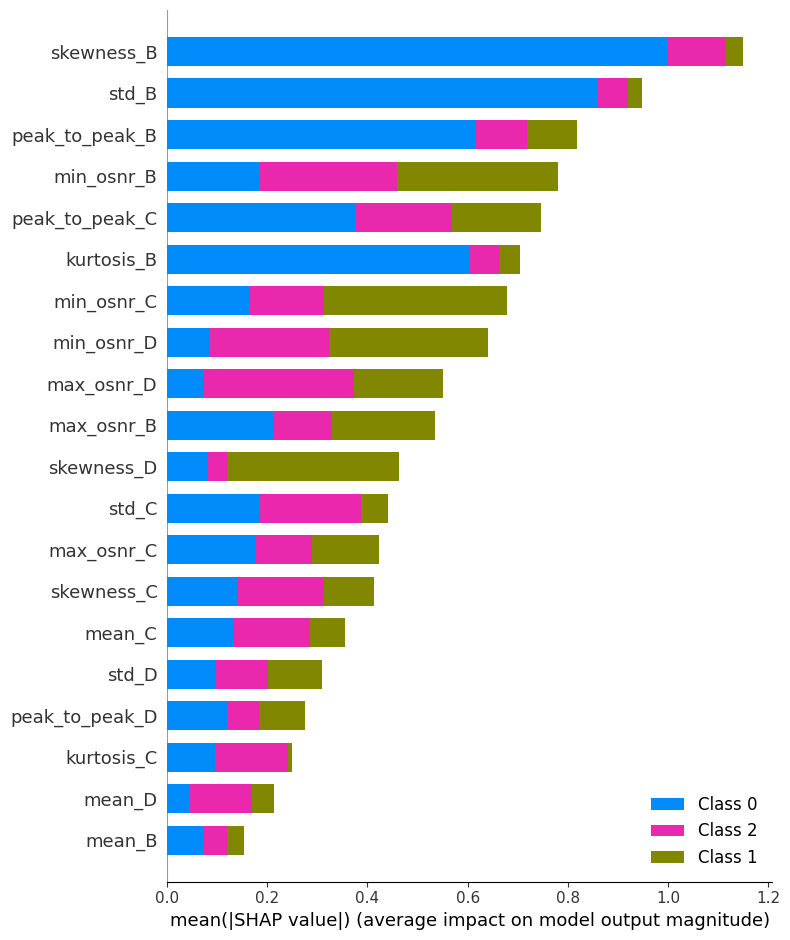

In [242]:
# Initialize the explainer
explainer = shap.TreeExplainer(best_model)

# Generate SHAP values for the test data
shap_values = explainer.shap_values(X_test_initial)

# Global summary plot
shap.summary_plot(shap_values, X_test_initial)

Link  1


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


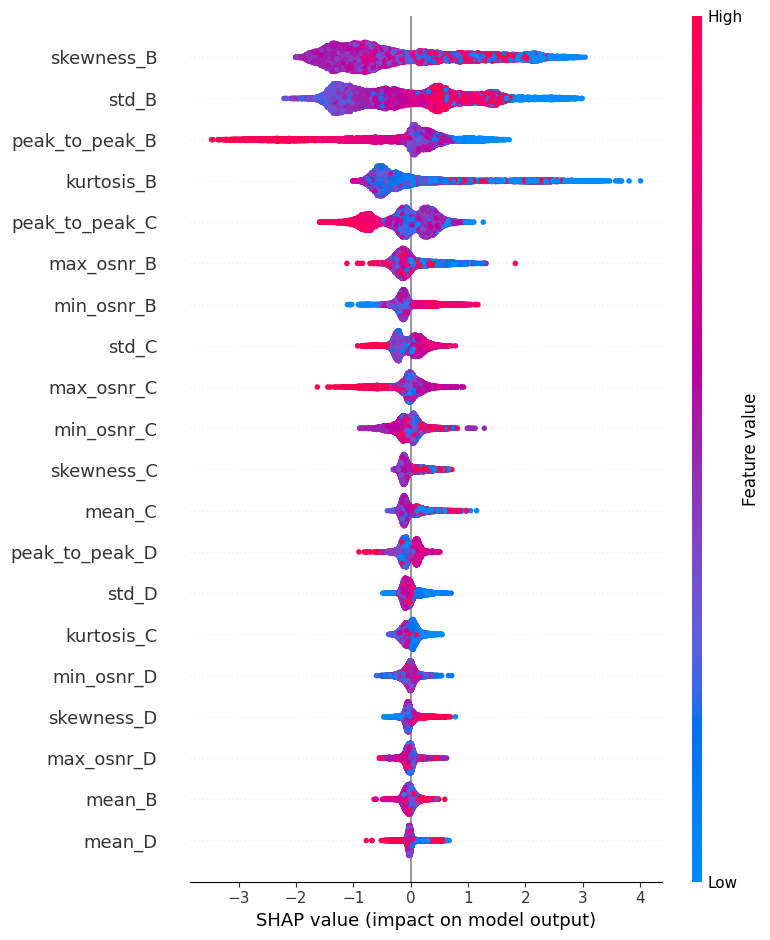

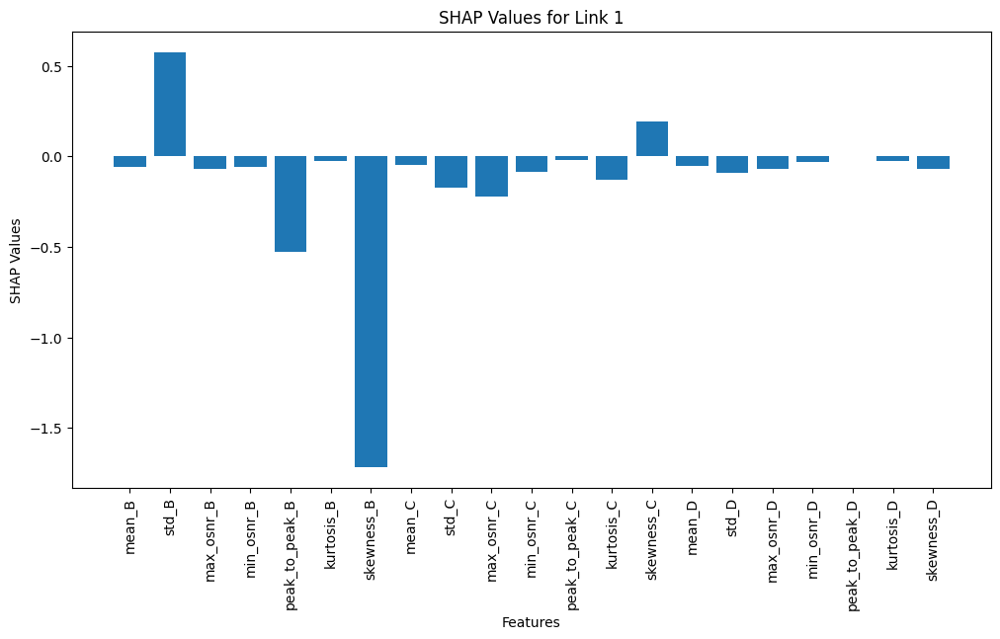

Link  2


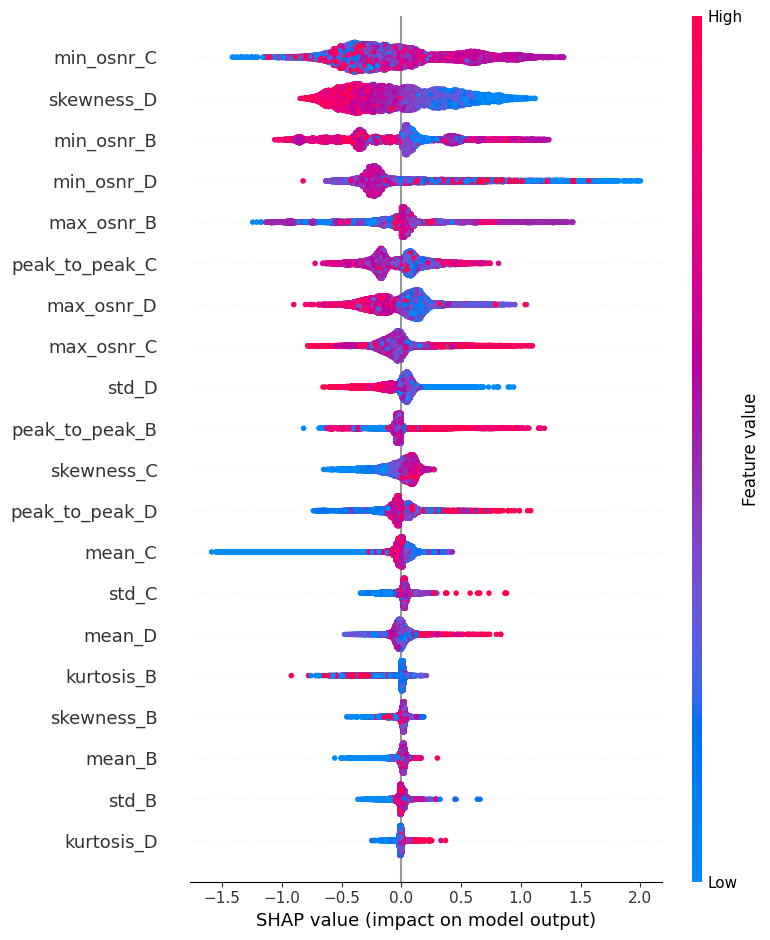

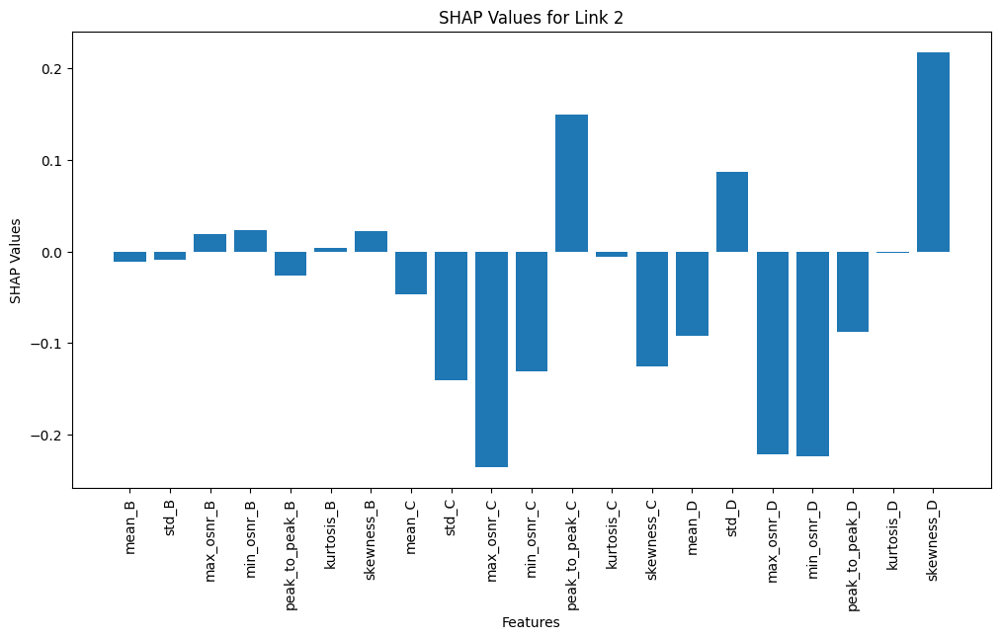

Link  3


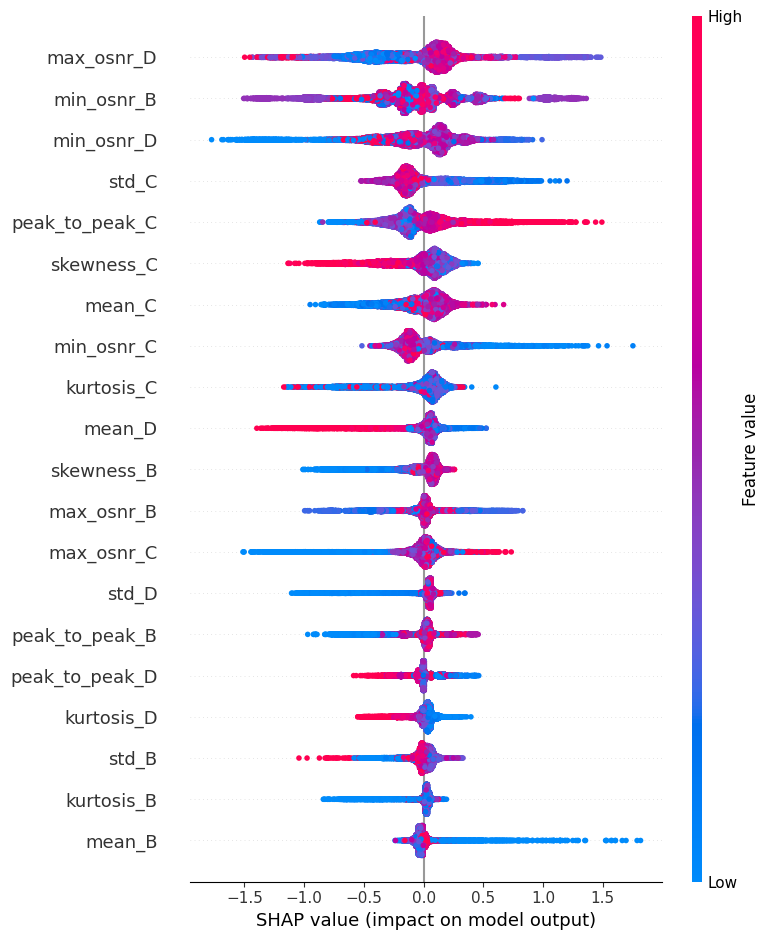

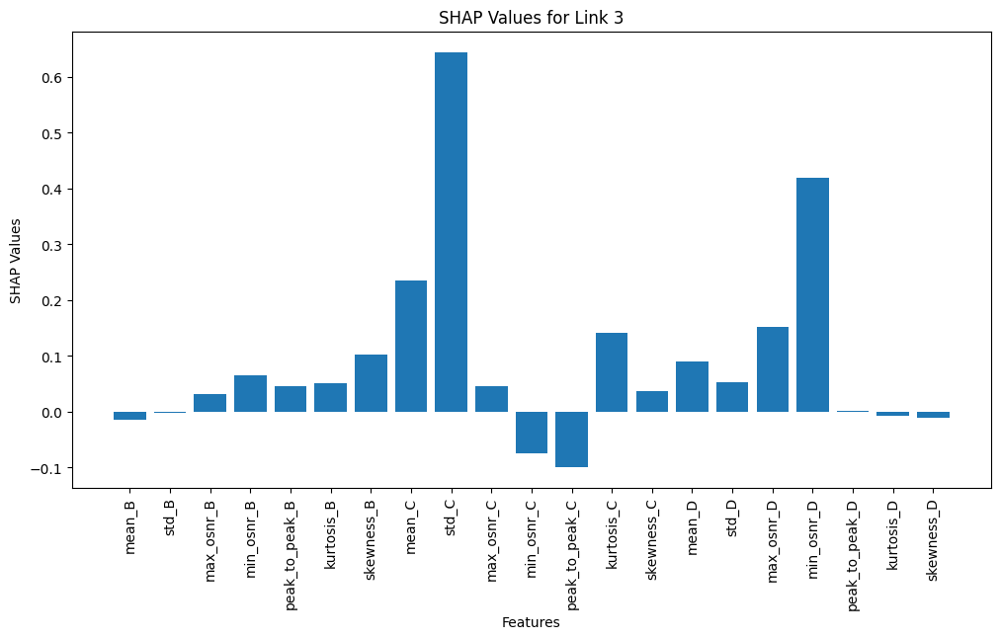

In [243]:
# Separate plots for each label
for label_idx in range(3):
    print("Link ", label_idx + 1)
    # Summary plot
    shap.summary_plot(shap_values[label_idx], X_test_initial, class_names=["1", "2", "3"], show=False)


    # Bar plot for a specific instance (e.g., instance at index 0)
    plt.figure(figsize=(12, 6))
    shap_values_label = shap_values[label_idx][0]
    plt.bar(range(len(shap_values_label)), shap_values_label)
    plt.xticks(range(len(shap_values_label)), X_test_initial.columns, rotation=90, ha='center')
    plt.xlabel("Features")
    plt.ylabel("SHAP Values")
    plt.title("SHAP Values for Link " + str(label_idx + 1))
    plt.show()

Link  1


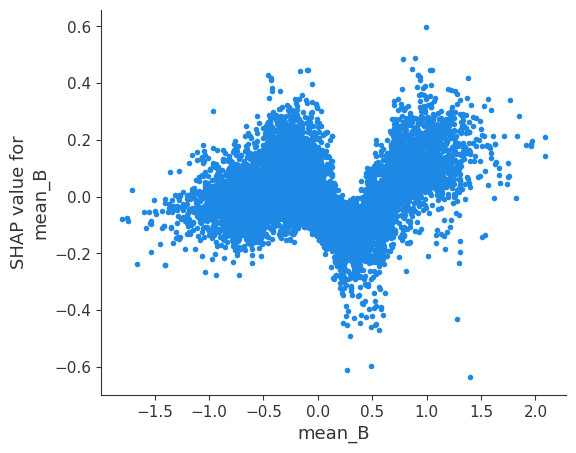

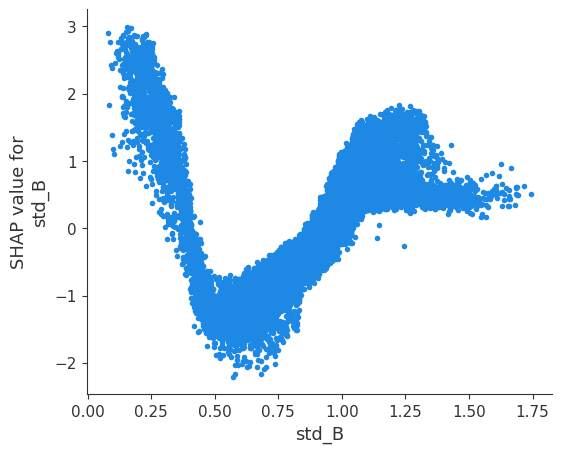

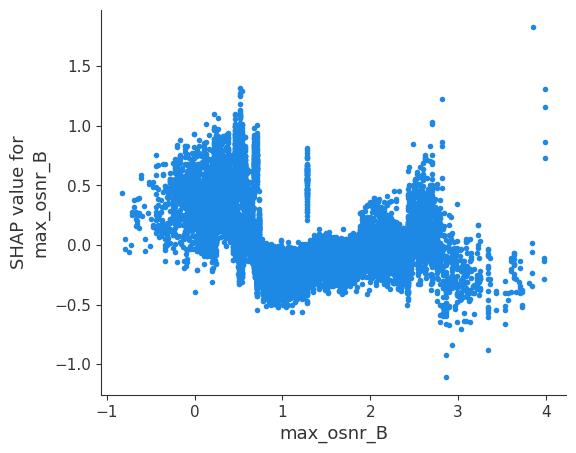

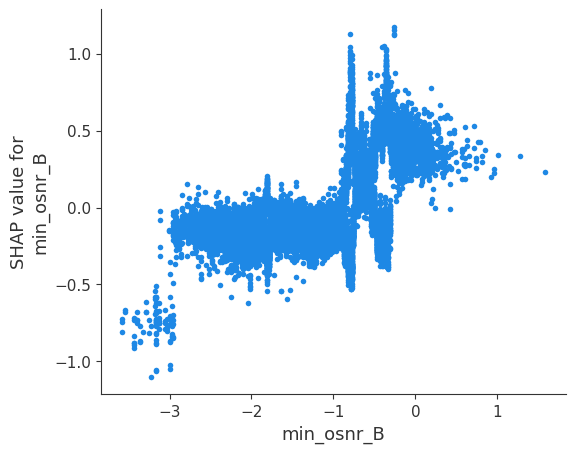

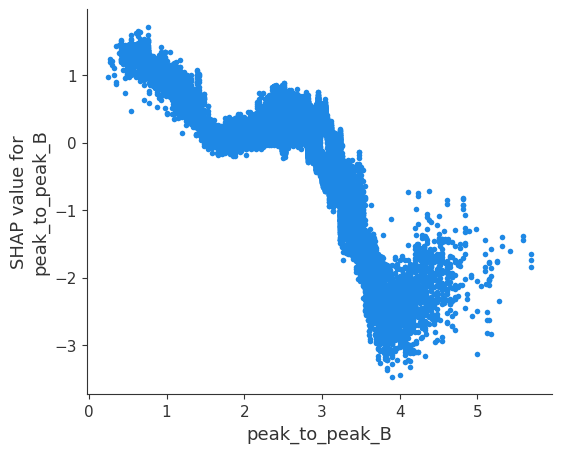

...

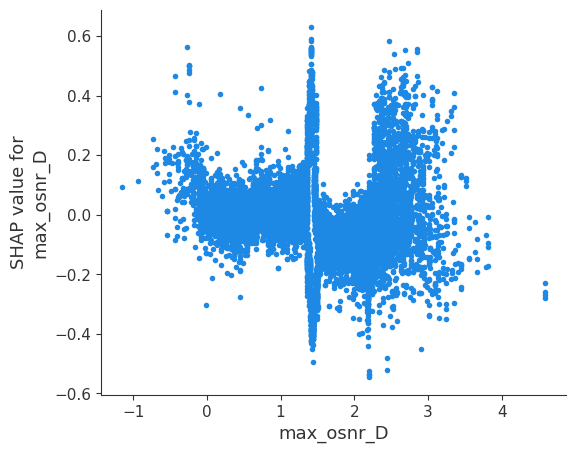

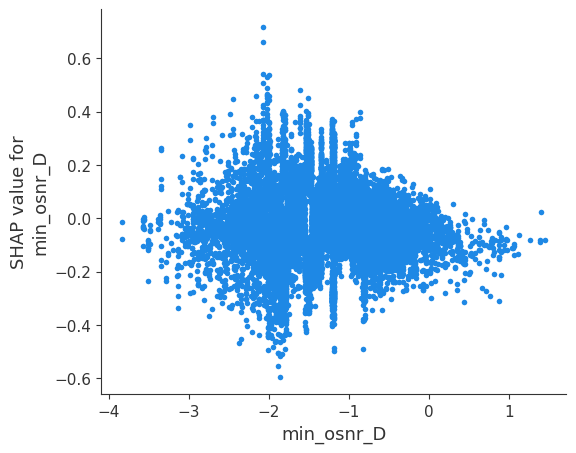

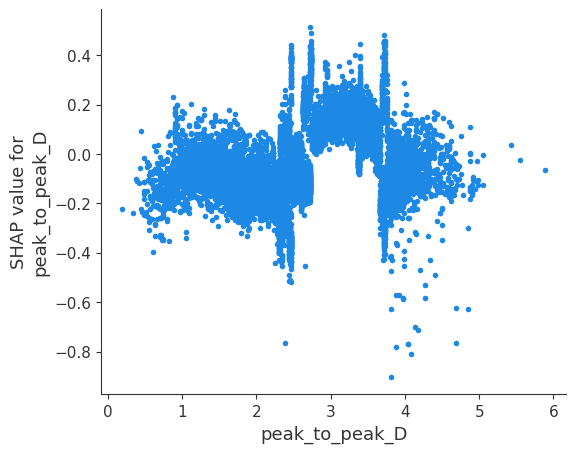

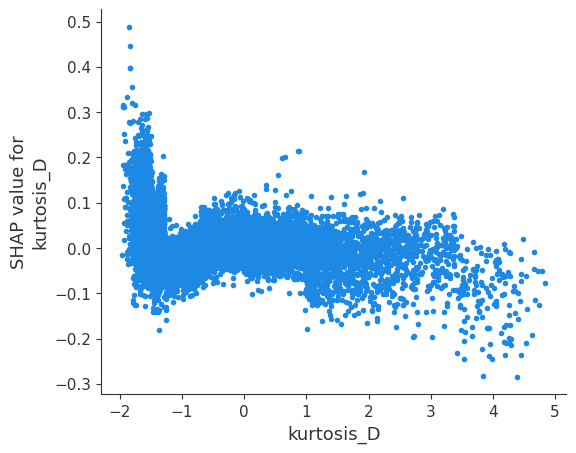

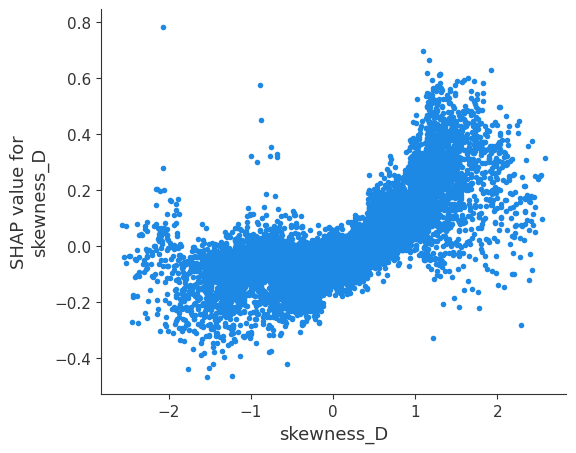

Link  2


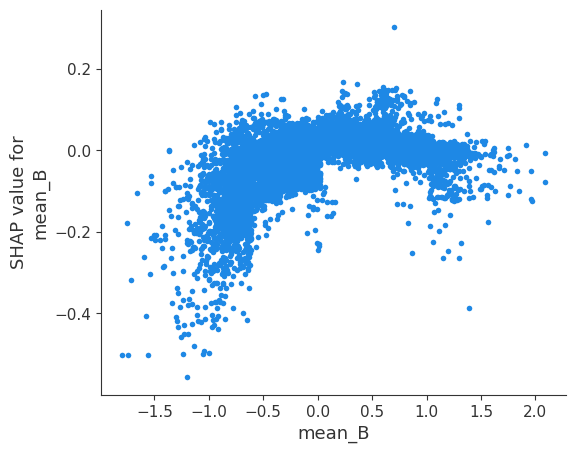

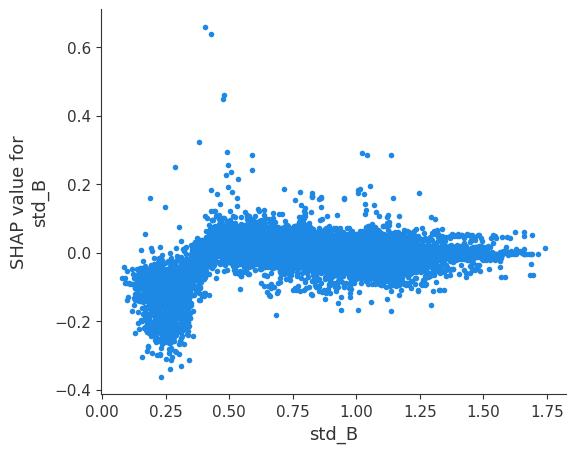

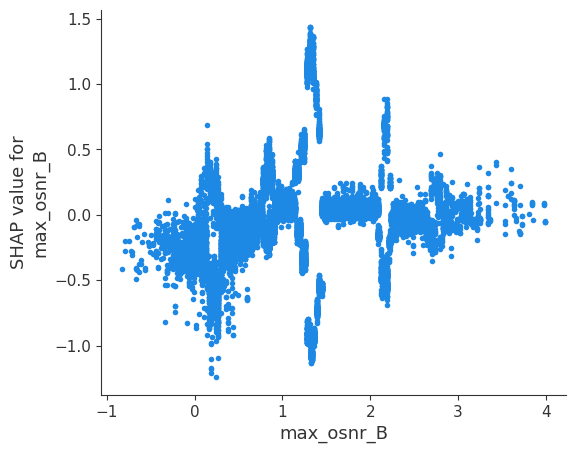

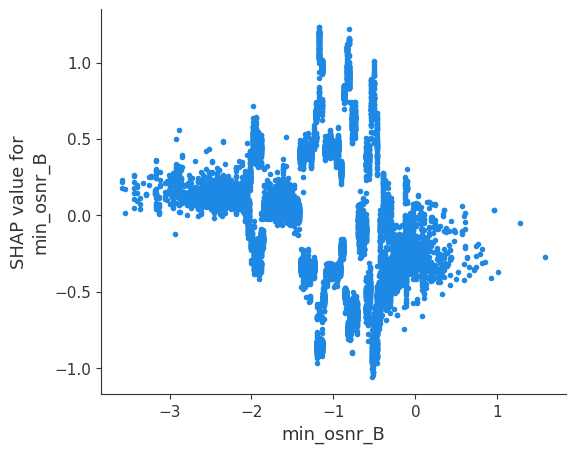

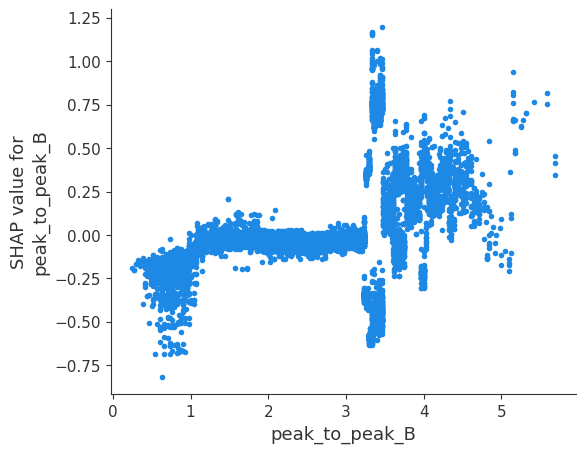

...

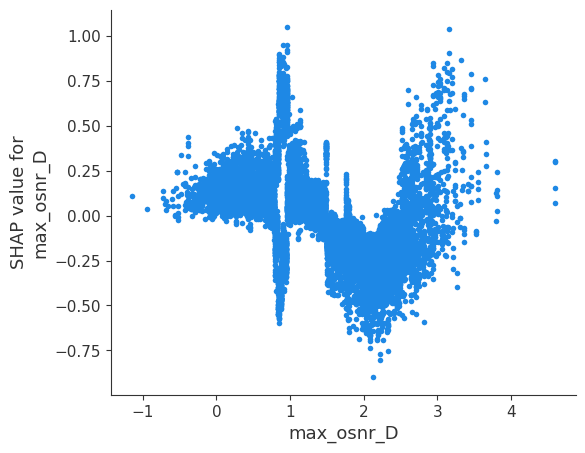

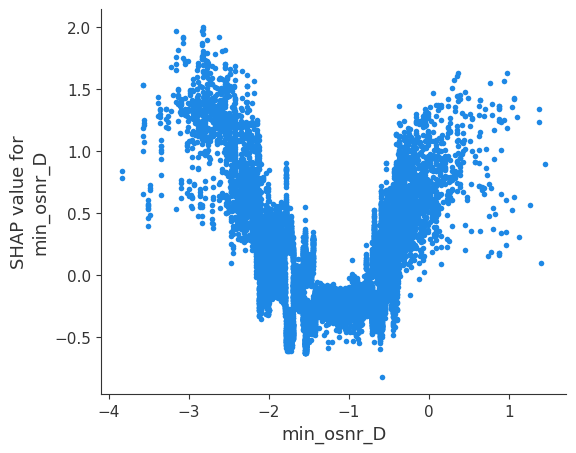

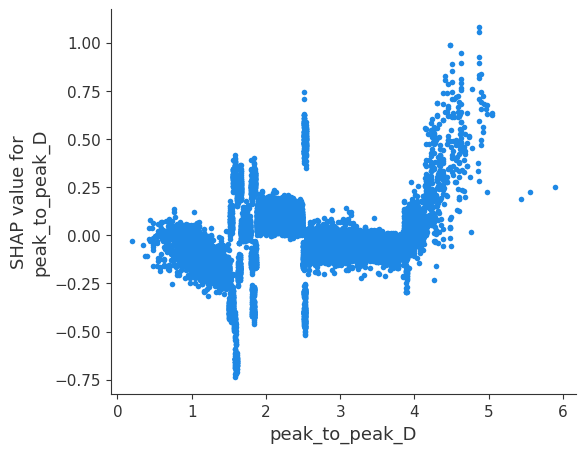

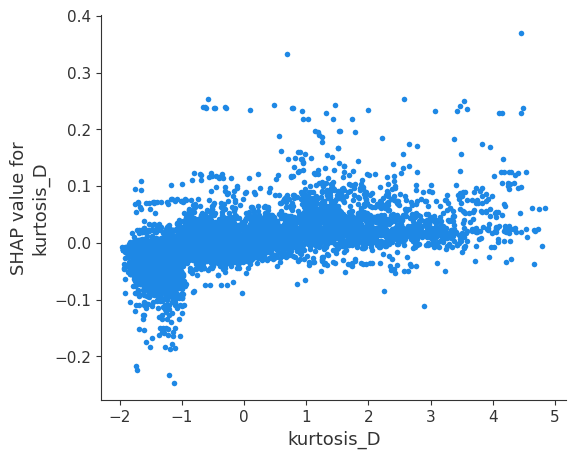

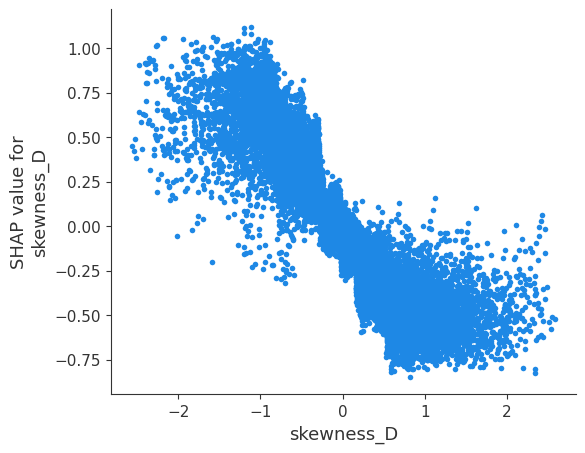

Link  3


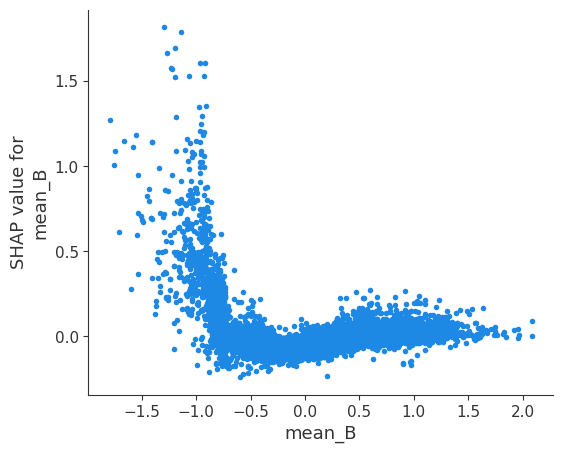

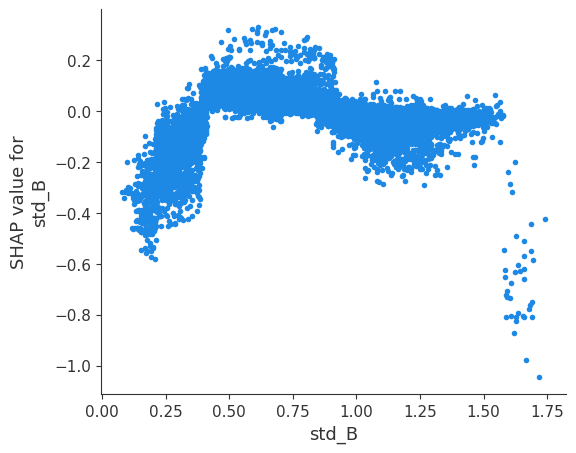

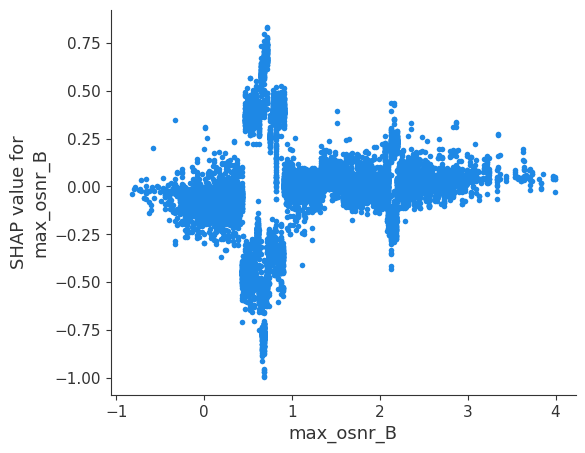

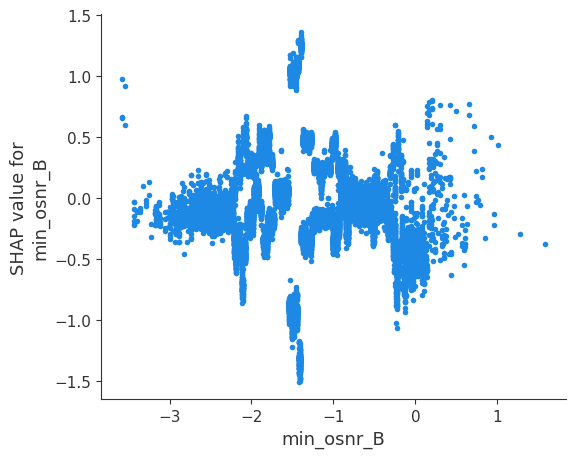

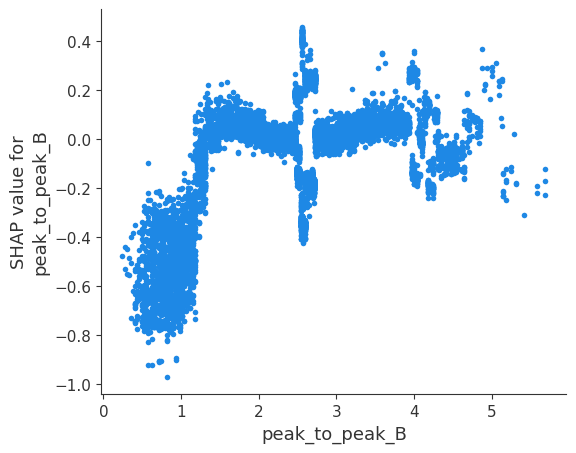

...

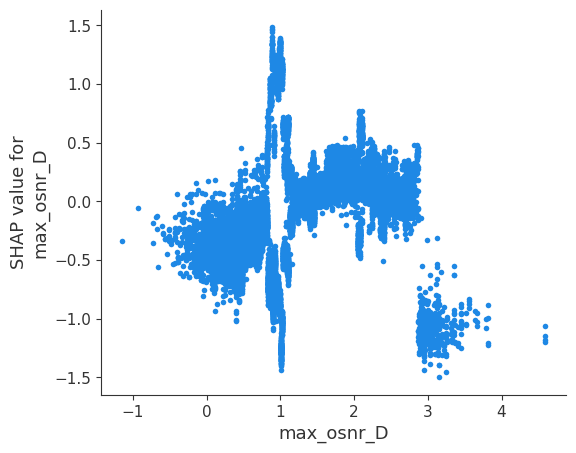

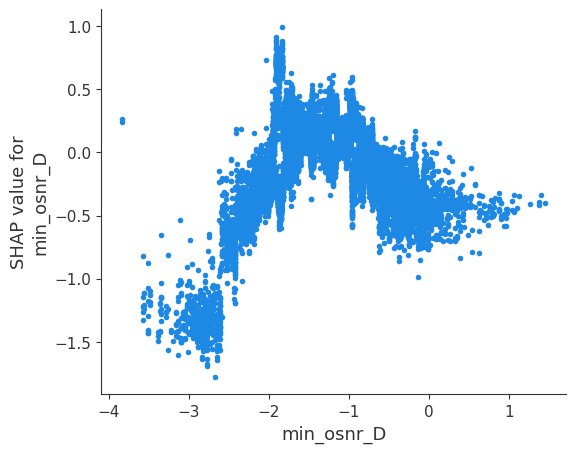

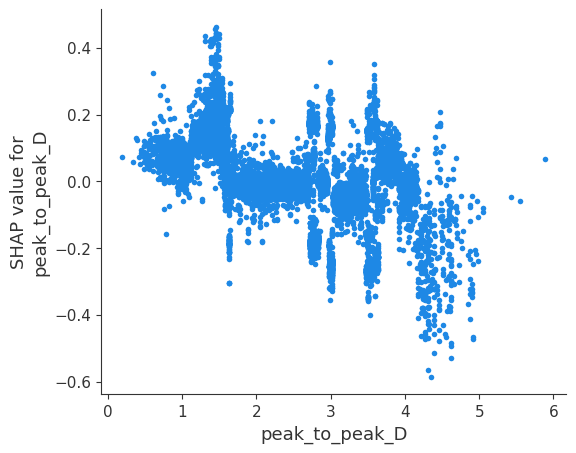

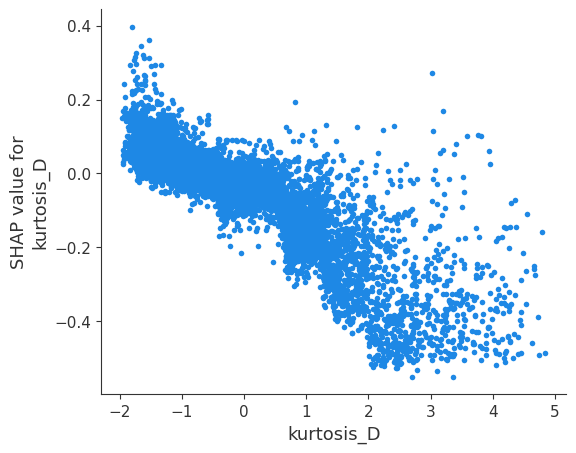

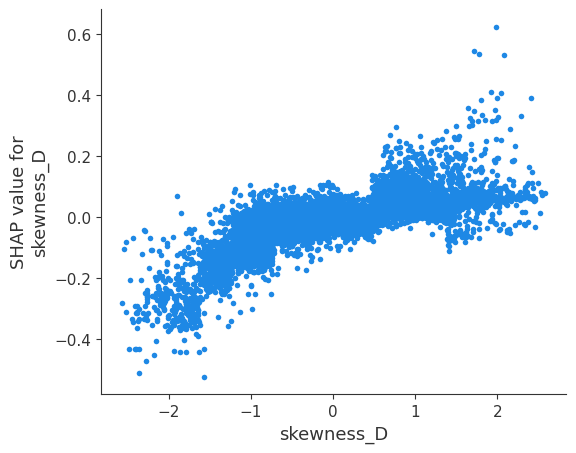

In [244]:
for label_idx in range(3):
  print("Link ", label_idx + 1)
  for feature_idx, feature_name in enumerate(X.columns):
    shap.dependence_plot(feature_idx, shap_values[label_idx], X_test_initial, interaction_index=None, feature_names=X_test_initial.columns)

Partial Data

Average Train accuracy:  0.9712622577005201
Average Test accuracy: 0.9719946480032935
******************************************
Best Test accuracy: 0.9732400164676822


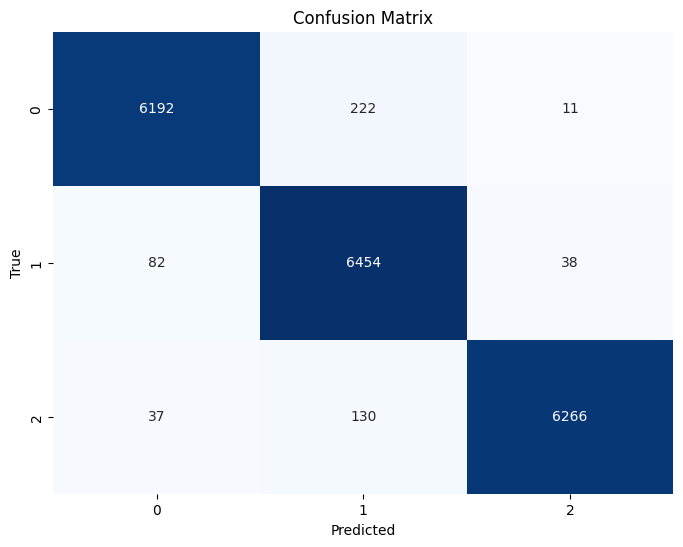

In [245]:
df = end_df.copy()

train_df, test_df = in_time_spliter(df, 10, 1, 0.7)

# Shuffling the data
train_df = train_df.sample(frac=1, random_state=42)
test_df = test_df.sample(frac=1, random_state=42)

label_encoder = LabelEncoder()

# Split the data into features (X) and target variable (y)
X_train_initial = train_df.drop('link', axis=1)
y_train_initial = train_df['link']
y_train_initial = label_encoder.fit_transform(y_train_initial)


X_test_initial = test_df.drop('link', axis=1)
y_test_initial = test_df['link']
y_test_initial = label_encoder.fit_transform(y_test_initial)

# Split the data into features (X) and target variable (y)
X = df.drop('link', axis=1)
y = df['link']

label_encoder = LabelEncoder()
y = label_encoder.fit_transform(y)

# Split data into initial train and test sets
X_train_initial, X_test_initial, y_train_initial, y_test_initial = train_test_split(X, y, test_size=0.3, random_state=42)

# Initialize the StratifiedKFold for hypermeter optimization
# Outer cross validation of 5 folds
outer_skf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

# Initialize a list to store the accuracies
accuracies = []
train_accuracies = []

# Choosing the best model to predict
best_model = None
best_score = 0.0

# Perform k-fold cross-validation
for train_index, test_index in outer_skf.split(X_train_initial, y_train_initial):
  X_train, X_test = X_train_initial.iloc[train_index], X_train_initial.iloc[test_index]
  y_train, y_test = y_train_initial[train_index], y_train_initial[test_index]

  # Hyperparam optimization
  model = xgb.XGBClassifier(objective='multi:softmax', num_class=3)

  model.fit(X_train, y_train)

  # Checking the best grid for training data
  y_pred = model.predict(X_test)

  # Metrics for training
  train_accuracy = accuracy_score(y_test, y_pred)

  # Checking the grid for test
  y_pred = model.predict(X_test_initial)
  accuracy = accuracy_score(y_test_initial, y_pred)

  # Saving the best model for more test
  if accuracy > best_score:
      best_score = accuracy
      best_model = model


  accuracies.append(accuracy)
  train_accuracies.append(train_accuracy)



# Compute the average accuracy across all folds
average_accuracy = np.mean(accuracies)
average_train_accuracy = np.mean(train_accuracies)


print("Average Train accuracy: ", average_train_accuracy)
print("Average Test accuracy:", average_accuracy)

print("******************************************")

print("Best Test accuracy:", best_score)

# drawing confusing matrix
y_pred_best = best_model.predict(X_test_initial)
confusion_best = confusion_matrix(y_test_initial, y_pred_best)
plt.figure(figsize=(8, 6))
sns.heatmap(confusion_best, annot=True, cmap='Blues', fmt='d', cbar=False)
plt.title('Confusion Matrix')
plt.xlabel('Predicted')
plt.ylabel('True')
plt.show()

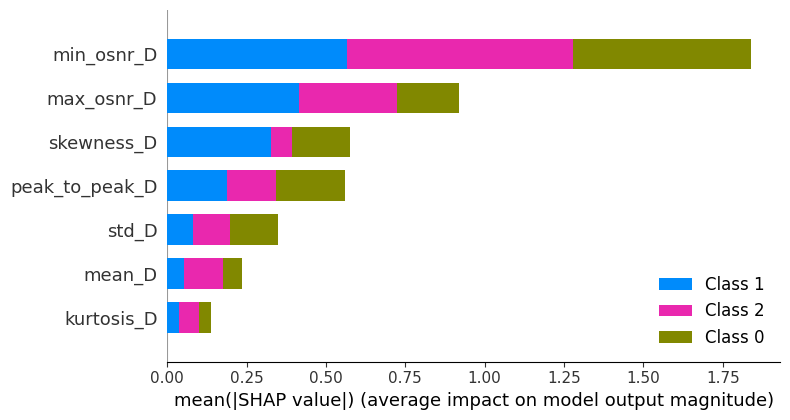

In [246]:
# Initialize the explainer
explainer = shap.TreeExplainer(best_model)

# Generate SHAP values for the test data
shap_values = explainer.shap_values(X_test_initial)

# Global summary plot
shap.summary_plot(shap_values, X_test_initial)

Link  1


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


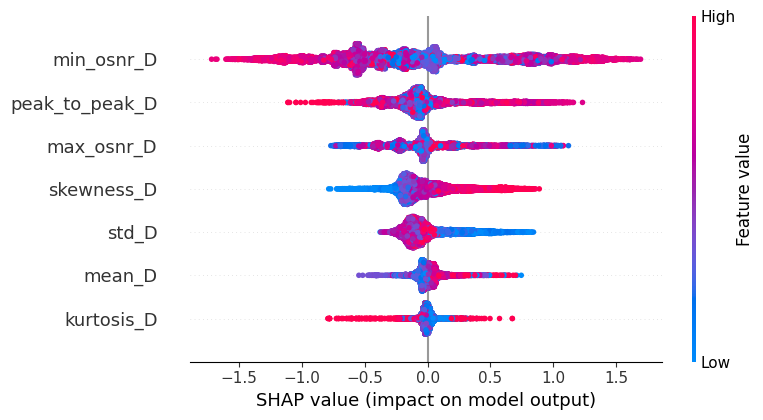

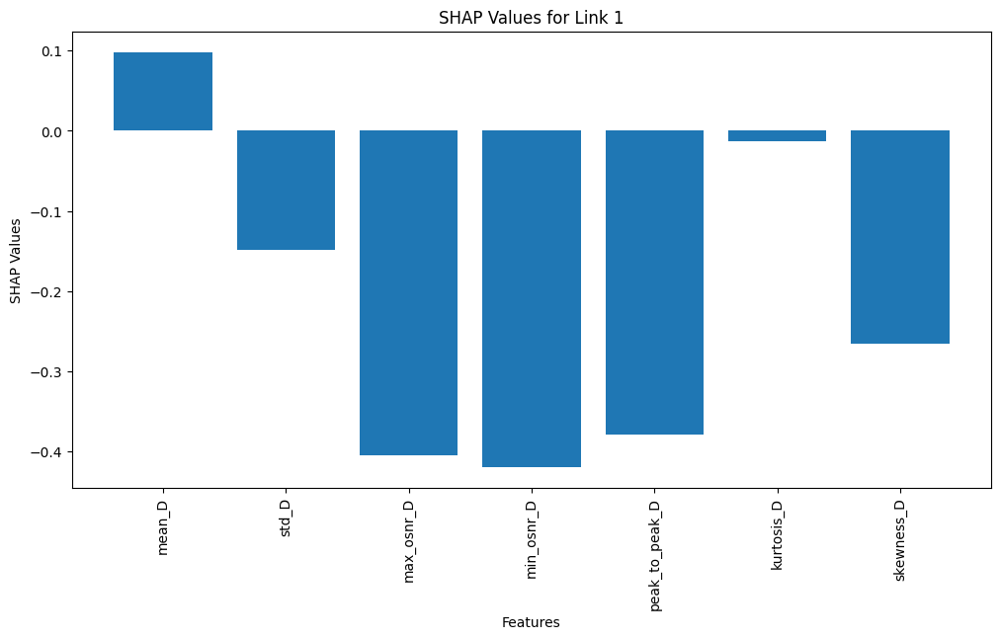

Link  2


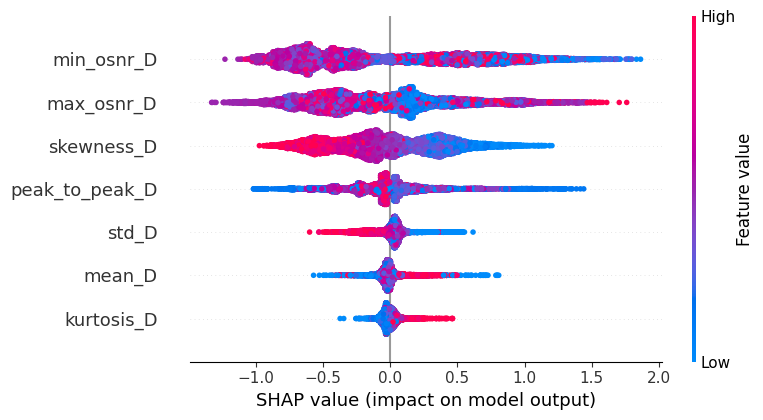

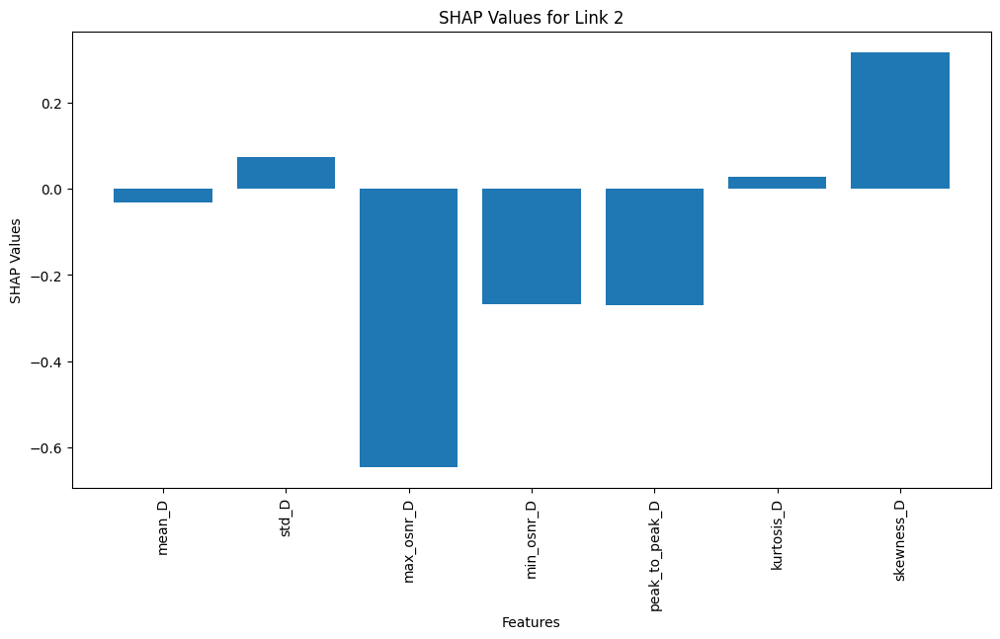

Link  3


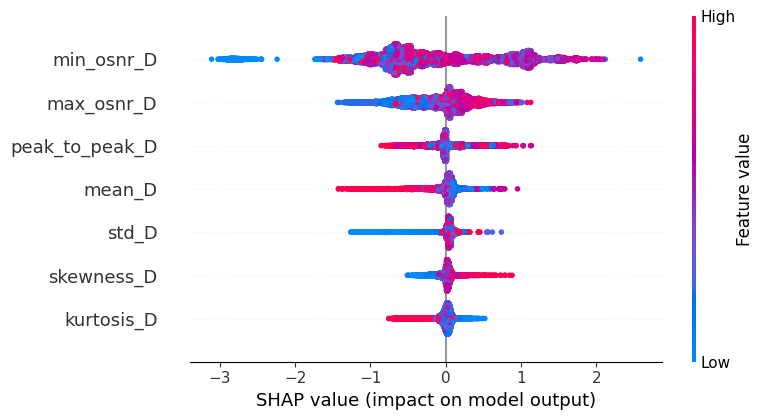

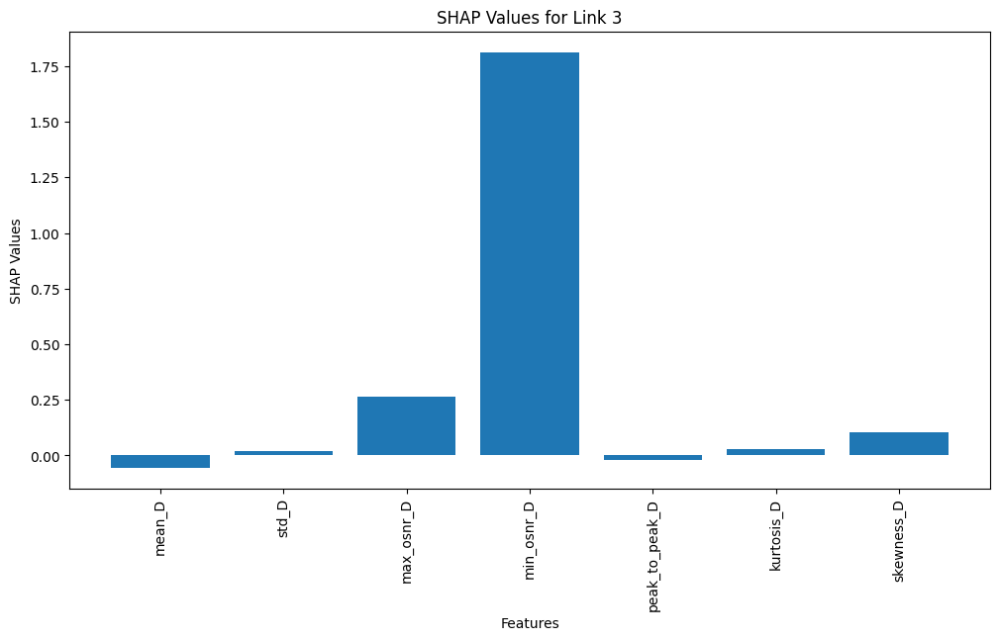

In [247]:
# Separate plots for each label
for label_idx in range(3):
    print("Link ", label_idx + 1)
    # Summary plot
    shap.summary_plot(shap_values[label_idx], X_test_initial, class_names=["1", "2", "3"], show=False)


    # Bar plot for a specific instance (e.g., instance at index 0)
    plt.figure(figsize=(12, 6))
    shap_values_label = shap_values[label_idx][0]
    plt.bar(range(len(shap_values_label)), shap_values_label)
    plt.xticks(range(len(shap_values_label)), X_test_initial.columns, rotation=90, ha='center')
    plt.xlabel("Features")
    plt.ylabel("SHAP Values")
    plt.title("SHAP Values for Link " + str(label_idx + 1))
    plt.show()

Link  1


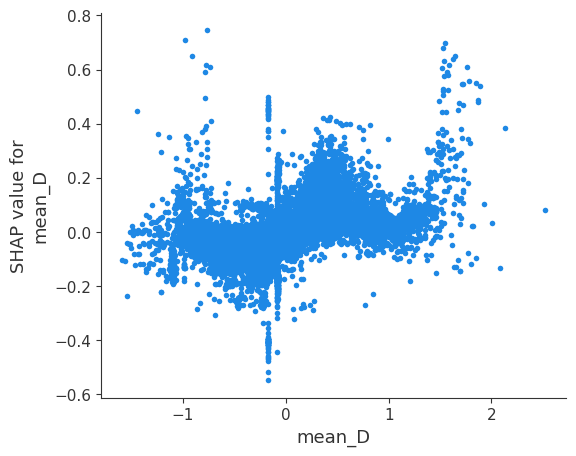

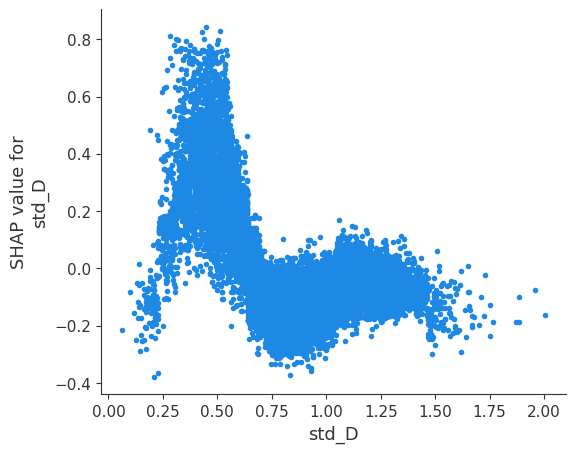

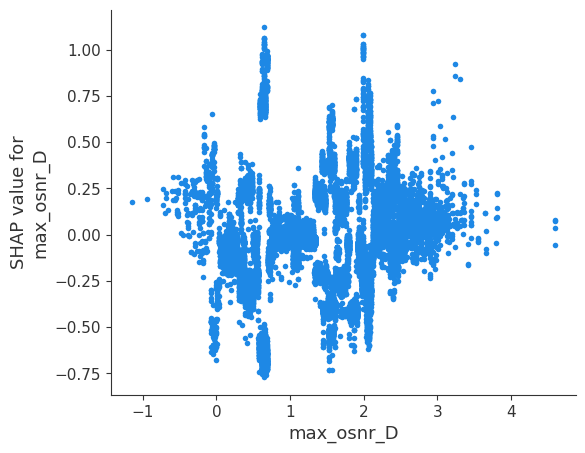

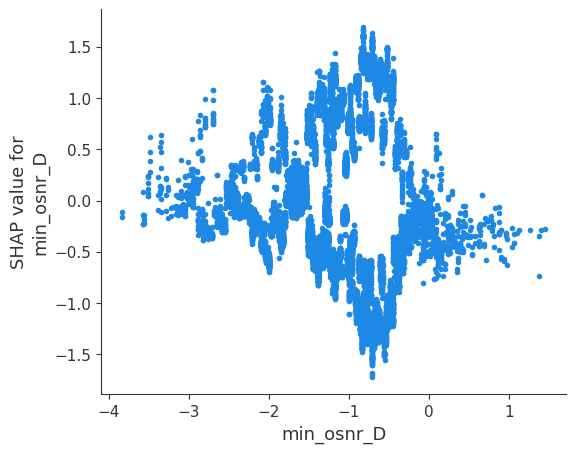

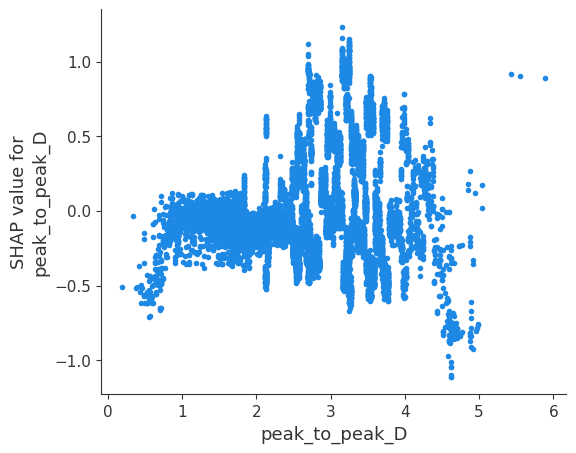

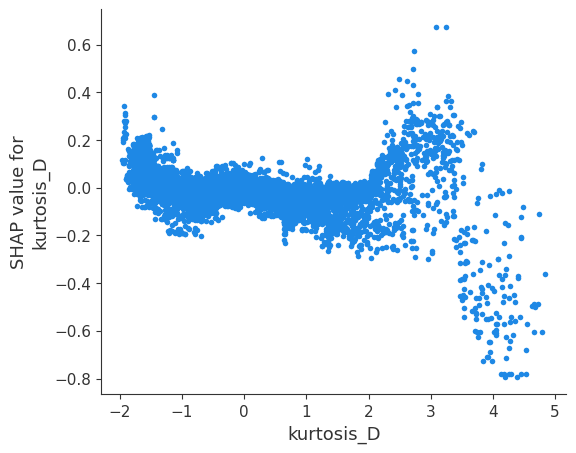

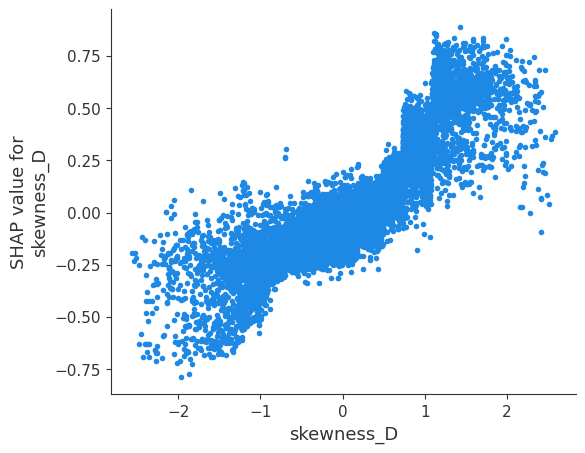

Link  2


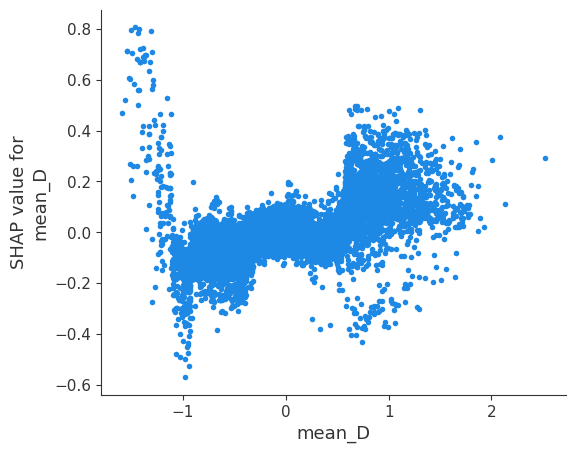

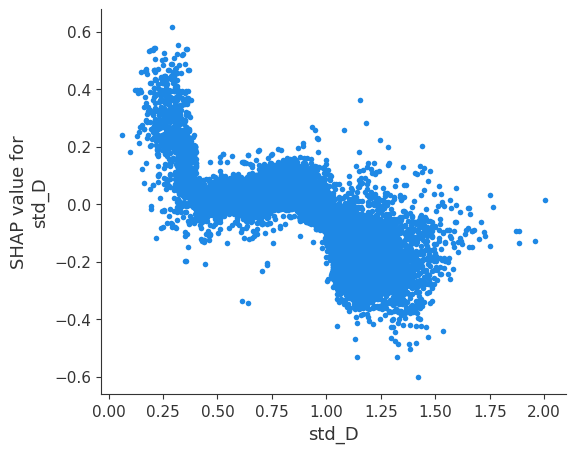

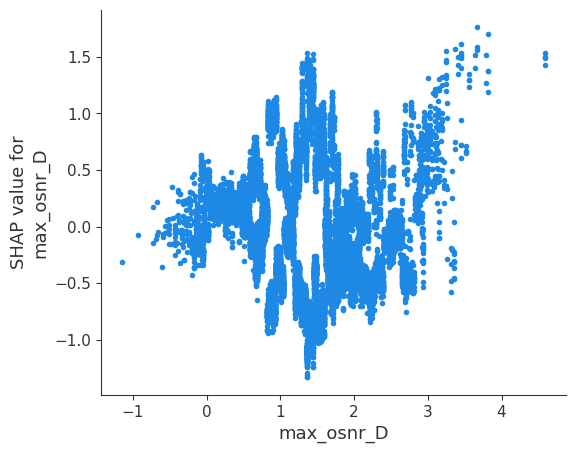

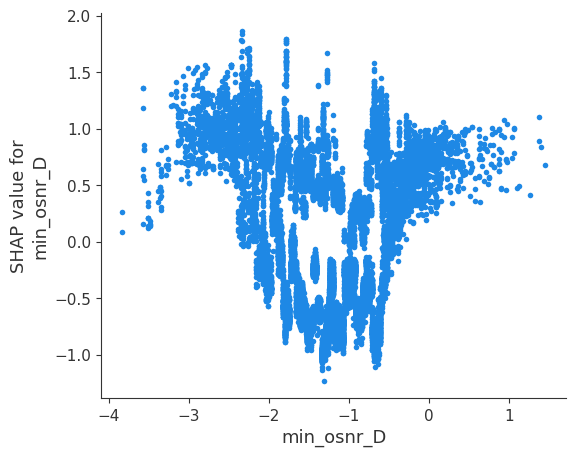

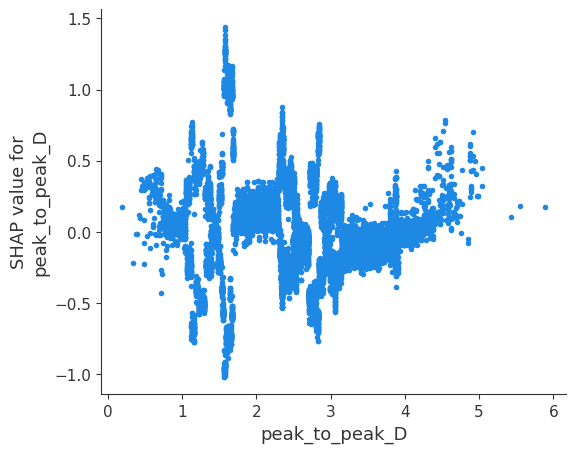

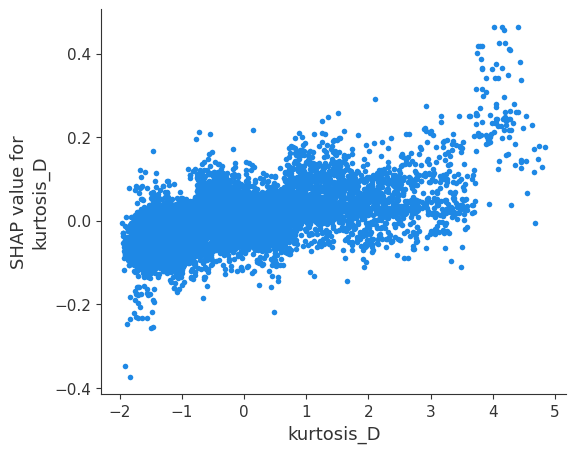

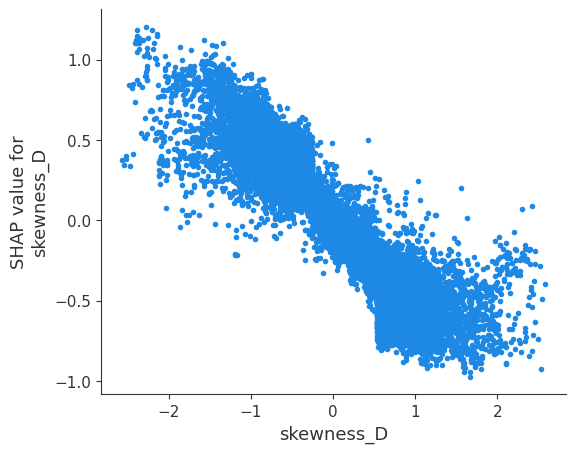

Link  3


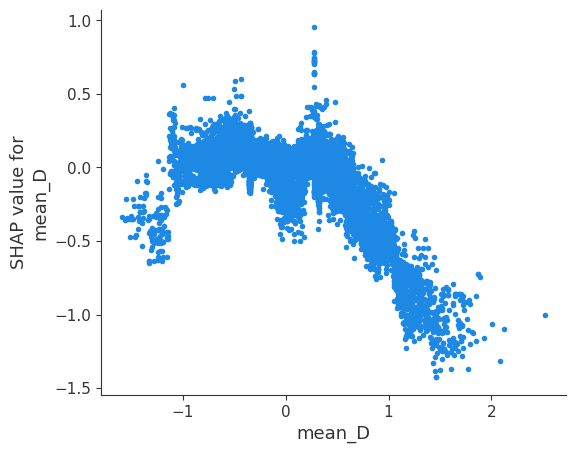

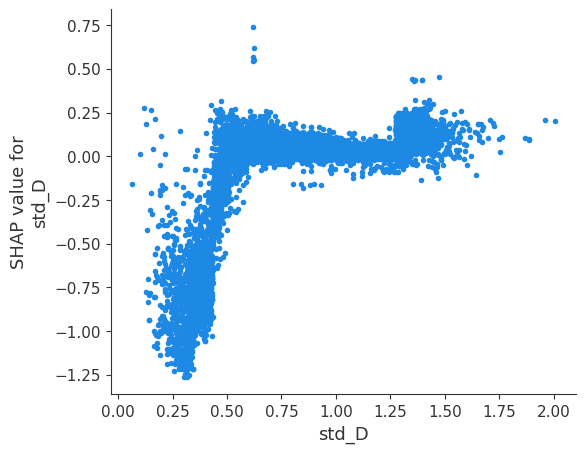

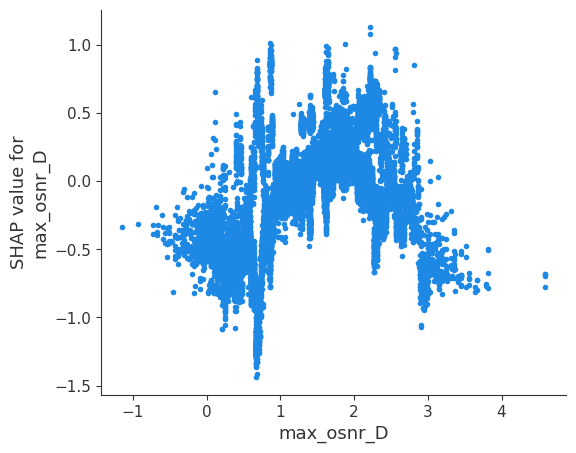

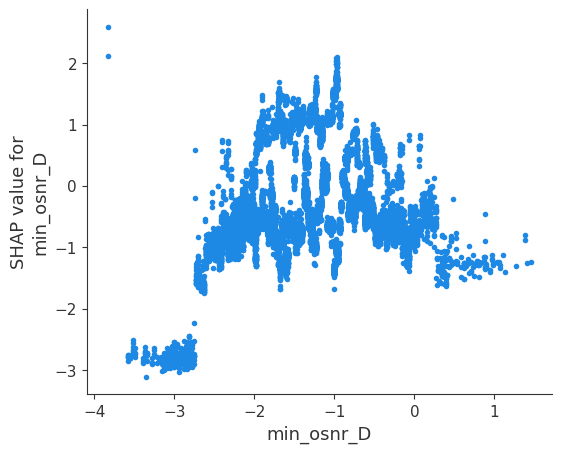

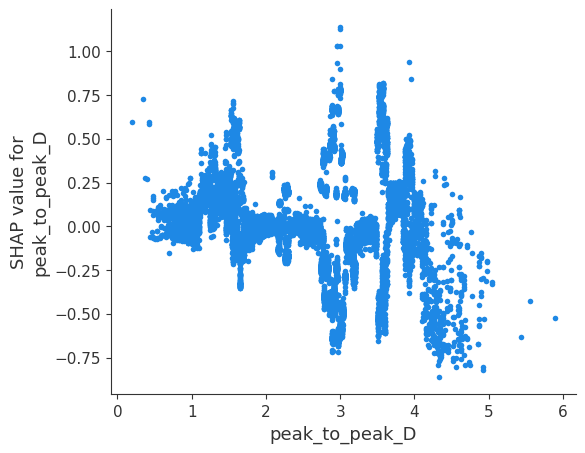

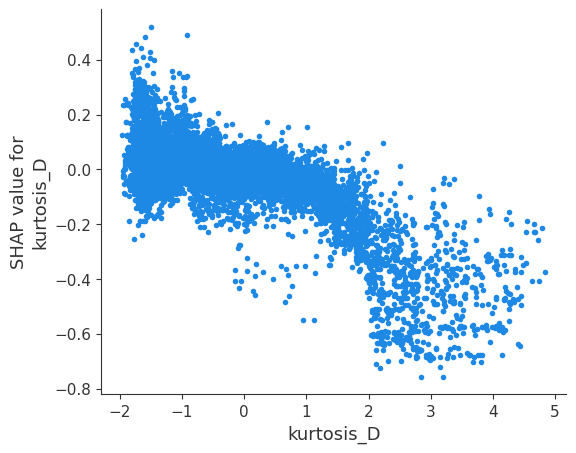

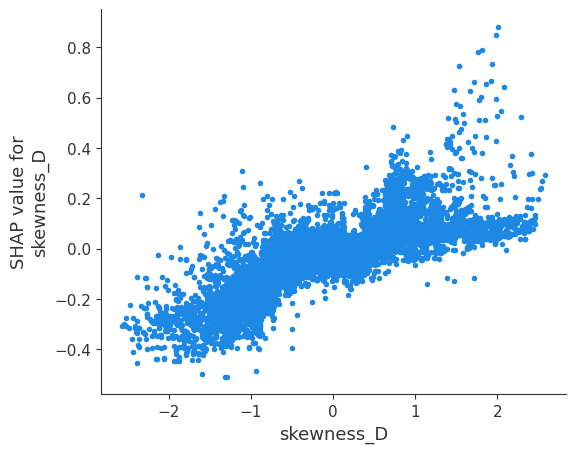

In [248]:
for label_idx in range(3):
  print("Link ", label_idx + 1)
  for feature_idx, feature_name in enumerate(X.columns):
    shap.dependence_plot(feature_idx, shap_values[label_idx], X_test_initial, interaction_index=None, feature_names=X_test_initial.columns)

### 3.3 Big Windows

#### 3.3.1 Random XGBoost

Average Train accuracy:  0.9734577064936257
Average Test accuracy: 0.9858064516129031
******************************************
Best Test accuracy: 0.9883870967741936


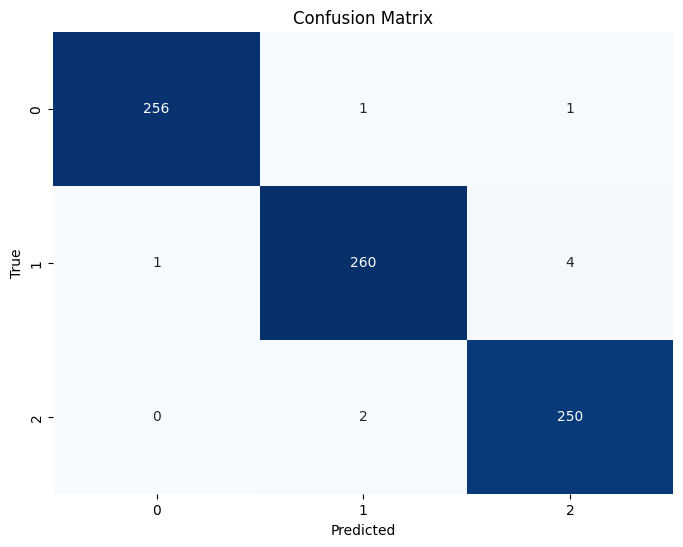

In [249]:
df = new_final_df.copy()

scaler = StandardScaler()
X_scaled = scaler.fit_transform(df.drop('link', axis=1))
df_scaled = pd.DataFrame(X_scaled, columns=df.columns[:-1])
df_scaled['link'] = df['link']
df = df_scaled

# Split the data into features (X) and target variable (y)
X = df.drop('link', axis=1)
y = df['link']

label_encoder = LabelEncoder()
y = label_encoder.fit_transform(y)

# Split data into initial train and test sets
X_train_initial, X_test_initial, y_train_initial, y_test_initial = train_test_split(X, y, test_size=0.3, random_state=42)

# Initialize the StratifiedKFold for hypermeter optimization
# Outer cross validation of 5 folds
outer_skf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

# Initialize a list to store the accuracies
accuracies = []
train_accuracies = []

# Choosing the best model to predict
best_model = None
best_score = 0.0

# Perform k-fold cross-validation
for train_index, test_index in outer_skf.split(X_train_initial, y_train_initial):
  X_train, X_test = X_train_initial.iloc[train_index], X_train_initial.iloc[test_index]
  y_train, y_test = y_train_initial[train_index], y_train_initial[test_index]

  # Hyperparam optimization
  model = xgb.XGBClassifier(objective='multi:softmax', num_class=3)

  model.fit(X_train, y_train)

  # Checking the best grid for training data
  y_pred = model.predict(X_test)

  # Metrics for training
  train_accuracy = accuracy_score(y_test, y_pred)

  # Checking the grid for test
  y_pred = model.predict(X_test_initial)
  accuracy = accuracy_score(y_test_initial, y_pred)

  # Saving the best model for more test
  if accuracy > best_score:
      best_score = accuracy
      best_model = model


  accuracies.append(accuracy)
  train_accuracies.append(train_accuracy)



# Compute the average accuracy across all folds
average_accuracy = np.mean(accuracies)
average_train_accuracy = np.mean(train_accuracies)


print("Average Train accuracy: ", average_train_accuracy)
print("Average Test accuracy:", average_accuracy)

print("******************************************")

print("Best Test accuracy:", best_score)

# drawing confusing matrix
y_pred_best = best_model.predict(X_test_initial)
confusion_best = confusion_matrix(y_test_initial, y_pred_best)
plt.figure(figsize=(8, 6))
sns.heatmap(confusion_best, annot=True, cmap='Blues', fmt='d', cbar=False)
plt.title('Confusion Matrix')
plt.xlabel('Predicted')
plt.ylabel('True')
plt.show()

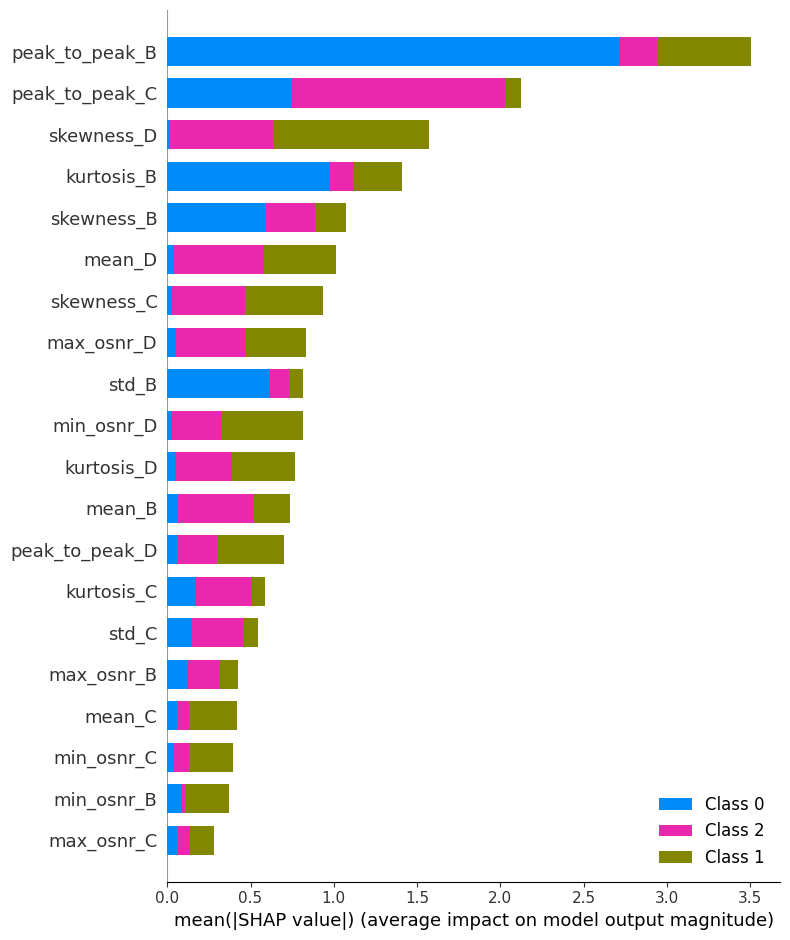

In [250]:
# Initialize the explainer
explainer = shap.TreeExplainer(best_model)

# Generate SHAP values for the test data
shap_values = explainer.shap_values(X_test_initial)

# Global summary plot
shap.summary_plot(shap_values, X_test_initial)

Link  1


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


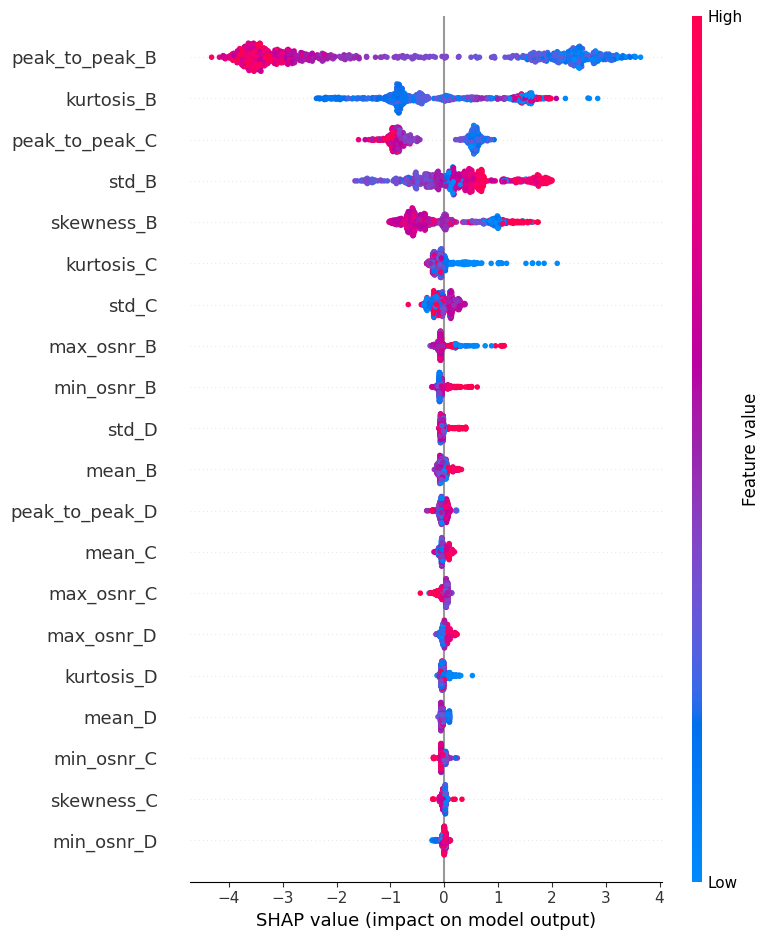

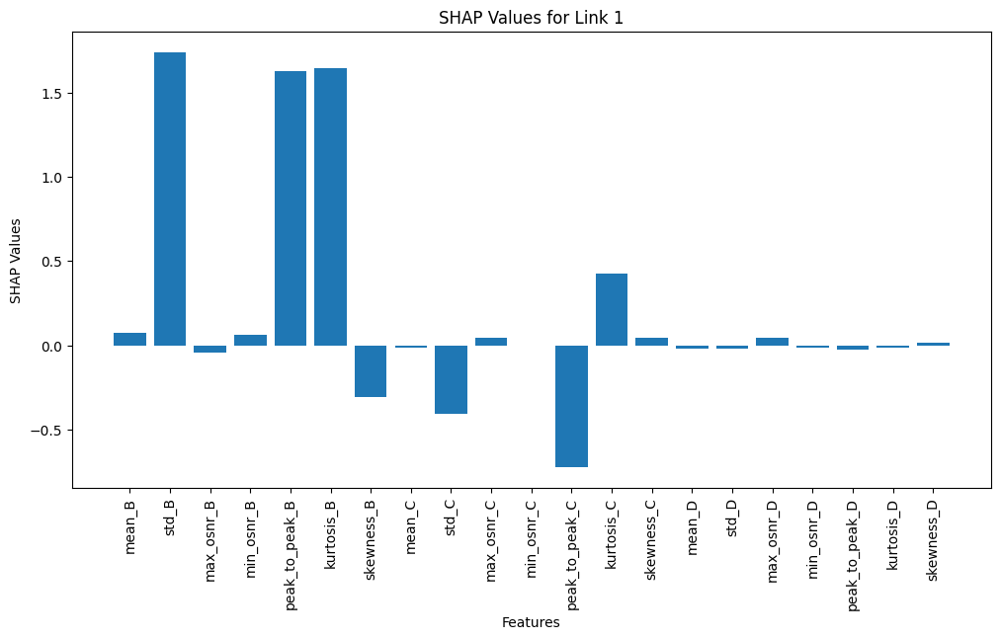

Link  2


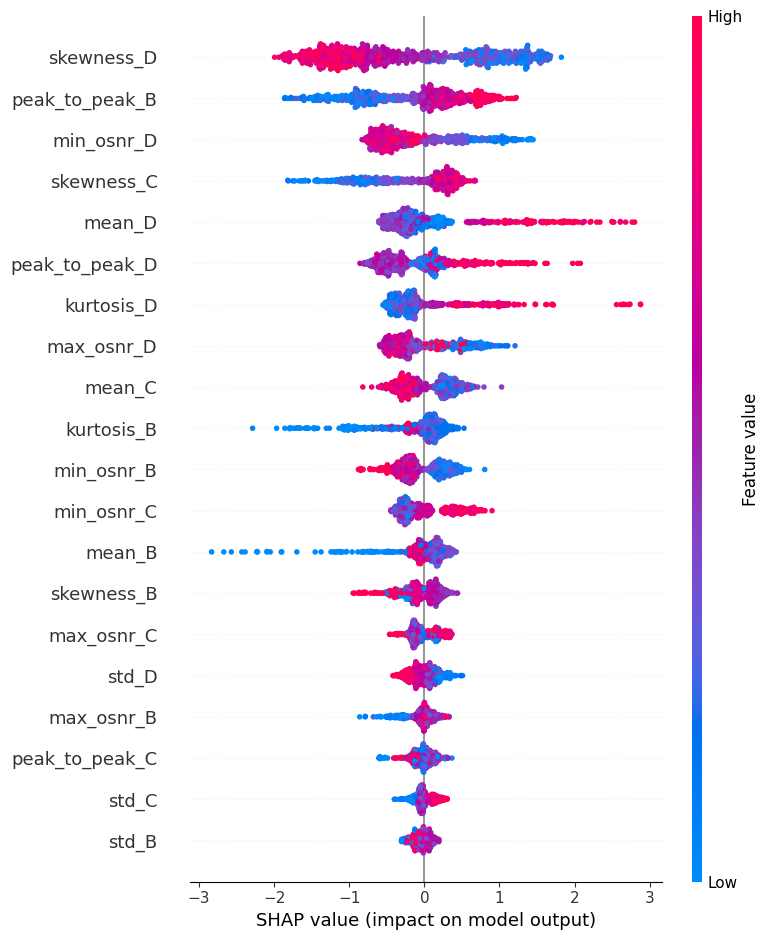

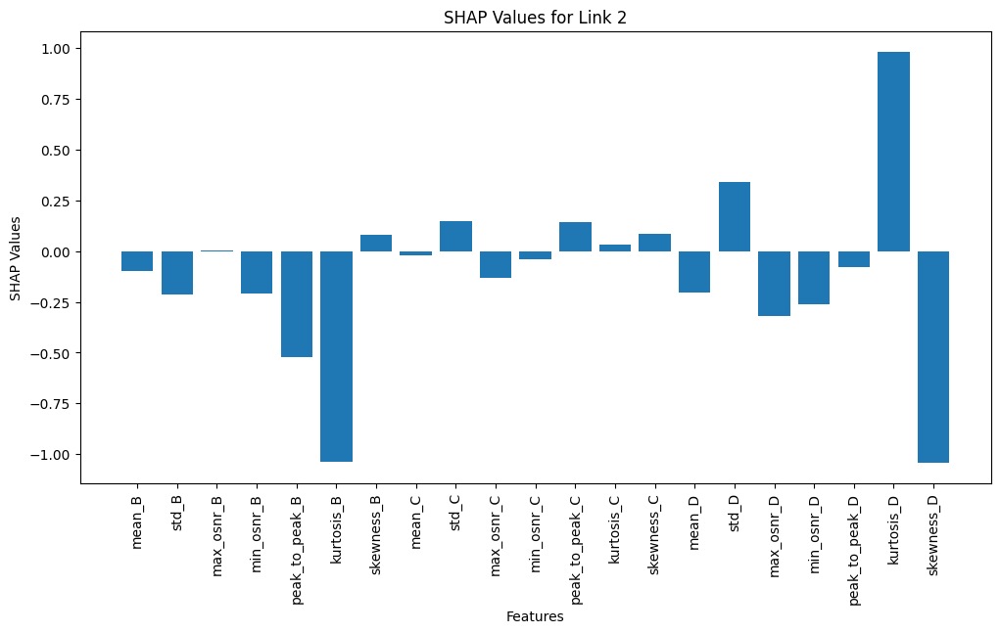

Link  3


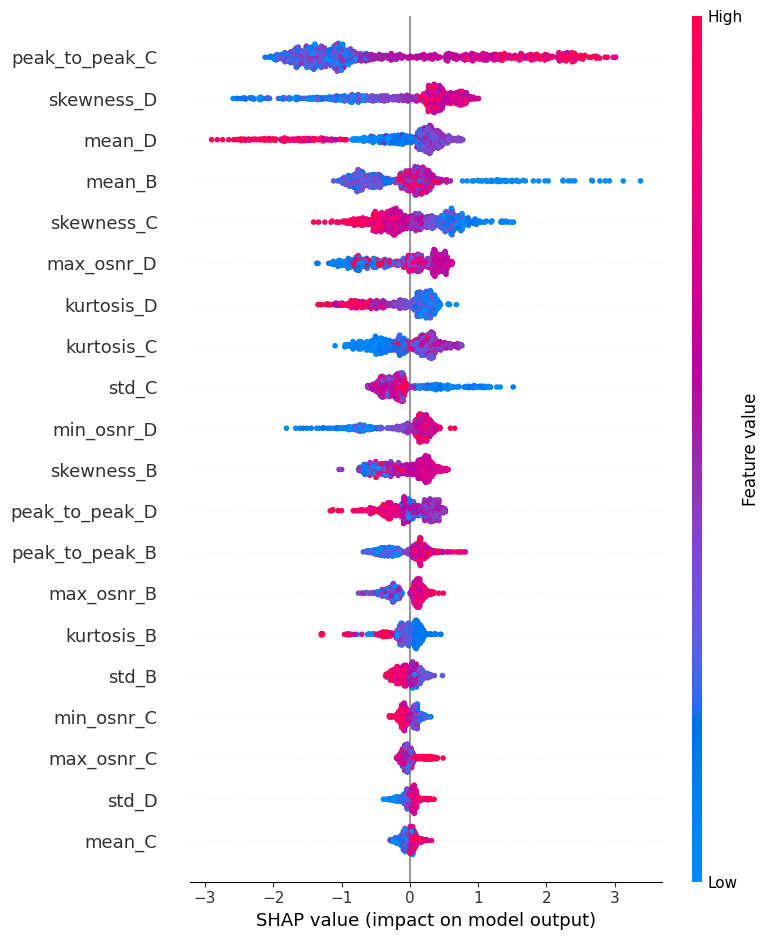

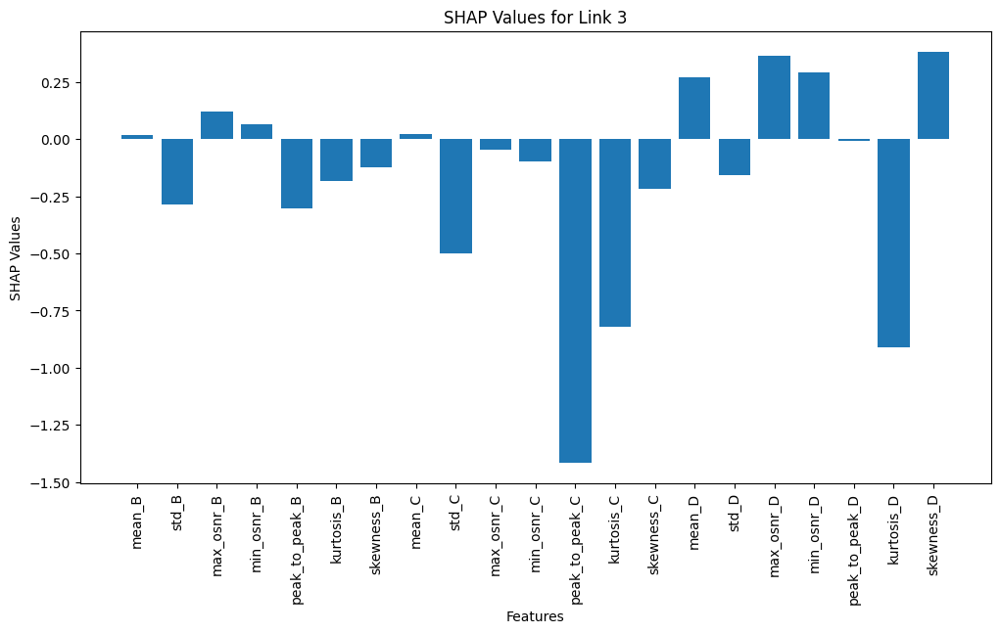

In [251]:
# Separate plots for each label
for label_idx in range(3):
    print("Link ", label_idx + 1)
    # Summary plot
    shap.summary_plot(shap_values[label_idx], X_test_initial, class_names=["1", "2", "3"], show=False)


    # Bar plot for a specific instance (e.g., instance at index 0)
    plt.figure(figsize=(12, 6))
    shap_values_label = shap_values[label_idx][0]
    plt.bar(range(len(shap_values_label)), shap_values_label)
    plt.xticks(range(len(shap_values_label)), X_test_initial.columns, rotation=90, ha='center')
    plt.xlabel("Features")
    plt.ylabel("SHAP Values")
    plt.title("SHAP Values for Link " + str(label_idx + 1))
    plt.show()

Link  1


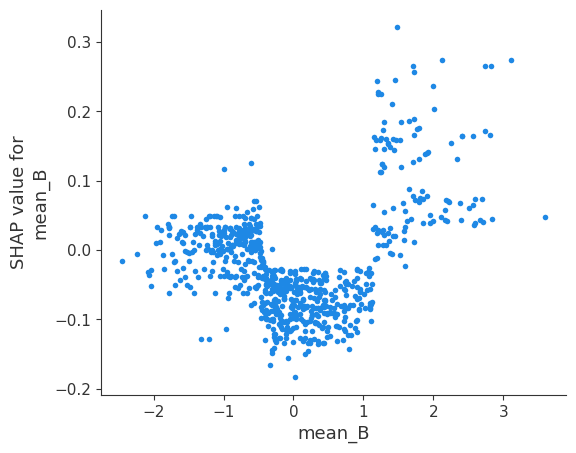

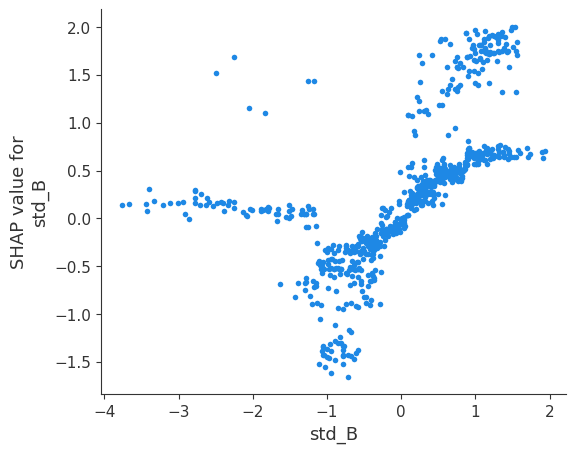

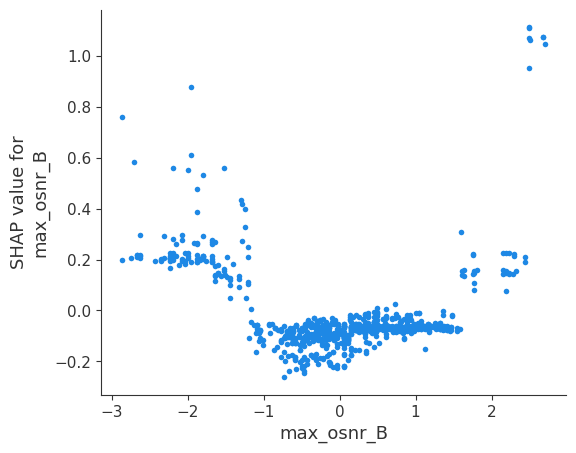

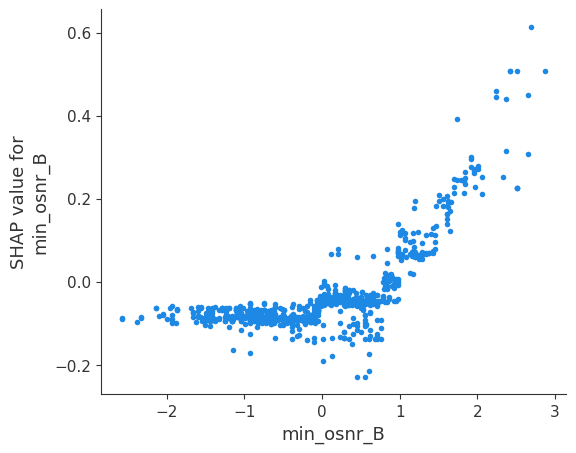

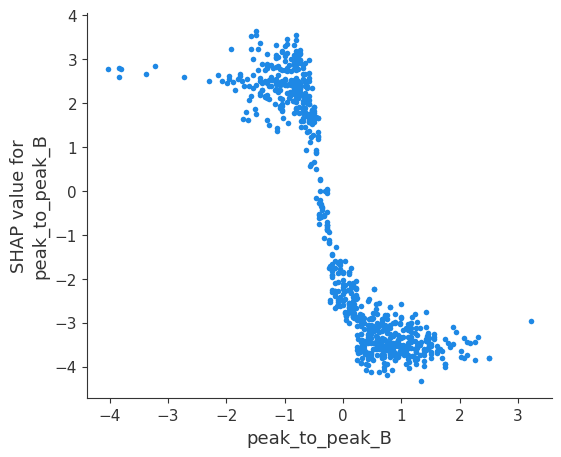

...

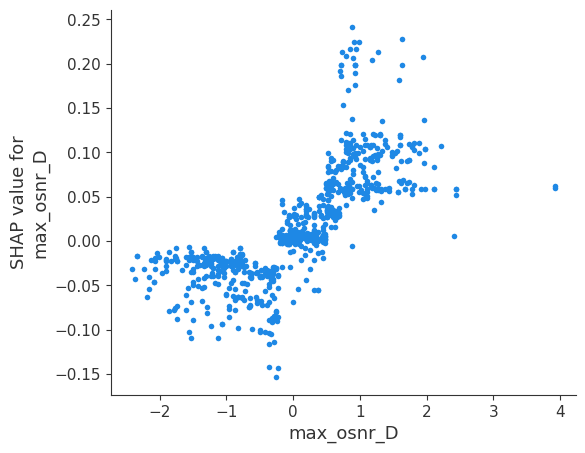

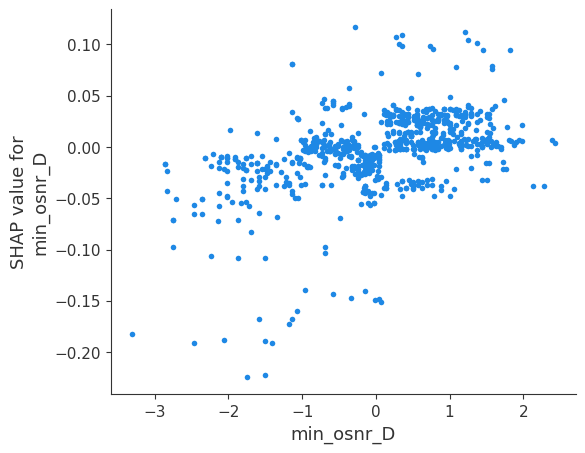

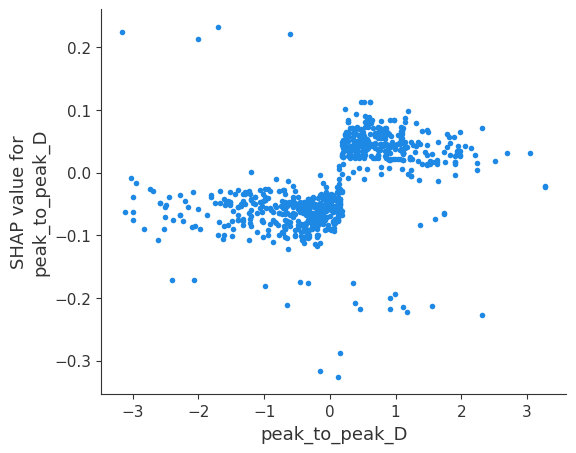

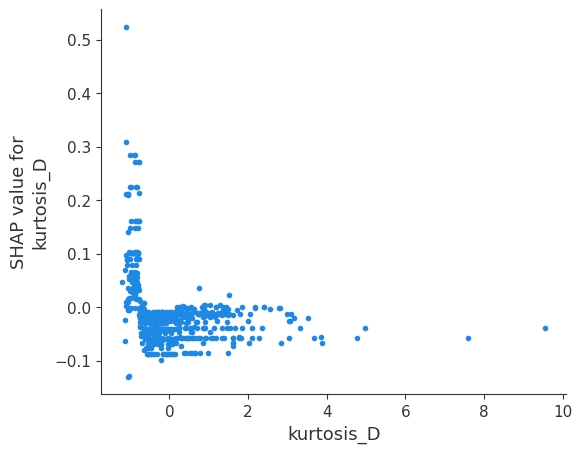

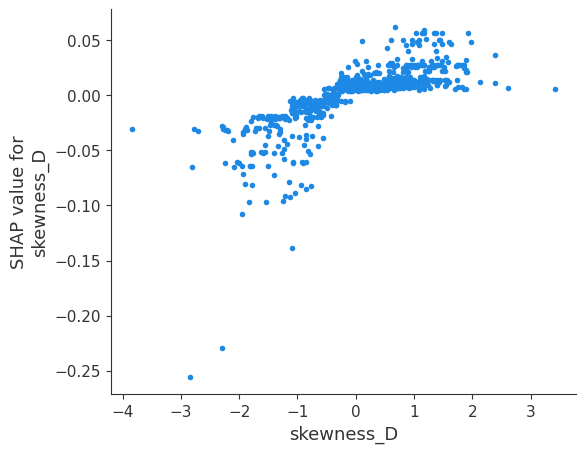

Link  2


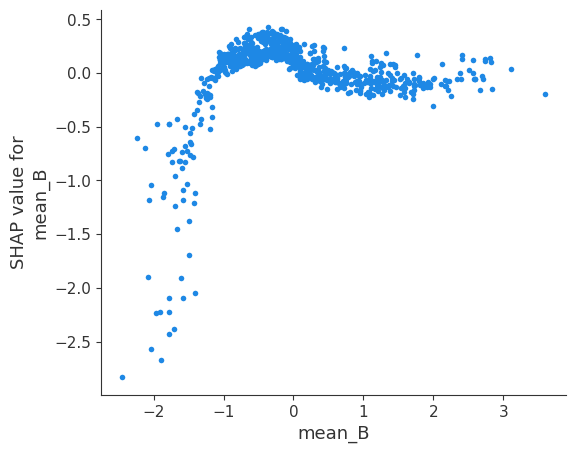

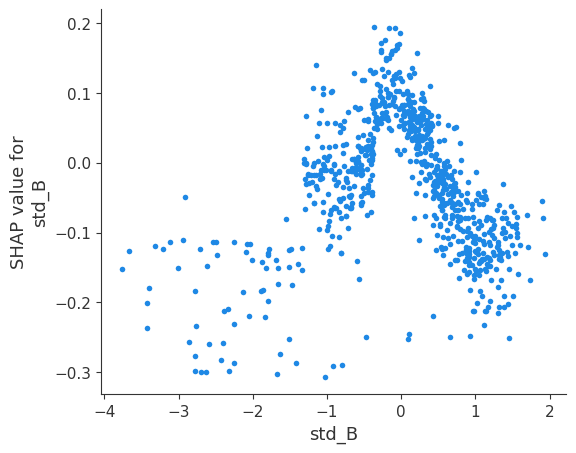

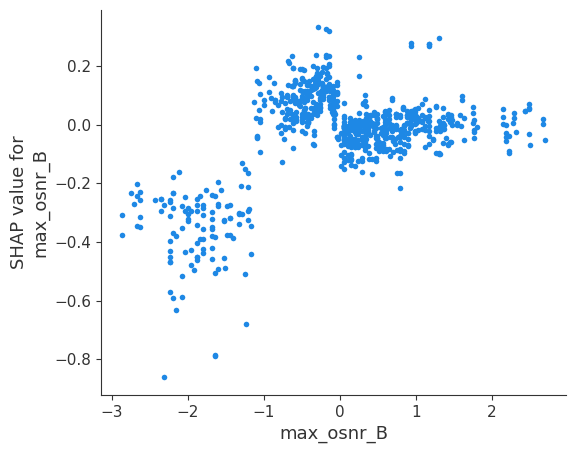

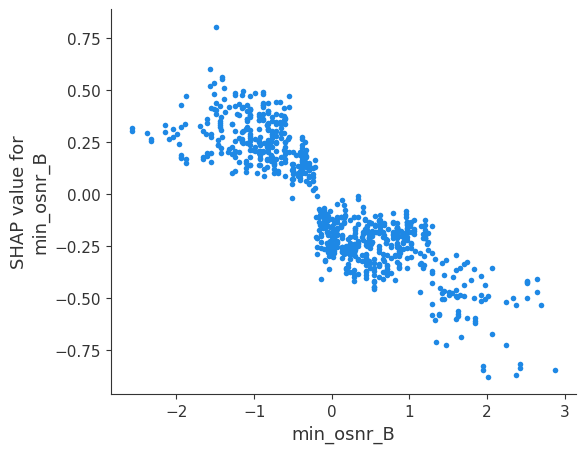

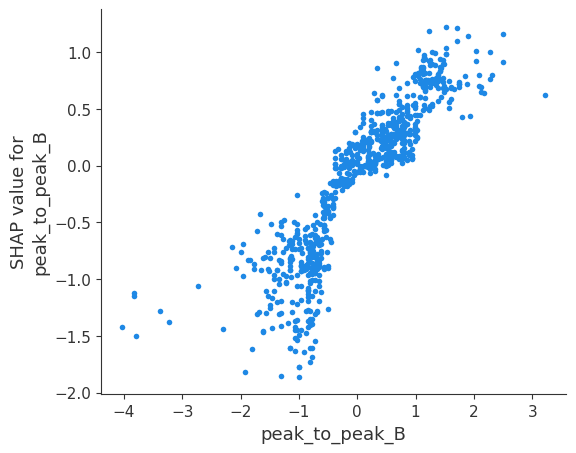

...

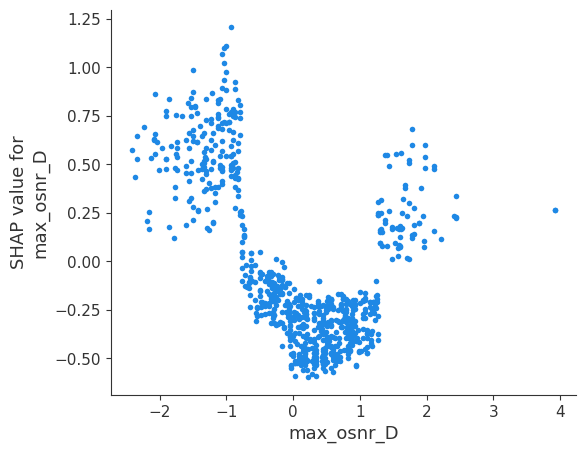

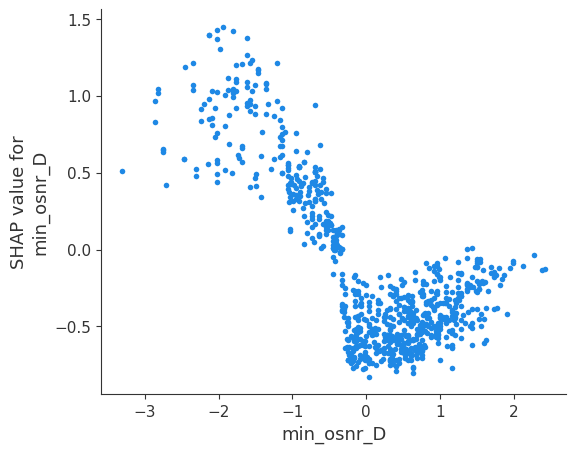

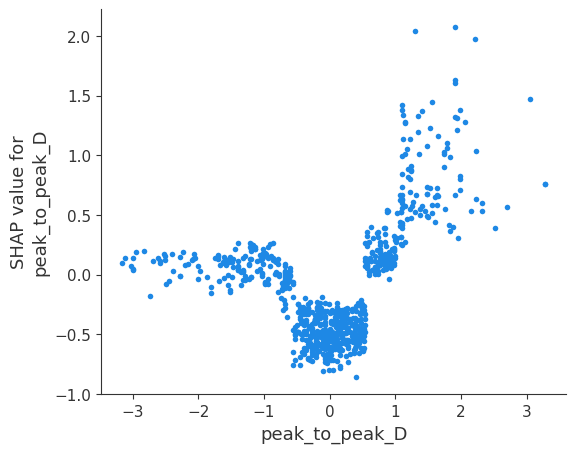

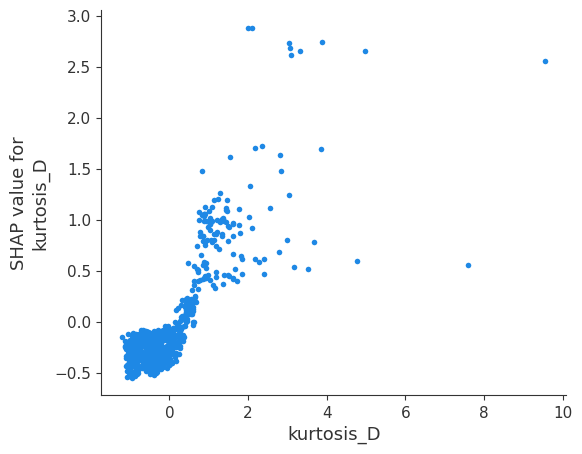

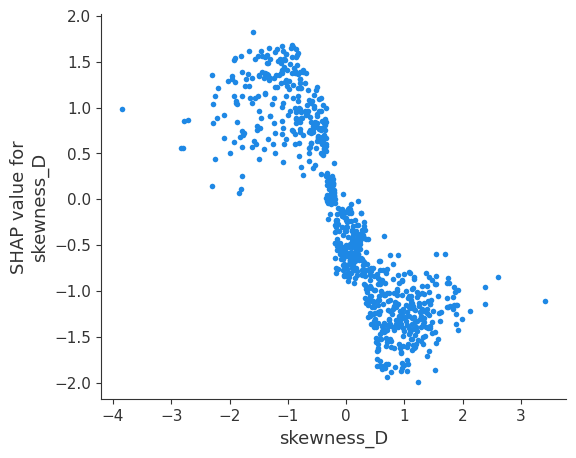

Link  3


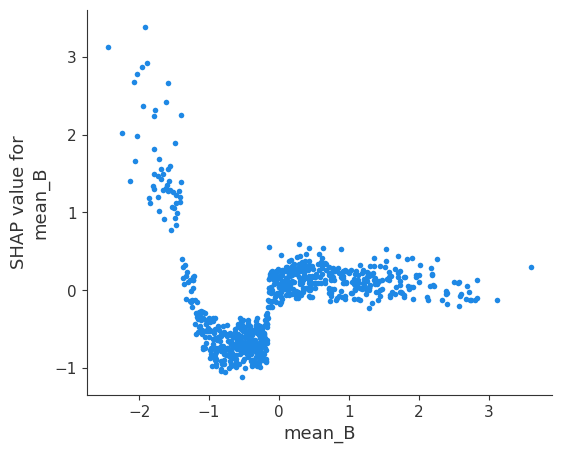

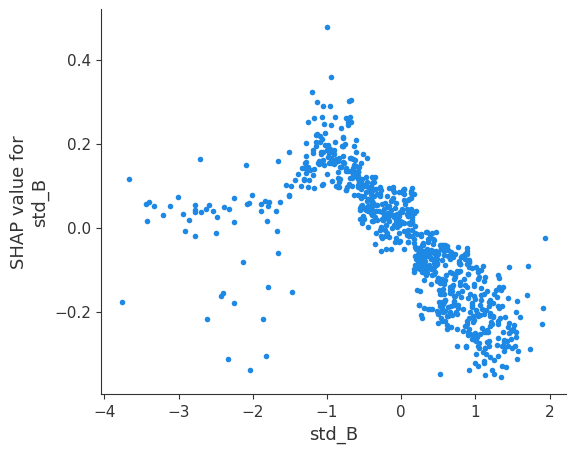

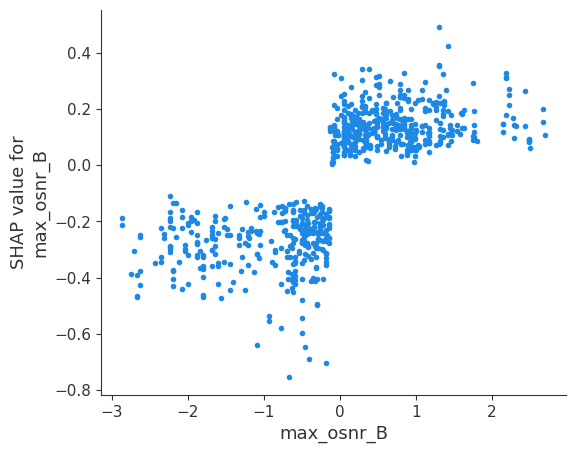

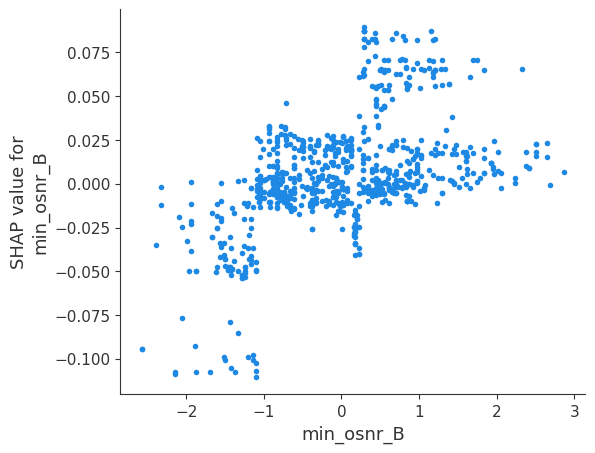

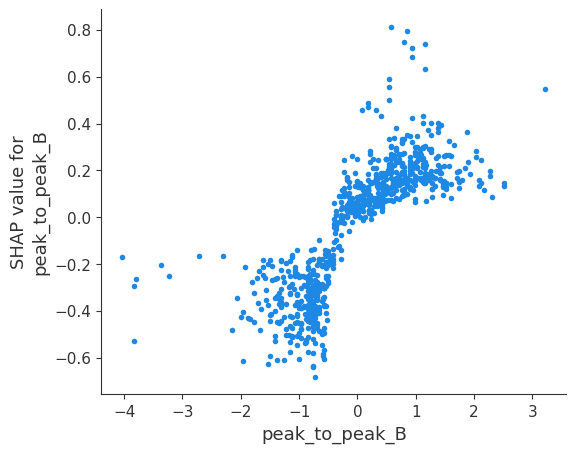

...

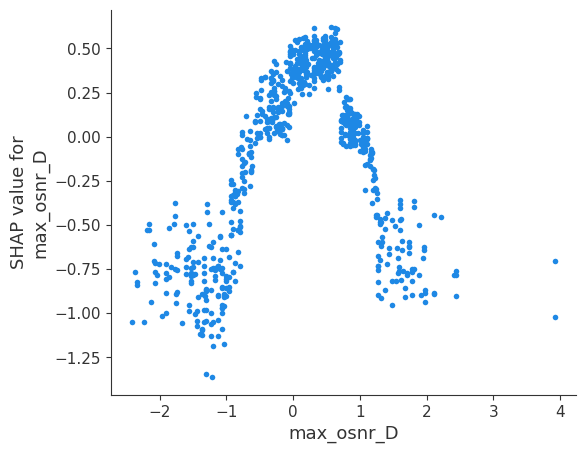

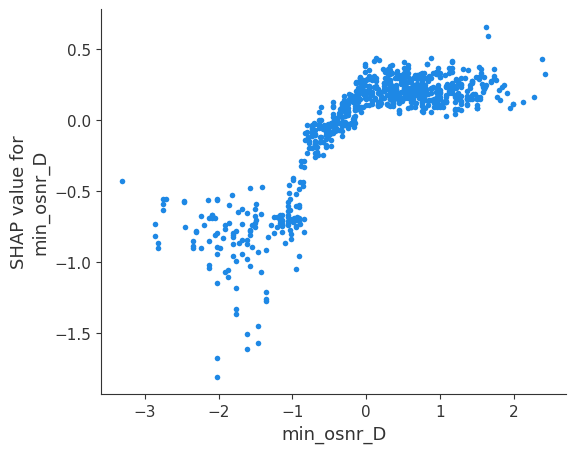

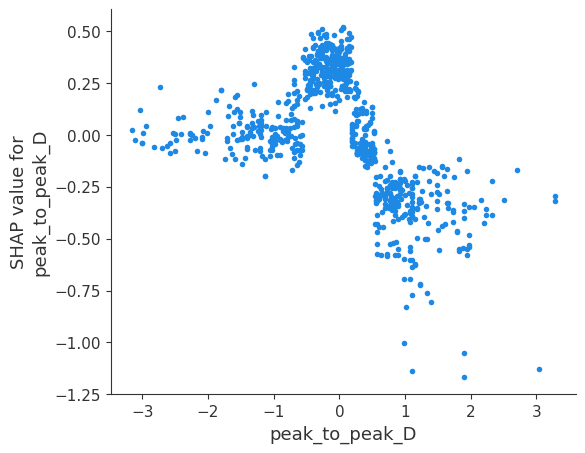

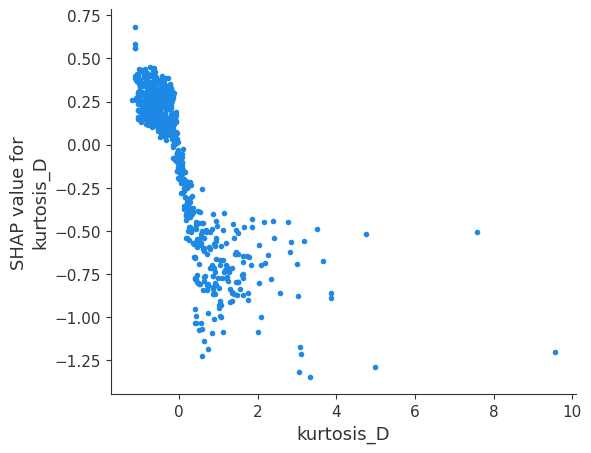

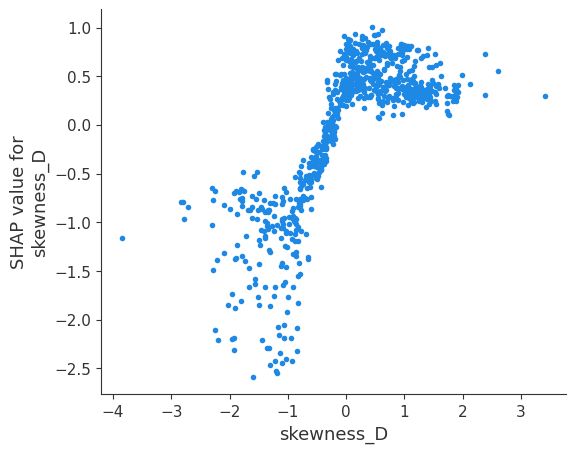

In [252]:
for label_idx in range(3):
  print("Link ", label_idx + 1)
  for feature_idx, feature_name in enumerate(X.columns):
    shap.dependence_plot(feature_idx, shap_values[label_idx], X_test_initial, interaction_index=None, feature_names=X_test_initial.columns)

Partial Data:


Average Train accuracy:  0.8777674048453499
Average Test accuracy: 0.9009032258064517
******************************************
Best Test accuracy: 0.9058064516129032


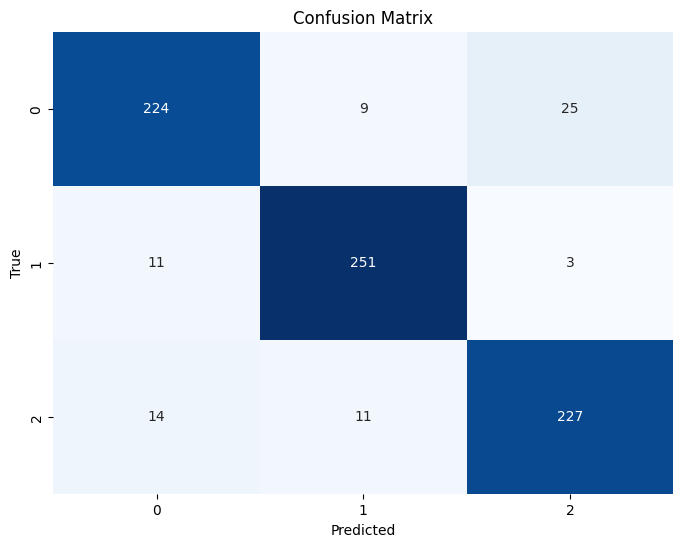

In [253]:
df = new_end_df.copy()

scaler = StandardScaler()
X_scaled = scaler.fit_transform(df.drop('link', axis=1))
df_scaled = pd.DataFrame(X_scaled, columns=df.columns[:-1])
df_scaled['link'] = df['link']
df = df_scaled

# Split the data into features (X) and target variable (y)
X = df.drop('link', axis=1)
y = df['link']

label_encoder = LabelEncoder()
y = label_encoder.fit_transform(y)

# Split data into initial train and test sets
X_train_initial, X_test_initial, y_train_initial, y_test_initial = train_test_split(X, y, test_size=0.3, random_state=42)

# Initialize the StratifiedKFold for hypermeter optimization
# Outer cross validation of 5 folds
outer_skf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

# Initialize a list to store the accuracies
accuracies = []
train_accuracies = []

# Choosing the best model to predict
best_model = None
best_score = 0.0

# Perform k-fold cross-validation
for train_index, test_index in outer_skf.split(X_train_initial, y_train_initial):
  X_train, X_test = X_train_initial.iloc[train_index], X_train_initial.iloc[test_index]
  y_train, y_test = y_train_initial[train_index], y_train_initial[test_index]

  # Hyperparam optimization
  model = xgb.XGBClassifier(objective='multi:softmax', num_class=3)

  model.fit(X_train, y_train)

  # Checking the best grid for training data
  y_pred = model.predict(X_test)

  # Metrics for training
  train_accuracy = accuracy_score(y_test, y_pred)

  # Checking the grid for test
  y_pred = model.predict(X_test_initial)
  accuracy = accuracy_score(y_test_initial, y_pred)

  # Saving the best model for more test
  if accuracy > best_score:
      best_score = accuracy
      best_model = model


  accuracies.append(accuracy)
  train_accuracies.append(train_accuracy)



# Compute the average accuracy across all folds
average_accuracy = np.mean(accuracies)
average_train_accuracy = np.mean(train_accuracies)


print("Average Train accuracy: ", average_train_accuracy)
print("Average Test accuracy:", average_accuracy)

print("******************************************")

print("Best Test accuracy:", best_score)

# drawing confusing matrix
y_pred_best = best_model.predict(X_test_initial)
confusion_best = confusion_matrix(y_test_initial, y_pred_best)
plt.figure(figsize=(8, 6))
sns.heatmap(confusion_best, annot=True, cmap='Blues', fmt='d', cbar=False)
plt.title('Confusion Matrix')
plt.xlabel('Predicted')
plt.ylabel('True')
plt.show()

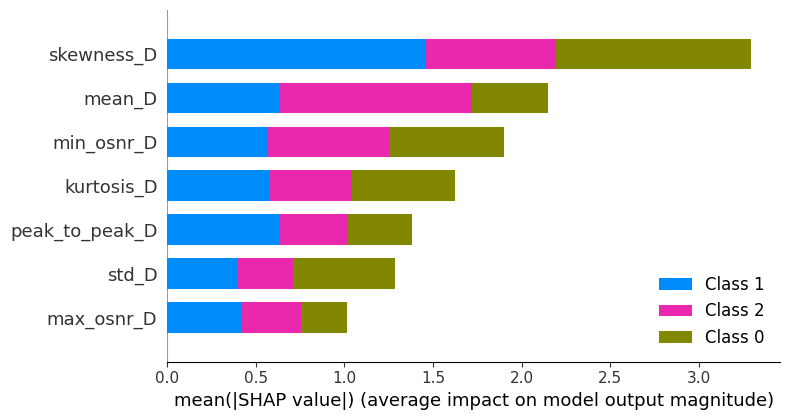

In [254]:
# Initialize the explainer
explainer = shap.TreeExplainer(best_model)

# Generate SHAP values for the test data
shap_values = explainer.shap_values(X_test_initial)

# Global summary plot
shap.summary_plot(shap_values, X_test_initial)

Link  1


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


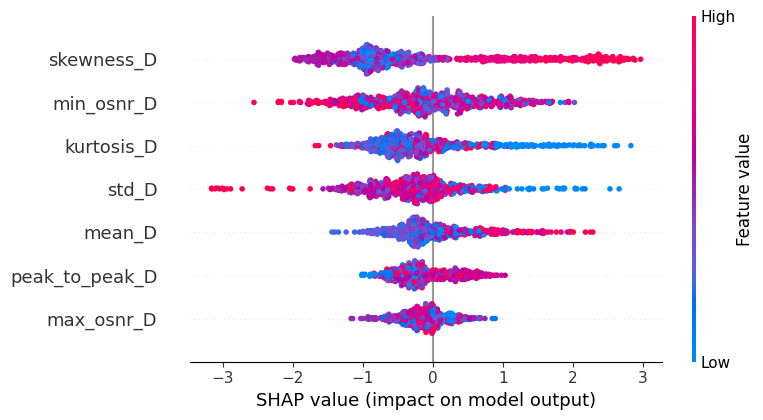

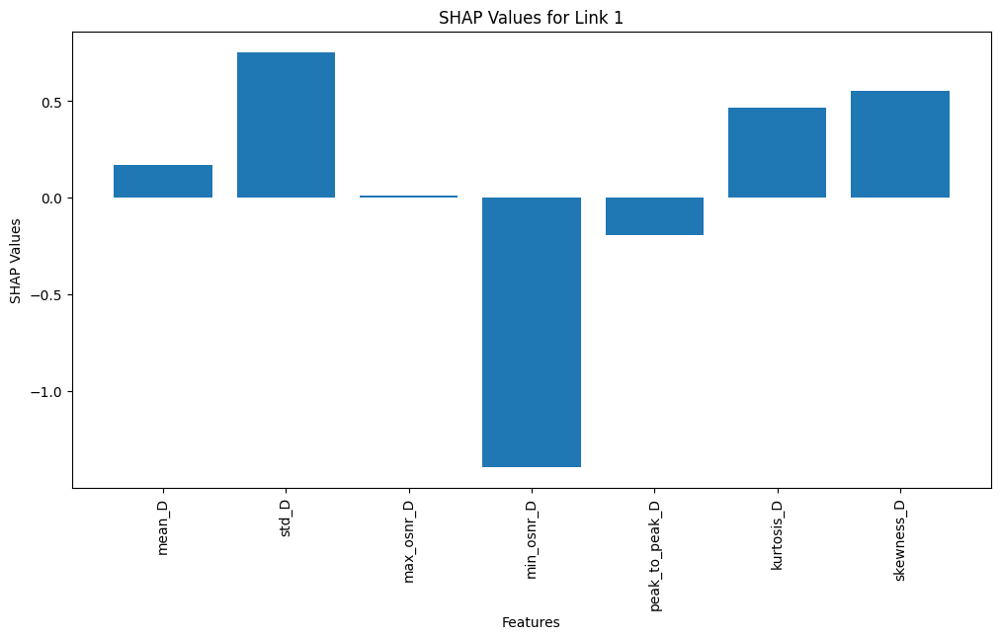

Link  2


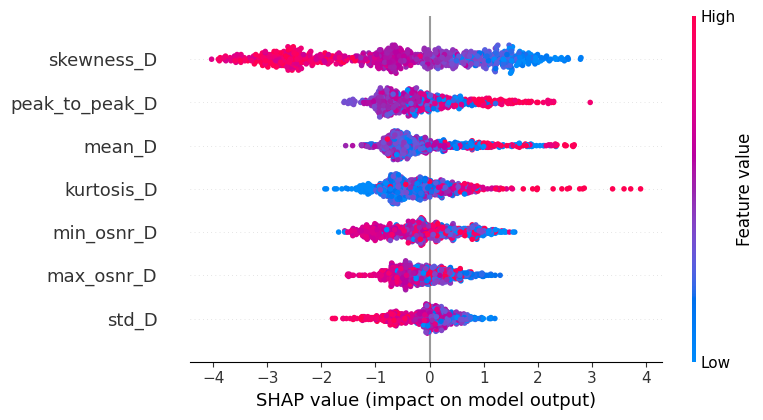

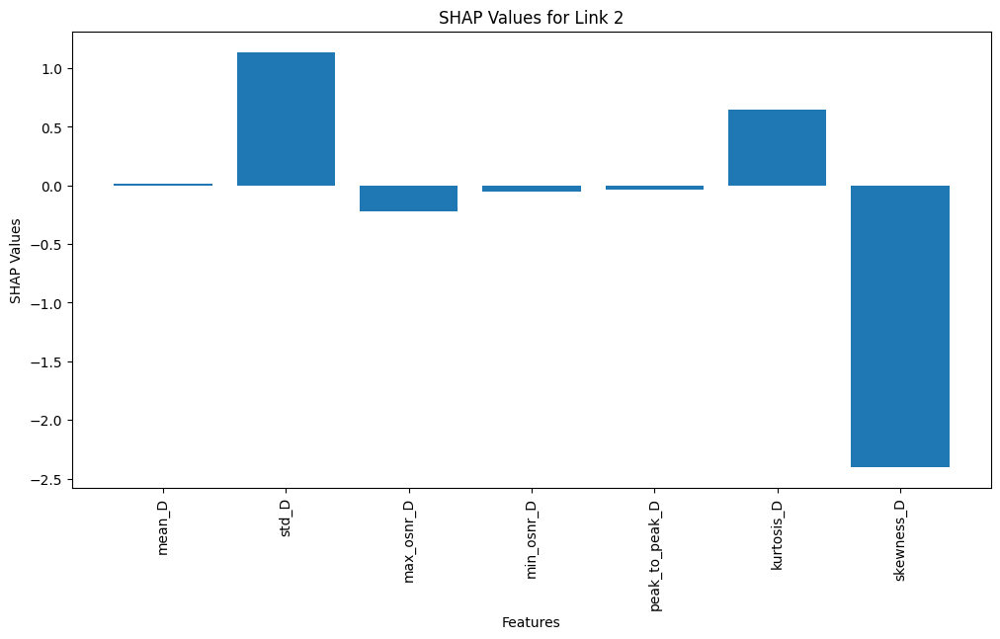

Link  3


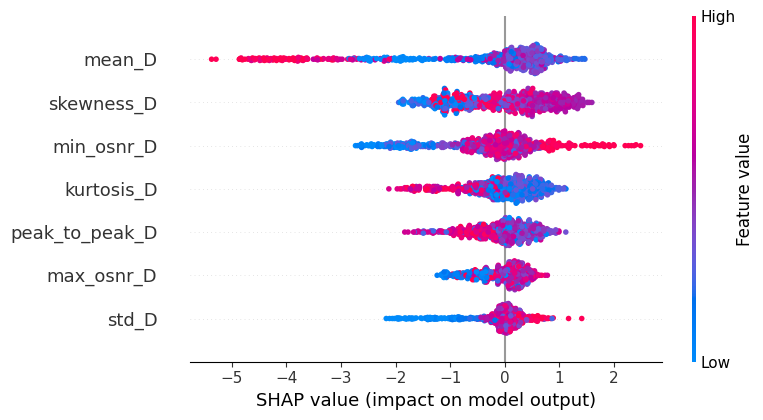

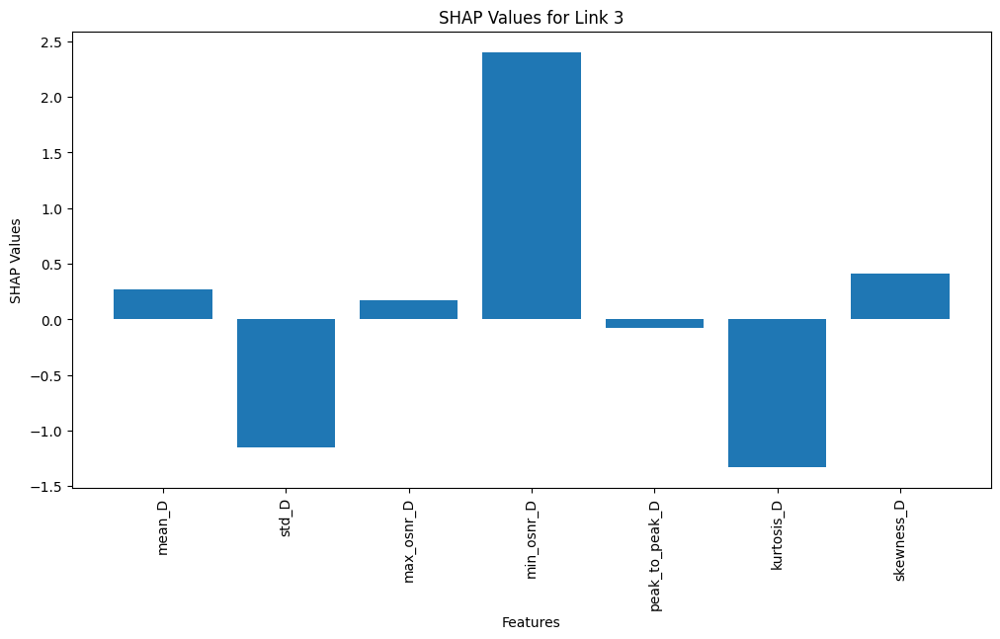

In [255]:
# Separate plots for each label
for label_idx in range(3):
    print("Link ", label_idx + 1)
    # Summary plot
    shap.summary_plot(shap_values[label_idx], X_test_initial, class_names=["1", "2", "3"], show=False)


    # Bar plot for a specific instance (e.g., instance at index 0)
    plt.figure(figsize=(12, 6))
    shap_values_label = shap_values[label_idx][0]
    plt.bar(range(len(shap_values_label)), shap_values_label)
    plt.xticks(range(len(shap_values_label)), X_test_initial.columns, rotation=90, ha='center')
    plt.xlabel("Features")
    plt.ylabel("SHAP Values")
    plt.title("SHAP Values for Link " + str(label_idx + 1))
    plt.show()

Link  1


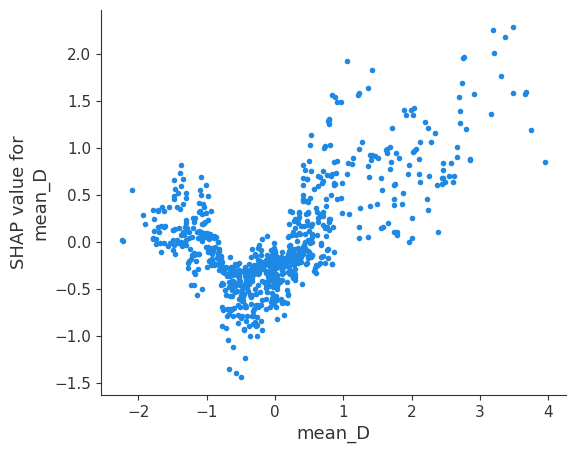

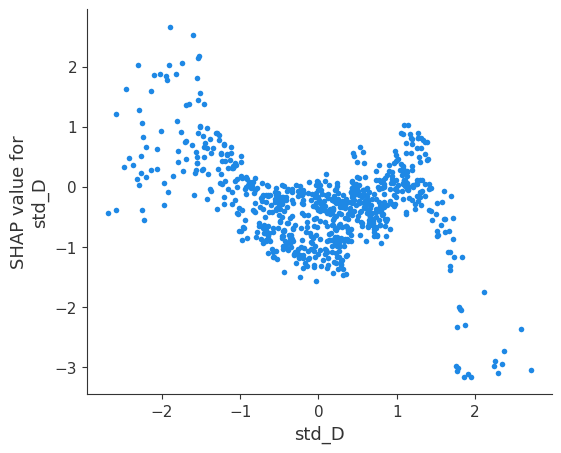

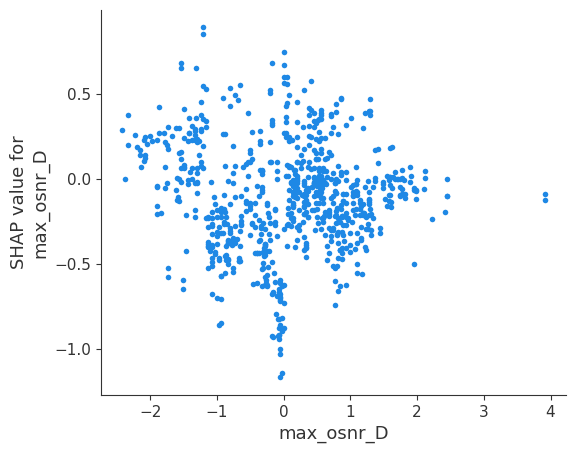

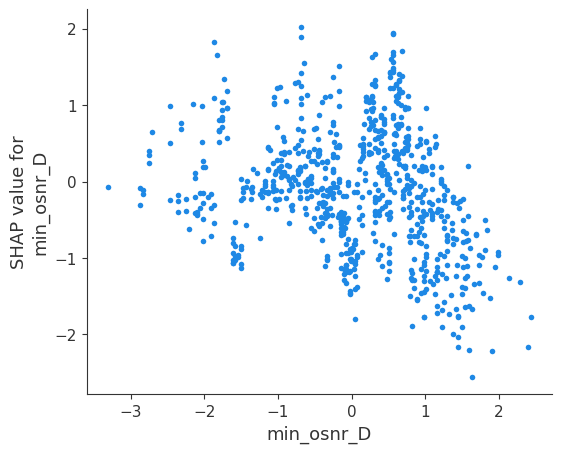

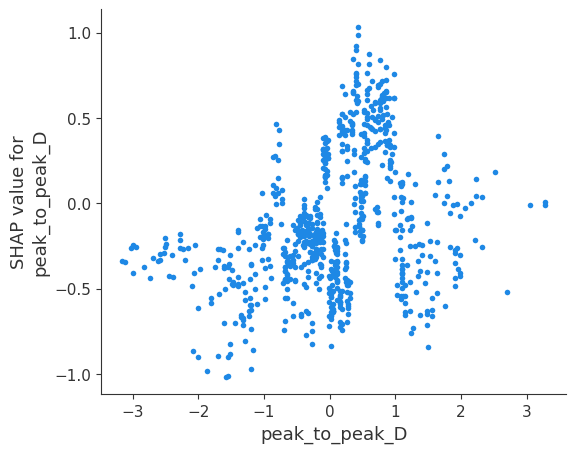

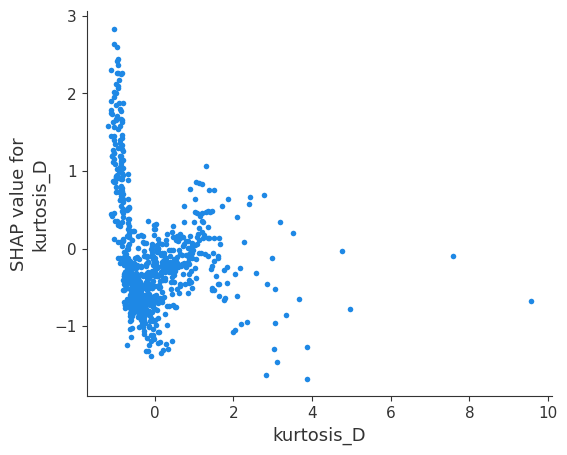

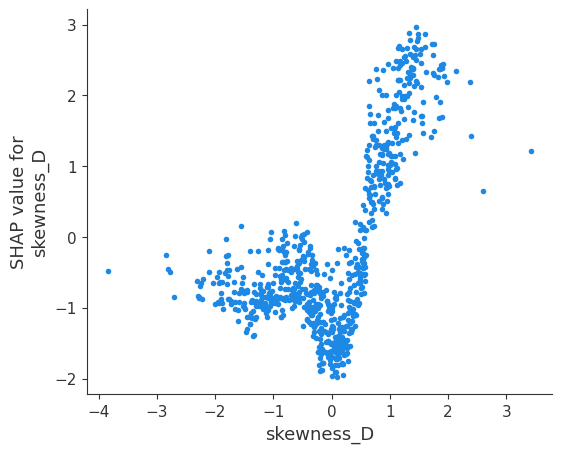

Link  2


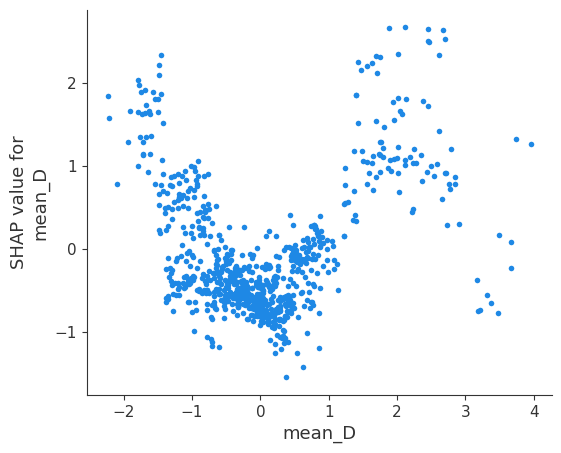

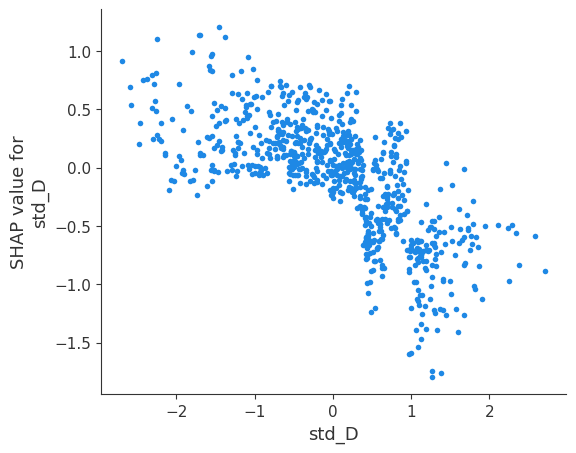

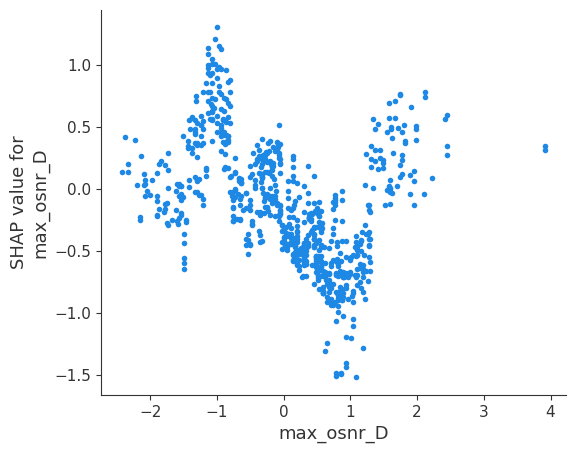

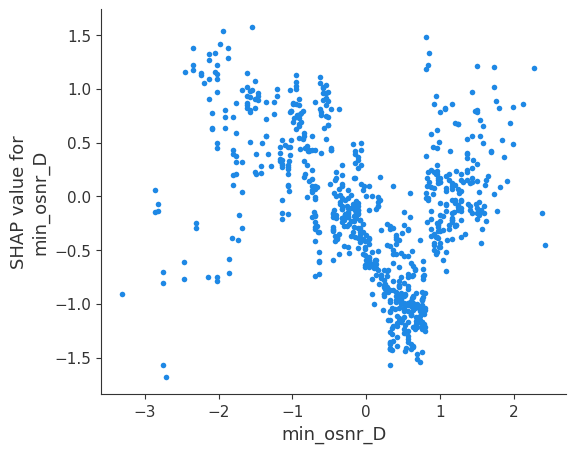

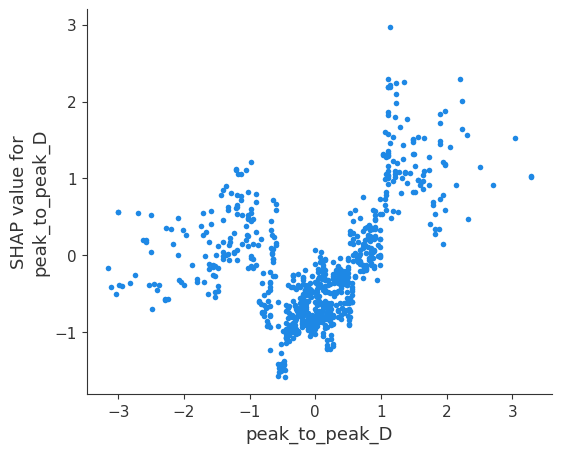

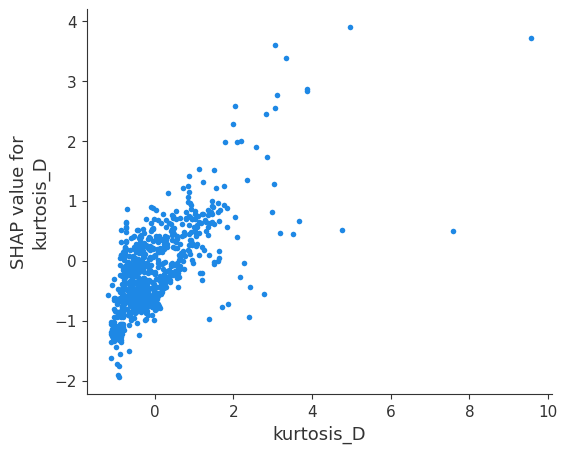

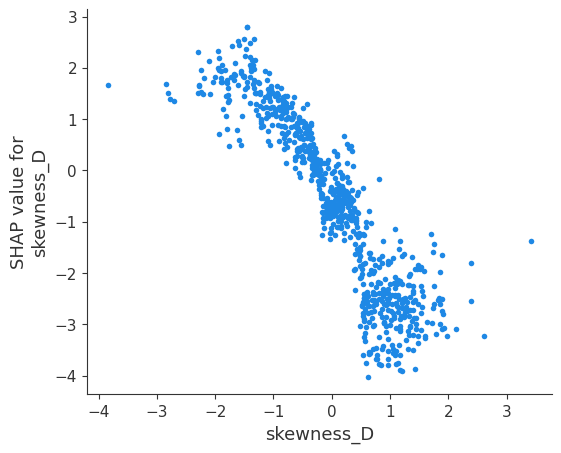

Link  3


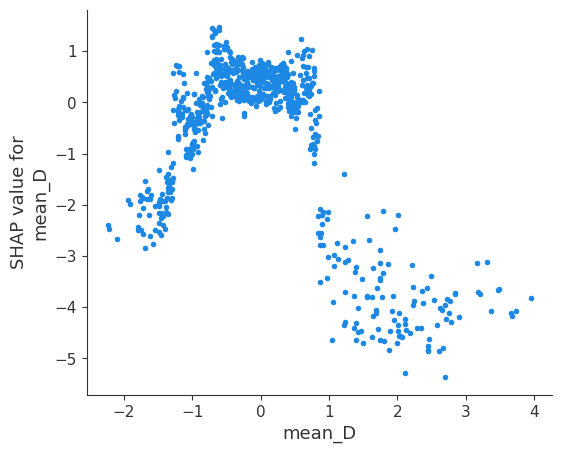

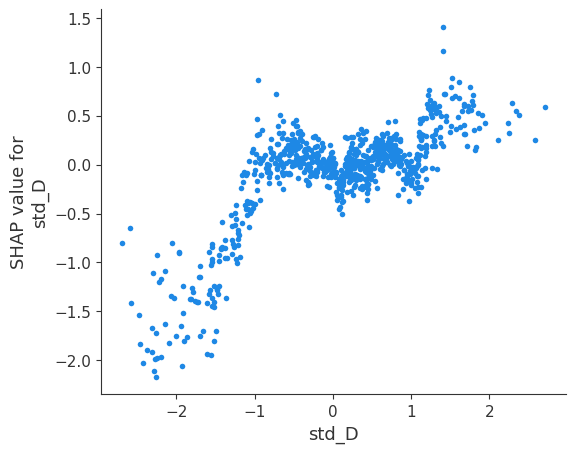

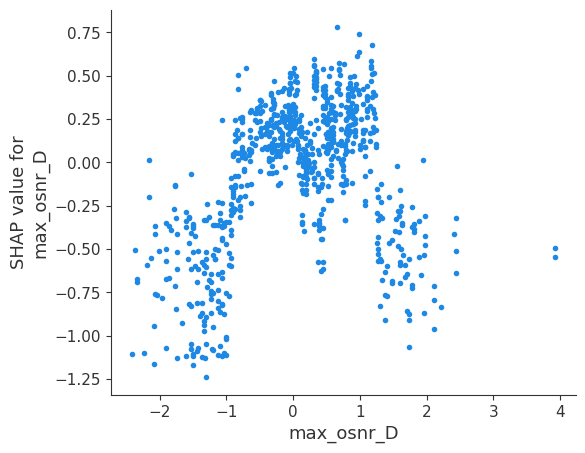

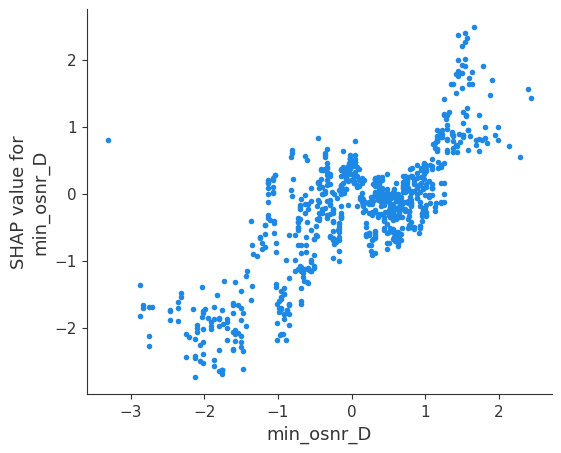

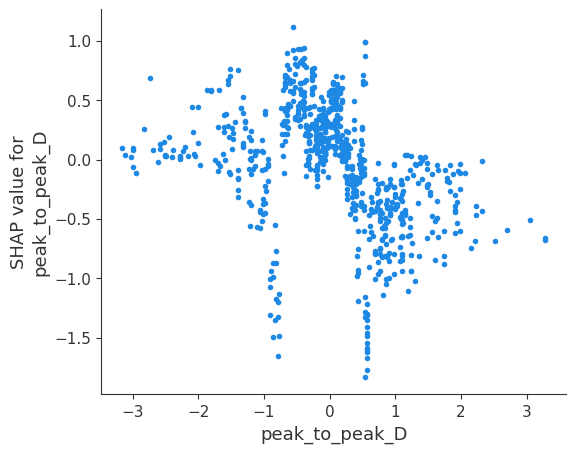

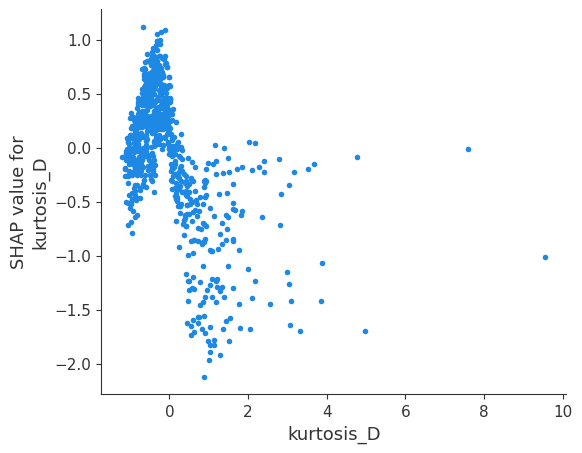

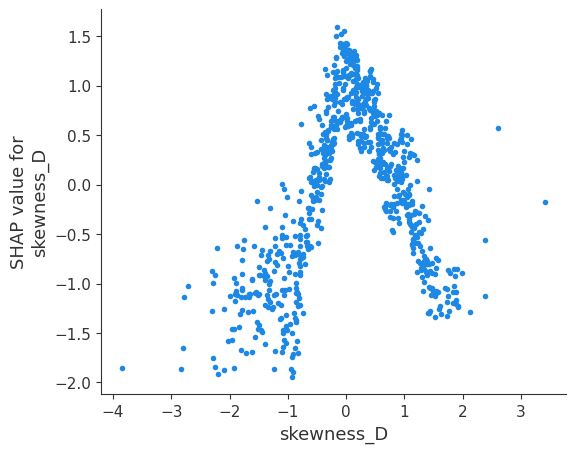

In [256]:
for label_idx in range(3):
  print("Link ", label_idx + 1)
  for feature_idx, feature_name in enumerate(X.columns):
    shap.dependence_plot(feature_idx, shap_values[label_idx], X_test_initial, interaction_index=None, feature_names=X_test_initial.columns)